In [13]:
import pandas as pd
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import csv
import os
import seaborn as sns
import sklearn

from datetime import datetime
from scipy.stats import pearsonr
from mpl_toolkits.axes_grid1 import make_axes_locatable
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.model_selection import train_test_split
from sklearn.metrics import precision_recall_curve, roc_curve

print("Pandas version: ", pd.__version__)
print("Numpy version: ", np.__version__)
print("Matplotlib.pyplot version: ", matplotlib.__version__)
print("Seaborn version: ", sns.__version__)
print("SciKitLearn version: ", sklearn.__version__)

Pandas version:  0.20.1
Numpy version:  1.12.1
Matplotlib.pyplot version:  2.0.2
Seaborn version:  0.7.1
SciKitLearn version:  0.21.2


In [20]:
#! pip3 install --upgrade pandas
! pip3 install --upgrade pip==18.1
#! pip3 install --upgrade matplotlib #threw an error 
#! pip3 install --upgrade seaborn #threw an error
#! pip3 install --upgrade sklearn

Traceback (most recent call last):
  File "/Users/melanievollmar/anaconda/bin/pip3", line 7, in <module>
    from pip._internal.cli.main import main
  File "/Users/melanievollmar/anaconda/lib/python3.6/site-packages/pip/_internal/cli/main.py", line 9, in <module>
    from pip._internal.cli.autocompletion import autocomplete
  File "/Users/melanievollmar/anaconda/lib/python3.6/site-packages/pip/_internal/cli/autocompletion.py", line 10, in <module>
    from pip._internal.cli.main_parser import create_main_parser
  File "/Users/melanievollmar/anaconda/lib/python3.6/site-packages/pip/_internal/cli/main_parser.py", line 8, in <module>
    from pip._internal.cli import cmdoptions
  File "/Users/melanievollmar/anaconda/lib/python3.6/site-packages/pip/_internal/cli/cmdoptions.py", line 30, in <module>
    from pip._internal.utils.hashes import STRONG_HASHES
  File "/Users/melanievollmar/anaconda/lib/python3.6/site-packages/pip/_internal/utils/hashes.py", line 2, in <module>
    from typing im

In [5]:
# Find the input data as CSV
run1_3dii_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_3dii_allData_allXtals_run1_BigEPruns.csv"
run2_3dii_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_3dii_allData_allXtals_run2_BigEPruns.csv"
run3_3dii_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_3dii_allData_allXtals_run3_BigEPruns.csv"
run4_3dii_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_3dii_allData_allXtals_run4_BigEPruns.csv"


run1_dials_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_dials_allData_allXtals_run1_BigEPruns.csv"
run2_dials_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_dials_allData_allXtals_run2_BigEPruns.csv"
run3_dials_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_dials_allData_allXtals_run3_BigEPruns.csv"
run4_dials_csv = "/Users/melanievollmar/Documents/METRICS/data_analysis_20210312/BigEP_samples/summary_table_dials_allData_allXtals_run4_BigEPruns.csv"


# Load the CSV data into a Pandas dataframe
run1_3dii_df = pd.read_csv(run1_3dii_csv)
run2_3dii_df = pd.read_csv(run2_3dii_csv)
run3_3dii_df = pd.read_csv(run3_3dii_csv)
run4_3dii_df = pd.read_csv(run4_3dii_csv)


run1_dials_df = pd.read_csv(run1_dials_csv)
run2_dials_df = pd.read_csv(run2_dials_csv)
run3_dials_df = pd.read_csv(run3_dials_csv)
run4_dials_df = pd.read_csv(run4_dials_csv)


df_3dii = pd.concat([run1_3dii_df, run2_3dii_df, run3_3dii_df, run4_3dii_df],
               ignore_index=True)
df_run234_3dii = pd.concat([run2_3dii_df, run3_3dii_df, run4_3dii_df],
               ignore_index=True)
#print(df_3dii.describe)

dials_df = pd.concat([run1_dials_df, run2_dials_df, run3_dials_df, run4_dials_df],
               ignore_index=True)
dials_run234_df = pd.concat([run2_dials_df, run3_dials_df, run4_dials_df],
               ignore_index=True)
#print(dials_df.describe)


full_3dii_df = df_3dii[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF',
       'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'failure', 'success', 'class',
       'ground_truth', 'no_images', 'autobuild_success', 'crank2_success',
       'autosharp_success']]

full_run1_3dii_df = run1_3dii_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF',
       'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'failure', 'success', 'class',
       'ground_truth', 'no_images', 'autobuild_success', 'crank2_success',
       'autosharp_success']]

full_run234_3dii_df = df_run234_3dii[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF',
       'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'failure', 'success', 'class',
       'ground_truth', 'no_images', 'autobuild_success', 'crank2_success',
       'autosharp_success']]

full_dials_df = dials_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF',
       'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'failure', 'success', 'class',
       'ground_truth', 'no_images', 'autobuild_success', 'crank2_success',
       'autosharp_success']]

full_run1_dials_df = run1_dials_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF',
       'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'failure', 'success', 'class',
       'ground_truth', 'no_images', 'autobuild_success', 'crank2_success',
       'autosharp_success']]

full_run234_dials_df = dials_run234_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF',
       'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'failure', 'success', 'class',
       'ground_truth', 'no_images', 'autobuild_success', 'crank2_success',
       'autosharp_success']]

# Expand the dataframe
full_3dii_df["res_frag_maxLength_AutoBuild"] = full_3dii_df["res_frag_AutoBuild"] * full_3dii_df["max_len_AutoBuild"]
full_3dii_df["res_frag_maxLength_Crank2"] = full_3dii_df["res_frag_Crank2"] * full_3dii_df["max_len_Crank2"]
full_3dii_df["res_frag_maxLength_autoSHARP"] = full_3dii_df["res_frag_autoSHARP"] * full_3dii_df["max_len_autoSHARP"]

full_run234_3dii_df["res_frag_maxLength_AutoBuild"] = full_run234_3dii_df["res_frag_AutoBuild"] * full_run234_3dii_df["max_len_AutoBuild"]
full_run234_3dii_df["res_frag_maxLength_Crank2"] = full_run234_3dii_df["res_frag_Crank2"] * full_run234_3dii_df["max_len_Crank2"]
full_run234_3dii_df["res_frag_maxLength_autoSHARP"] = full_run234_3dii_df["res_frag_autoSHARP"] * full_run234_3dii_df["max_len_autoSHARP"]

full_run1_3dii_df["res_frag_maxLength_AutoBuild"] = full_run1_3dii_df["res_frag_AutoBuild"] * full_run1_3dii_df["max_len_AutoBuild"]
full_run1_3dii_df["res_frag_maxLength_Crank2"] = full_run1_3dii_df["res_frag_Crank2"] * full_run1_3dii_df["max_len_Crank2"]
full_run1_3dii_df["res_frag_maxLength_autoSHARP"] = full_run1_3dii_df["res_frag_autoSHARP"] * full_run1_3dii_df["max_len_autoSHARP"]

full_dials_df["res_frag_maxLength_AutoBuild"] = full_dials_df["res_frag_AutoBuild"] * full_dials_df["max_len_AutoBuild"]
full_dials_df["res_frag_maxLength_Crank2"] = full_dials_df["res_frag_Crank2"] * full_dials_df["max_len_Crank2"]
full_dials_df["res_frag_maxLength_autoSHARP"] = full_dials_df["res_frag_autoSHARP"] * full_dials_df["max_len_autoSHARP"]

full_run1_dials_df["res_frag_maxLength_AutoBuild"] = full_run1_dials_df["res_frag_AutoBuild"] * full_run1_dials_df["max_len_AutoBuild"]
full_run1_dials_df["res_frag_maxLength_Crank2"] = full_run1_dials_df["res_frag_Crank2"] * full_run1_dials_df["max_len_Crank2"]
full_run1_dials_df["res_frag_maxLength_autoSHARP"] = full_run1_dials_df["res_frag_autoSHARP"] * full_run1_dials_df["max_len_autoSHARP"]

full_run234_dials_df["res_frag_maxLength_AutoBuild"] = full_run234_dials_df["res_frag_AutoBuild"] * full_run234_dials_df["max_len_AutoBuild"]
full_run234_dials_df["res_frag_maxLength_Crank2"] = full_run234_dials_df["res_frag_Crank2"] * full_run234_dials_df["max_len_Crank2"]
full_run234_dials_df["res_frag_maxLength_autoSHARP"] = full_run234_dials_df["res_frag_autoSHARP"] * full_run234_dials_df["max_len_autoSHARP"]


# sort dataframe
full_3dii_df = full_3dii_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope',
                             'diffF', 'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP',
                             'CC_dmin_AutoBuild', 'CC_dmin_Crank2', 'CC_dmin_autoSHARP',
                             'no_frag_AutoBuild', 'no_frag_Crank2', 'no_frag_autoSHARP',
                             'max_len_AutoBuild', 'max_len_Crank2', 'max_len_autoSHARP',
                             'total_res_AutoBuild', 'total_res_Crank2',
                             'total_res_autoSHARP', 'res_frag_AutoBuild',
                             'res_frag_Crank2', 'res_frag_autoSHARP',
                             'res_frag_maxLength_AutoBuild', 'res_frag_maxLength_Crank2',
                             'res_frag_maxLength_autoSHARP', 'failure', 'success',
                             'class', 'ground_truth', 'no_images', 'autobuild_success',
                             'crank2_success', 'autosharp_success']]

full_run234_3dii_df = full_run234_3dii_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope',
                             'diffF', 'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP',
                             'CC_dmin_AutoBuild', 'CC_dmin_Crank2', 'CC_dmin_autoSHARP',
                             'no_frag_AutoBuild', 'no_frag_Crank2', 'no_frag_autoSHARP',
                             'max_len_AutoBuild', 'max_len_Crank2', 'max_len_autoSHARP',
                             'total_res_AutoBuild', 'total_res_Crank2',
                             'total_res_autoSHARP', 'res_frag_AutoBuild',
                             'res_frag_Crank2', 'res_frag_autoSHARP',
                             'res_frag_maxLength_AutoBuild', 'res_frag_maxLength_Crank2',
                             'res_frag_maxLength_autoSHARP', 'failure', 'success',
                             'class', 'ground_truth', 'no_images', 'autobuild_success',
                             'crank2_success', 'autosharp_success']]

full_run1_3dii_df = full_run1_3dii_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope',
                             'diffF', 'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP',
                             'CC_dmin_AutoBuild', 'CC_dmin_Crank2', 'CC_dmin_autoSHARP',
                             'no_frag_AutoBuild', 'no_frag_Crank2', 'no_frag_autoSHARP',
                             'max_len_AutoBuild', 'max_len_Crank2', 'max_len_autoSHARP',
                             'total_res_AutoBuild', 'total_res_Crank2',
                             'total_res_autoSHARP', 'res_frag_AutoBuild',
                             'res_frag_Crank2', 'res_frag_autoSHARP',
                             'res_frag_maxLength_AutoBuild', 'res_frag_maxLength_Crank2',
                             'res_frag_maxLength_autoSHARP', 'failure', 'success',
                             'class', 'ground_truth', 'no_images', 'autobuild_success',
                             'crank2_success', 'autosharp_success']]

full_dials_df = full_dials_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope',
                               'diffF', 'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP',
                               'CC_dmin_AutoBuild', 'CC_dmin_Crank2', 'CC_dmin_autoSHARP',
                               'no_frag_AutoBuild', 'no_frag_Crank2', 'no_frag_autoSHARP',
                               'max_len_AutoBuild', 'max_len_Crank2', 'max_len_autoSHARP',
                               'total_res_AutoBuild', 'total_res_Crank2',
                               'total_res_autoSHARP', 'res_frag_AutoBuild',
                               'res_frag_Crank2', 'res_frag_autoSHARP',
                               'res_frag_maxLength_AutoBuild', 'res_frag_maxLength_Crank2',
                               'res_frag_maxLength_autoSHARP', 'failure', 'success',
                               'class', 'ground_truth', 'no_images', 'autobuild_success',
                               'crank2_success', 'autosharp_success']]


full_run234_dials_df = full_run234_dials_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope',
                               'diffF', 'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP',
                               'CC_dmin_AutoBuild', 'CC_dmin_Crank2', 'CC_dmin_autoSHARP',
                               'no_frag_AutoBuild', 'no_frag_Crank2', 'no_frag_autoSHARP',
                               'max_len_AutoBuild', 'max_len_Crank2', 'max_len_autoSHARP',
                               'total_res_AutoBuild', 'total_res_Crank2',
                               'total_res_autoSHARP', 'res_frag_AutoBuild',
                               'res_frag_Crank2', 'res_frag_autoSHARP',
                               'res_frag_maxLength_AutoBuild', 'res_frag_maxLength_Crank2',
                               'res_frag_maxLength_autoSHARP', 'failure', 'success',
                               'class', 'ground_truth', 'no_images', 'autobuild_success',
                               'crank2_success', 'autosharp_success']]

full_run1_dials_df = full_run1_dials_df[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope',
                               'diffF', 'diffI', 'f', 'AutoBuild', 'Crank2', 'autoSHARP',
                               'CC_dmin_AutoBuild', 'CC_dmin_Crank2', 'CC_dmin_autoSHARP',
                               'no_frag_AutoBuild', 'no_frag_Crank2', 'no_frag_autoSHARP',
                               'max_len_AutoBuild', 'max_len_Crank2', 'max_len_autoSHARP',
                               'total_res_AutoBuild', 'total_res_Crank2',
                               'total_res_autoSHARP', 'res_frag_AutoBuild',
                               'res_frag_Crank2', 'res_frag_autoSHARP',
                               'res_frag_maxLength_AutoBuild', 'res_frag_maxLength_Crank2',
                               'res_frag_maxLength_autoSHARP', 'failure', 'success',
                               'class', 'ground_truth', 'no_images', 'autobuild_success',
                               'crank2_success', 'autosharp_success']]


# Print the column labels of the un-edited dataframe
column_names_3dii = full_3dii_df.columns
column_names_dials = full_dials_df.columns
#print("******** Column labels ********")
#print(column_names)

# Print summary stats for the whole dataframe before editing
summary_stats_3dii = full_3dii_df.describe()
summary_stats_dials = full_dials_df.describe()
#print("******** Summary stats for whole table ********")
#print(summary_stats)




################################################################################
##################################### 3dii #####################################
################################################################################
###################### Predictions for full data run1 to 4 #####################
################################################################################
Total number of samples:  1108
True-positive samples:  289
True-negative samples:  277
False-positive samples:  401
False-negative samples:  141
All positive samples:  430
All negative samples:  678
Classification accuracy:  51.08
Classification error:  48.92
Sensitivity:  67.21
Specificity:  40.86
False-positive rate:  59.14
Precision:  41.88
F1 score:  51.61


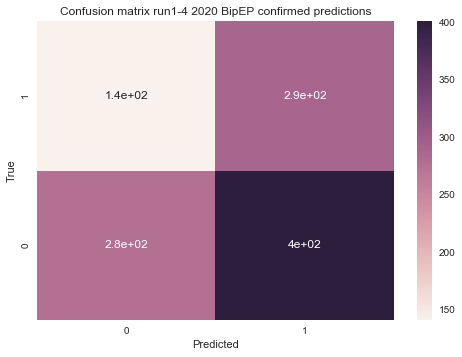

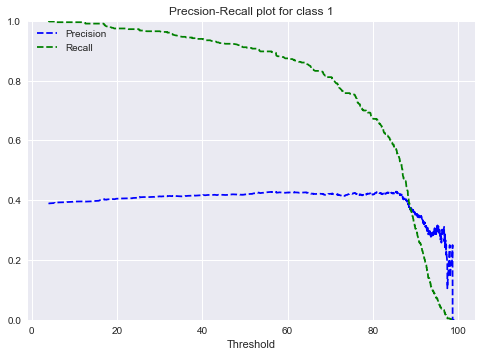

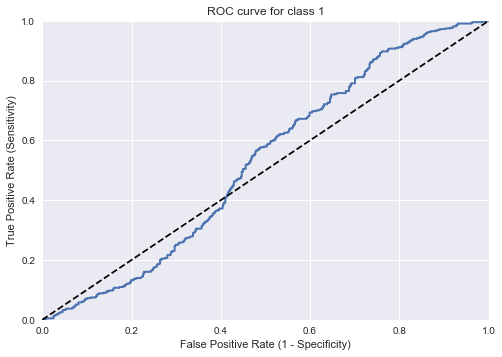

################################################################################
######################## Predictions for data run1 only ########################
################################################################################
Total number of samples:  121
True-positive samples:  5
True-negative samples:  23
False-positive samples:  71
False-negative samples:  22
All positive samples:  27
All negative samples:  94
Classification accuracy:  23.14
Classification error:  76.86
Sensitivity:  18.52
Specificity:  24.47
False-positive rate:  75.53
Precision:  6.58
F1 score:  9.71


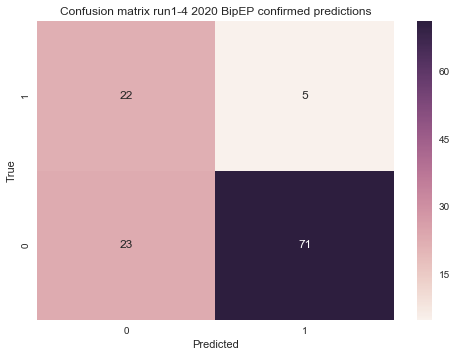

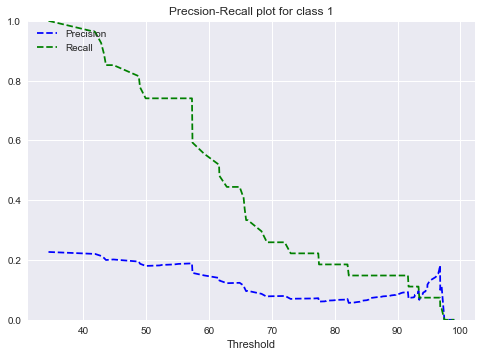

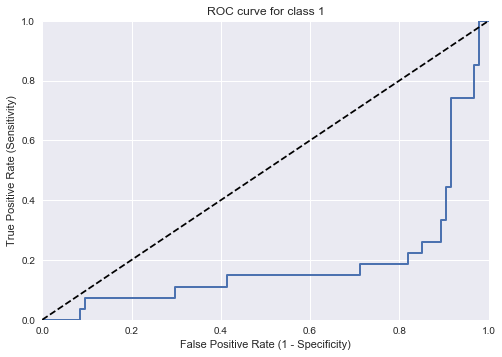

################################################################################
######################## Predictions for data run2 to 4 ########################
################################################################################
Total number of samples:  987
True-positive samples:  284
True-negative samples:  254
False-positive samples:  330
False-negative samples:  119
All positive samples:  403
All negative samples:  584
Classification accuracy:  54.51
Classification error:  45.49
Sensitivity:  70.47
Specificity:  43.49
False-positive rate:  56.51
Precision:  46.25
F1 score:  55.85


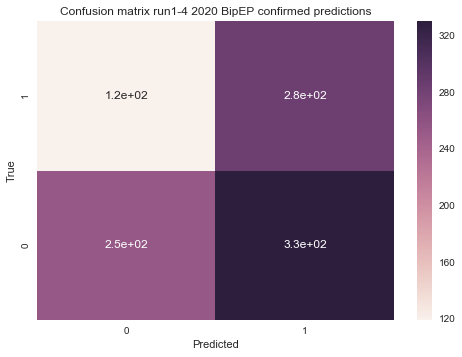

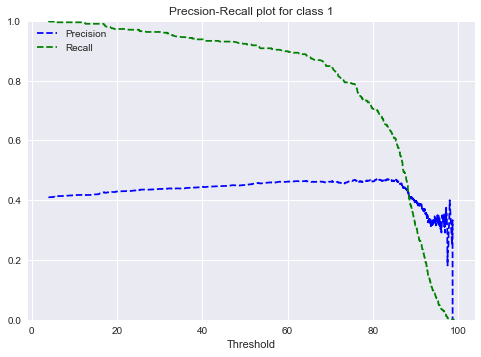

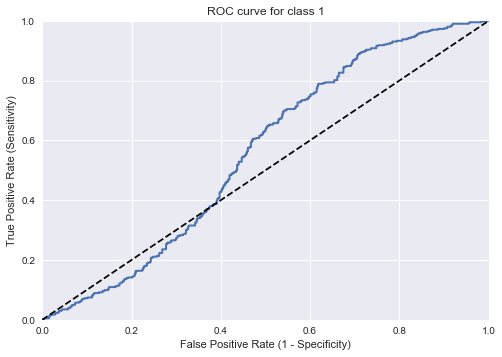

################################################################################
#################################### DIALS #####################################
################################################################################
###################### Predictions for full data run1 to 4 #####################
################################################################################
Total number of samples:  668
True-positive samples:  19
True-negative samples:  350
False-positive samples:  80
False-negative samples:  219
All positive samples:  238
All negative samples:  430
Classification accuracy:  55.24
Classification error:  44.76
Sensitivity:  7.98
Specificity:  81.40
False-positive rate:  18.60
Precision:  19.19
F1 score:  11.28


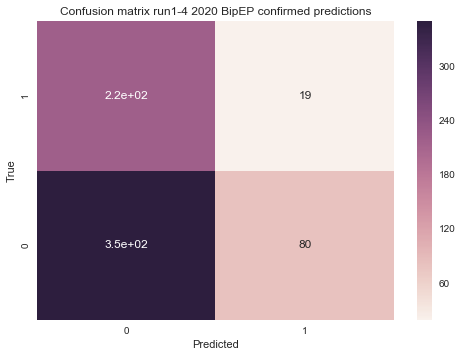

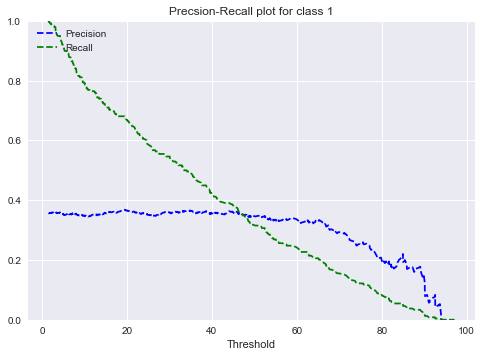

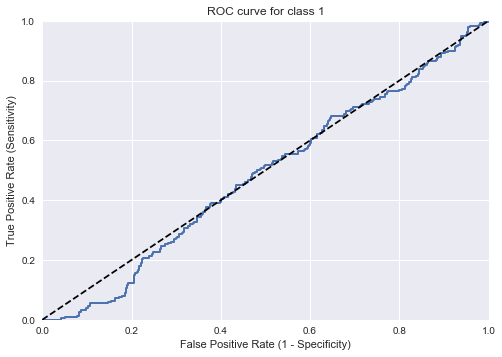

################################################################################
######################## Predictions for data run1 only ########################
################################################################################
Total number of samples:  104
True-positive samples:  0
True-negative samples:  25
False-positive samples:  58
False-negative samples:  21
All positive samples:  21
All negative samples:  83
Classification accuracy:  24.04
Classification error:  75.96
Sensitivity:  0.00
Specificity:  30.12
False-positive rate:  69.88
Precision:  0.00
F1 score:  0.00


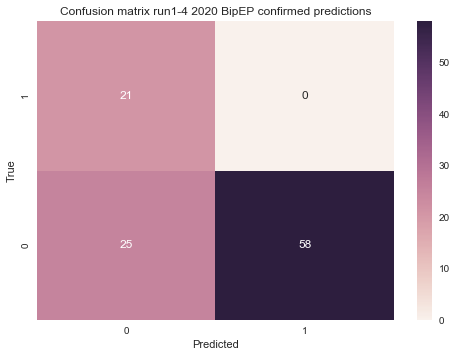

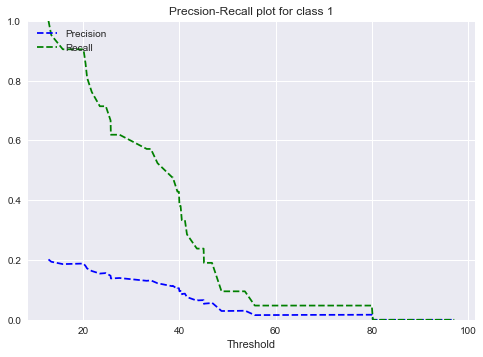

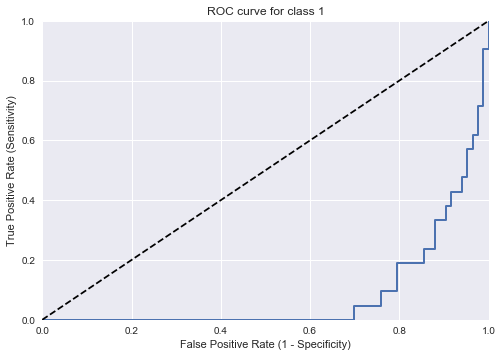

################################################################################
######################## Predictions for data run2 to 4 ########################
################################################################################
Total number of samples:  564
True-positive samples:  19
True-negative samples:  325
False-positive samples:  22
False-negative samples:  198
All positive samples:  217
All negative samples:  347
Classification accuracy:  60.99
Classification error:  39.01
Sensitivity:  8.76
Specificity:  93.66
False-positive rate:  6.34
Precision:  46.34
F1 score:  14.73


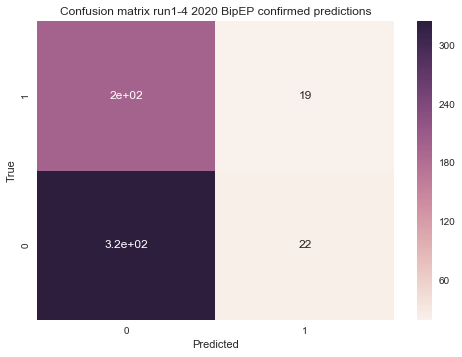

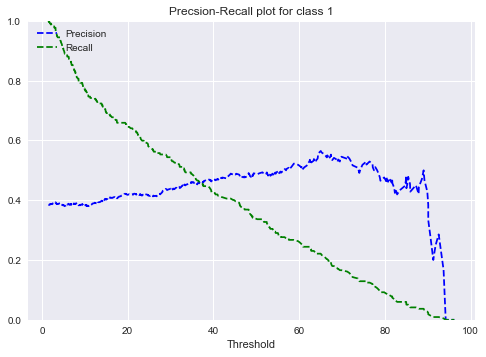

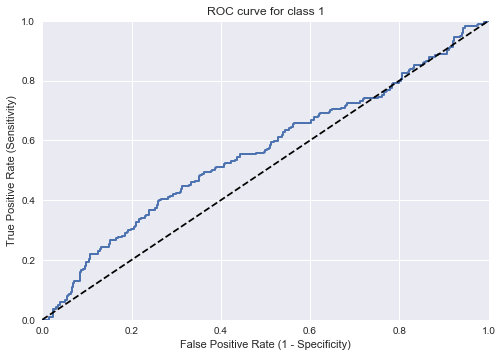

In [7]:
# get the details for the predictor performance for run1-4 2020 in various
# combinations and analysis; remember that run1 uses a different predictor

def get_prediction_performance(df):
    total = len(df)
    TP = len(df[(df['class'] == 1) & (df['ground_truth'] == 1)])
    TN = len(df[(df['class'] == 0) & (df['ground_truth'] == 0)])
    FP = len(df[(df['class'] == 1) & (df['ground_truth'] == 0)])
    FN = len(df[(df['class'] == 0) & (df['ground_truth'] == 1)])
    
    P = TP + FN
    N = TN + FP
    
    assert total == TP + TN + FP + FN
    assert total == P + N
    
    print("Total number of samples: ", total)
    print("True-positive samples: ", TP)
    print("True-negative samples: ", TN)
    print("False-positive samples: ", FP)
    print("False-negative samples: ", FN)
    print("All positive samples: ", P)
    print("All negative samples: ", N)
    
    #calculate accuracy
    acc_score_man_test = (TP + TN) / float(TP + TN + FP + FN)
    print("Classification accuracy: ", "%.2f" %(acc_score_man_test * 100)) 
    #classification error
    class_err_man_test = (FP + FN) / float(TP + TN + FP + FN)
    print("Classification error: ", "%.2f" %(class_err_man_test * 100))
    #sensitivity/recall/true positive rate; correctly placed positive cases  
    sensitivity_man_test = TP / float(FN + TP)
    print("Sensitivity: ", "%.2f" %(sensitivity_man_test * 100))
    #specificity  
    specificity_man_test = TN / (TN + FP)
    print("Specificity: ", "%.2f" %(specificity_man_test * 100))
    #false positive rate  
    false_positive_rate_man_test = FP / float(TN + FP)
    print("False-positive rate: ", "%.2f" %(false_positive_rate_man_test * 100))
    #precision/confidence of placement  
    precision_man_test = TP / float(TP + FP)
    print("Precision: ", "%.2f" %(precision_man_test * 100))
    #F1 score
    f1_score = TP / (TP + ((FN + FP) / 2))
    print("F1 score: ", "%.2f" %(f1_score * 100))

    matrix = [[FN, TP],
              [TN, FP]]
    
    # plot the confusion matrix for TP, TN, FP, FN
    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    labels = ['0', '1']      
    ax = plt.subplot()
    sns.heatmap(matrix, annot=True, ax=ax)
    plt.title('Confusion matrix run1-4 2020 BipEP confirmed predictions')
    ax.set_xticklabels(labels)
    ax.set_yticklabels(labels)
    plt.xlabel('Predicted')
    plt.ylabel('True')
#    plt.savefig(os.path.join(directory,
#                'confusion_matrix_tree_rand_ada_'+datestring+'.png'))
    plt.show()
    plt.close()

    # get precision, recall and threshold using precision-recall curve function
    # from sklearn to plot the curve
    precisions, recalls, thresholds = precision_recall_curve(df['ground_truth'],
                                                             df['success'])    


    # plot precision-recall curve manually
    plt.plot(thresholds, precisions[:-1], "b--", label="Precision")
    plt.plot(thresholds, recalls[:-1], "g--", label="Recall")
    plt.title('Precsion-Recall plot for class 1')
    plt.xlabel("Threshold")
    plt.legend(loc="upper left")
    plt.ylim([0,1])
#    plt.savefig(os.path.join(directory,
#               'Precision_Recall_tree_rand_ada_'+datestring+classes+'.png'))
    plt.show()
    plt.close()
    
    
    # get false-positive rate, true-positive rate and thresholds to plot a ROC curve
    # using roc_curve function from sklearn
    fpr, tpr, thresholds = roc_curve(df['ground_truth'], df['success'])
    
    # plot ROC curve manually
    plt.plot(fpr, tpr, linewidth=2)
    plt.plot([0, 1], [0, 1], 'k--')
    plt.axis([0, 1, 0, 1])
    plt.title('ROC curve for class 1') 
    plt.xlabel('False Positive Rate (1 - Specificity)')
    plt.ylabel('True Positive Rate (Sensitivity)')
    plt.grid(True)
#    plt.savefig(os.path.join(directory,
#                      'ROC_curve_tree_rand_ada_'+datestring+classes+'.png'))
    plt.show()
    plt.close()

    
print(80 * "#")
print(37 * "#" + " 3dii " + 37 * "#")
print(80 * "#")
print(22 * "#" + " Predictions for full data run1 to 4 " + 21 * "#")
print(80 * "#")    
get_prediction_performance(full_3dii_df)    
print(80 * "#")
print(24 * "#" + " Predictions for data run1 only " + 24 * "#")
print(80 * "#")    
get_prediction_performance(full_run1_3dii_df)
print(80 * "#")
print(24 * "#" + " Predictions for data run2 to 4 " + 24 * "#")
print(80 * "#")    
get_prediction_performance(full_run234_3dii_df)


print(80 * "#")
print(36 * "#" + " DIALS " + 37 * "#")
print(80 * "#")
print(22 * "#" + " Predictions for full data run1 to 4 " + 21 * "#")
print(80 * "#")    
get_prediction_performance(full_dials_df)    
print(80 * "#")
print(24 * "#" + " Predictions for data run1 only " + 24 * "#")
print(80 * "#")    
get_prediction_performance(full_run1_dials_df)
print(80 * "#")
print(24 * "#" + " Predictions for data run2 to 4 " + 24 * "#")
print(80 * "#")    
get_prediction_performance(full_run234_dials_df)


    


################################################################################
########################## Class labels for 3dii data ##########################
################################################################################
Total samples autobuild:  1108
Samples of class1 autobuild:  401
Samples of class0 autobuild:  707
Total sample crank2:  1108
Samples of class1 crank2:  377
Samples of class0 crank2:  731
Total sample autosharp:  1108
Samples of class1 autosharp:  284
Samples of class0 autosharp:  824
################################################################################
######################### Class labels for DIALS data ##########################
################################################################################
Total samples autobuild:  667
Samples of class1 autobuild:  209
Samples of class0 autobuild:  458
Total sample crank2:  667
Samples of class1 crank2:  182
Samples of class0 crank2:  485
Total sample autosharp:  667
Samples of cl

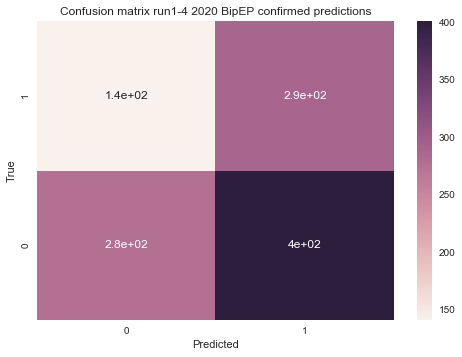

################################################################################
#################################### DIALS #####################################
################################################################################
Total number of samples:  667
True-positive samples:  19
True-negative samples:  350
False-positive samples:  80
False-negative samples:  218
All positive samples:  237
All negative samples:  430
Classification accuracy:  55.32
Classification error:  44.68
Sensitivity:  8.02
Specificity:  81.40
False-positive rate:  18.60
Precision:  19.19


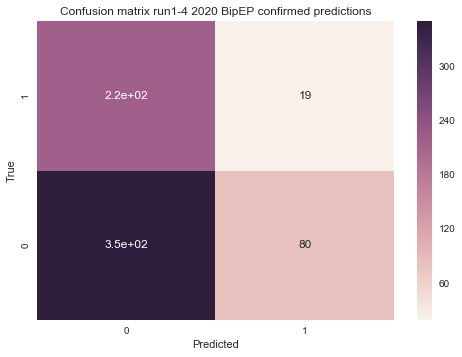

In [102]:
# counting the samples for the different classification outcomes and labels;
# the problem is multiclass multilabel, i.e. different classes can have the same label
# here: one or more experimental phasing program can produce a result of the same outcome
#       for the same data

# do individual phasing programms first

def count_class_label(df):
    autobuild_total = len(df['autobuild_success'])
    print("Total samples autobuild: ", autobuild_total)
    autobuild_class1 = len(df[(df['autobuild_success']>0)])
    print("Samples of class1 autobuild: ", autobuild_class1)
    autobuild_class0 = autobuild_total - autobuild_class1
    print("Samples of class0 autobuild: ", autobuild_class0)
    
    crank2_total = len(df['crank2_success'])
    print("Total sample crank2: ", crank2_total)
    crank2_class1 = len(df[(df['crank2_success']>0)])
    print("Samples of class1 crank2: ", crank2_class1)
    crank2_class0 = crank2_total - crank2_class1
    print("Samples of class0 crank2: ", crank2_class0)
    
    autosharp_total = len(df['autosharp_success'])
    print("Total sample autosharp: ", autosharp_total)
    autosharp_class1 = len(df[(df['autosharp_success']>0)])
    print("Samples of class1 autosharp: ", autosharp_class1)
    autosharp_class0 = autosharp_total - autosharp_class1
    print("Samples of class0 autosharp: ", autosharp_class0)

print(80 * "#")
print(26 * "#" + " Class labels for 3dii data " + 26 * "#")
print(80 * "#")    
count_class_label(full_3dii_df)

print(80 * "#")
print(25 * "#" + " Class labels for DIALS data " + 26 * "#")
print(80 * "#")
count_class_label(full_dials_df)


def count_multi_labels(df):
    print(80 * "#")
    print(31 * "#" + " Tripple positive " + 31 * "#")
    print(80 * "#")    
    tripple_pos = len(df[(df['autobuild_success']>0) & (df['crank2_success']>0) & (df['autosharp_success']>0)])
    print("autobuild/crank2/autosharp: ", tripple_pos)
    
    print(80 * "#")
    print(31 * "#" + " Double positive " + 32 * "#")
    print(80 * "#")    
    autobuild_crank2 = len(df[(df['autobuild_success']>0) & (df['crank2_success']>0)])
    autobuild_autosharp = len(df[(df['autobuild_success']>0) & (df['autosharp_success']>0)])
    autosharp_crank2 = len(df[(df['crank2_success']>0) & (df['autosharp_success']>0)])
    print("autobuild/crank2: ", autobuild_crank2)
    print("autobuild/autosharp: ", autobuild_autosharp)
    print("crank2/autosharp: ", autosharp_crank2)

    print(80 * "#")
    print(31 * "#" + " Single positive " + 32 * "#")
    print(80 * "#") 
    autobuild = len(df[(df['autobuild_success']>0) & (df['crank2_success']==0) & (df['autosharp_success']==0)])
    crank2 = len(df[(df['autobuild_success']==0) & (df['crank2_success']>0) & (df['autosharp_success']==0)])
    autosharp = len(df[(df['autobuild_success']==0) & (df['crank2_success']==0) & (df['autosharp_success']>0)])
    print("autobuild: ", autobuild)
    print("crank2: ", crank2)
    print("autosharp: ", autosharp)
    
print(80 * "#")
print(37 * "#" + " 3dii " + 37 * "#")
print(80 * "#")
count_multi_labels(full_3dii_df)
print(80 * "#")
print(36 * "#" + " DIALS " + 37 * "#")
print(80 * "#")
count_multi_labels(full_dials_df)
    



In [88]:
# train-test-split
# this should be done stratified for multi-class multi-lable; the only
# support I found is in http://scikit.ml which is no longer maintained
# (as of 2018); I stick to normal train-test-split for now, also considering
# that in on ecase I have only one sample available; use the standard
# sklearn function and apply stratification

# train-test-split for 3dii
y_3dii = full_3dii_df[['autobuild_success', 'crank2_success', 'autosharp_success']]
X_3dii = full_3dii_df.iloc[:, :-4]

X_3dii_train, X_3dii_test, y_3dii_train, y_3dii_test = train_test_split(X_3dii, y_3dii,
                                                                        test_size=0.2,
                                                                        random_state=42,
                                                                        stratify=y_3dii)
print("Training X shape: ", X_3dii_train.shape)
print("Testing X shape: ", X_3dii_test.shape)
print("Training y shape: ", y_3dii_train.shape)
print("Training y shape: ", y_3dii_test.shape)



# train-test-split for DIALS
# needed to drop the sample for which there is only one occurance in order
# to have train-test-split run
full_dials_df = full_dials_df.drop(full_dials_df[(full_dials_df['autobuild_success']==0) &
                                                 (full_dials_df['crank2_success']==0) &
                                                 (full_dials_df['autosharp_success']>0)].index)

y_dials = full_dials_df[['autobuild_success', 'crank2_success', 'autosharp_success']]
X_dials = full_dials_df.iloc[:, :-4]

X_dials_train, X_dials_test, y_dials_train, y_dials_test = train_test_split(X_dials, y_dials,
                                                                        test_size=0.2,
                                                                        random_state=42,
                                                                        stratify=y_dials)
print("Training X shape: ", X_dials_train.shape)
print("Testing X shape: ", X_dials_test.shape)
print("Training y shape: ", y_dials_train.shape)
print("Training y shape: ", y_dials_test.shape)

    


Training X shape:  (886, 32)
Testing X shape:  (222, 32)
Training y shape:  (886, 3)
Training y shape:  (222, 3)
Training X shape:  (533, 32)
Testing X shape:  (134, 32)
Training y shape:  (533, 3)
Training y shape:  (134, 3)


In [89]:
# Standardising the data after splitting to avoid data leakage into the test set


sc_3dii = StandardScaler()
X_3dii_train_std = sc_3dii.fit_transform(X_3dii_train.iloc[:, 1:])
X_3dii_test_std = sc_3dii.transform (X_3dii_test.iloc[:, 1:])

X_3dii_train_std = pd.DataFrame(X_3dii_train_std,
                                columns=X_3dii_train.columns[1:],
                                index=X_3dii_train.index)

X_3dii_train_std["filepath"] = X_3dii_train["filepath"]
X_3dii_train_std = X_3dii_train_std[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF', 'diffI', 'f',
       'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'res_frag_maxLength_AutoBuild',
       'res_frag_maxLength_Crank2', 'res_frag_maxLength_autoSHARP', 'failure',
       'success', 'class', 'ground_truth']]




sc_dials = StandardScaler()
X_dials_train_std = sc_dials.fit_transform(X_dials_train.iloc[:, 1:])
X_dials_test_std = sc_dials.transform (X_dials_test.iloc[:, 1:])

X_dials_train_std = pd.DataFrame(X_dials_train_std,
                                columns=X_dials_train.columns[1:],
                                index=X_dials_train.index)

X_dials_train_std["filepath"] = X_dials_train["filepath"]
X_dials_train_std = X_dials_train_std[['filepath', 'anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF', 'diffI', 'f',
       'AutoBuild', 'Crank2', 'autoSHARP', 'CC_dmin_AutoBuild',
       'CC_dmin_Crank2', 'CC_dmin_autoSHARP', 'no_frag_AutoBuild',
       'no_frag_Crank2', 'no_frag_autoSHARP', 'max_len_AutoBuild',
       'max_len_Crank2', 'max_len_autoSHARP', 'total_res_AutoBuild',
       'total_res_Crank2', 'total_res_autoSHARP', 'res_frag_AutoBuild',
       'res_frag_Crank2', 'res_frag_autoSHARP', 'res_frag_maxLength_AutoBuild',
       'res_frag_maxLength_Crank2', 'res_frag_maxLength_autoSHARP', 'failure',
       'success', 'class', 'ground_truth']]



In [90]:
# Separating the data into smaller dataframes for individual BigEP pipelines
#########################################
################  3dii  #################
#########################################

# Dataframe for AutoBuild --> order columns
autobuild_X_3dii_train_df = X_3dii_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'AutoBuild', 'CC_dmin_AutoBuild', 'no_frag_AutoBuild',
                   'max_len_AutoBuild', 'total_res_AutoBuild', 'res_frag_AutoBuild',
                   'res_frag_maxLength_AutoBuild']]
# Dataframe for AutoBuild --> create smaller dataframe without phasing related data
autobuild_noPhase_X_3dii_train_df = X_3dii_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_3dii_train['autobuild_success']

################  Crank2  #################

# Dataframe for AutoBuild --> order columns
crank2_X_3dii_train_df = X_3dii_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'Crank2', 'CC_dmin_Crank2', 'no_frag_Crank2',
                   'max_len_Crank2', 'total_res_Crank2', 'res_frag_Crank2',
                   'res_frag_maxLength_Crank2']]
# Dataframe for Crank2 --> create smaller dataframe without phasing related data
crank2_noPhase_X_3dii_train_df = X_3dii_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_3dii_train['crank2_success']

################  autoSHARP  #################

# Dataframe for autoSHARP --> order columns
autosharp_X_3dii_train_df = X_3dii_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'autoSHARP', 'CC_dmin_autoSHARP', 'no_frag_autoSHARP',
                   'max_len_autoSHARP', 'total_res_autoSHARP', 'res_frag_autoSHARP',
                   'res_frag_maxLength_autoSHARP']]
# Dataframe for autoSHARP --> create smaller dataframe without phasing related data
autosharp_noPhase_X_3dii_train_df = X_3dii_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_3dii_train['autosharp_success']

##########################################
################  dials  #################
##########################################


################  AutoBuild  #################

# Dataframe for AutoBuild --> order columns
autobuild_X_dials_train_df = X_dials_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'AutoBuild', 'CC_dmin_AutoBuild', 'no_frag_AutoBuild',
                   'max_len_AutoBuild', 'total_res_AutoBuild', 'res_frag_AutoBuild',
                   'res_frag_maxLength_AutoBuild']]
# Dataframe for AutoBuild --> create smaller dataframe without phasing related data
autobuild_noPhase_X_dials_train_df = X_dials_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_dials_train['autobuild_success']

################  Crank2  #################

# Dataframe for AutoBuild --> order columns
crank2_X_dials_train_df = X_dials_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'Crank2', 'CC_dmin_Crank2', 'no_frag_Crank2',
                   'max_len_Crank2', 'total_res_Crank2', 'res_frag_Crank2',
                   'res_frag_maxLength_Crank2']]
# Dataframe for Crank2 --> create smaller dataframe without phasing related data
crank2_noPhase_X_dials_train_df = X_dials_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_dials_train['crank2_success']

################  autoSHARP  #################
# Dataframe for autoSHARP --> unchanged

# Dataframe for autoSHARP --> order columns
autosharp_X_dials_train_df = X_dials_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'autoSHARP', 'CC_dmin_autoSHARP', 'no_frag_autoSHARP',
                   'max_len_autoSHARP', 'total_res_autoSHARP', 'res_frag_autoSHARP',
                   'res_frag_maxLength_autoSHARP']]
# Dataframe for autoSHARP --> create smaller dataframe without phasing related data
autosharp_noPhase_X_dials_train_df = X_dials_train[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_dials_train['autosharp_success']



###########################################################################################
###########################################################################################
###########################################################################################


# repeat splitting the dataframe into smaller ones but for the standardised data

#########################################
################  3dii  #################
#########################################

# Dataframe for AutoBuild --> order columns
autobuild_X_3dii_train_std_df = X_3dii_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'AutoBuild', 'CC_dmin_AutoBuild', 'no_frag_AutoBuild',
                   'max_len_AutoBuild', 'total_res_AutoBuild', 'res_frag_AutoBuild',
                   'res_frag_maxLength_AutoBuild']]
# Dataframe for AutoBuild --> create smaller dataframe without phasing related data
autobuild_noPhase_X_3dii_train_std_df = X_3dii_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_3dii_train['autobuild_success']

################  Crank2  #################

# Dataframe for AutoBuild --> order columns
crank2_X_3dii_train_std_df = X_3dii_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'Crank2', 'CC_dmin_Crank2', 'no_frag_Crank2',
                   'max_len_Crank2', 'total_res_Crank2', 'res_frag_Crank2',
                   'res_frag_maxLength_Crank2']]
# Dataframe for Crank2 --> create smaller dataframe without phasing related data
crank2_noPhase_X_3dii_train_std_df = X_3dii_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_3dii_train['crank2_success']

################  autoSHARP  #################

# Dataframe for autoSHARP --> order columns
autosharp_X_3dii_train_std_df = X_3dii_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'autoSHARP', 'CC_dmin_autoSHARP', 'no_frag_autoSHARP',
                   'max_len_autoSHARP', 'total_res_autoSHARP', 'res_frag_autoSHARP',
                   'res_frag_maxLength_autoSHARP']]
# Dataframe for autoSHARP --> create smaller dataframe without phasing related data
autosharp_noPhase_X_3dii_train_std_df = X_3dii_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_3dii_train['autosharp_success']

##########################################
################  dials  #################
##########################################


################  AutoBuild  #################

# Dataframe for AutoBuild --> order columns
autobuild_X_dials_train_std_df = X_dials_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'AutoBuild', 'CC_dmin_AutoBuild', 'no_frag_AutoBuild',
                   'max_len_AutoBuild', 'total_res_AutoBuild', 'res_frag_AutoBuild',
                   'res_frag_maxLength_AutoBuild']]
# Dataframe for AutoBuild --> create smaller dataframe without phasing related data
autobuild_noPhase_X_dials_train_std_df = X_dials_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_dials_train['autobuild_success']

################  Crank2  #################

# Dataframe for AutoBuild --> order columns
crank2_X_dials_train_std_df = X_dials_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'Crank2', 'CC_dmin_Crank2', 'no_frag_Crank2',
                   'max_len_Crank2', 'total_res_Crank2', 'res_frag_Crank2',
                   'res_frag_maxLength_Crank2']]
# Dataframe for Crank2 --> create smaller dataframe without phasing related data
crank2_noPhase_X_dials_train_std_df = X_dials_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_dials_train['crank2_success']

################  autoSHARP  #################
# Dataframe for autoSHARP --> unchanged

# Dataframe for autoSHARP --> order columns
autosharp_X_dials_train_std_df = X_dials_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f', 'autoSHARP', 'CC_dmin_autoSHARP', 'no_frag_autoSHARP',
                   'max_len_autoSHARP', 'total_res_autoSHARP', 'res_frag_autoSHARP',
                   'res_frag_maxLength_autoSHARP']]
# Dataframe for autoSHARP --> create smaller dataframe without phasing related data
autosharp_noPhase_X_dials_train_std_df = X_dials_train_std[['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF','diffI',
                   'f']]

hue = y_dials_train['autosharp_success']

In [52]:
# getting summmary statistics ["count", "min", "max", "std", "mean", "median", "skew"] for
# the individual experimental phasing pipelines, standardised and non-standardised data,
# grouped by the two possible outcomes, phase (class1; "1") or no-phase (class0; "0")
def summary_stats(dataframe, y):
    stats_list = ["count", "min", "max", "std", "mean", "median", "skew"]
    
    df_columns = dataframe.columns
    
    extra_stats = dataframe.groupby(y).agg(
                            {df_columns[0] : stats_list,
                             df_columns[1] : stats_list,
                             df_columns[2] : stats_list,
                             df_columns[3] : stats_list,
                             df_columns[4] : stats_list,
                             df_columns[5] : stats_list,
                             df_columns[6] : stats_list,
                             df_columns[7] : stats_list,
                             df_columns[8] : stats_list,
                             df_columns[9] : stats_list,
                             df_columns[10] : stats_list,
                             df_columns[11] : stats_list,
                             df_columns[12] : stats_list
                            }
    ).transpose()
    print("******** Additional stats ********")
    print(extra_stats)

summary_stats(autobuild_X_3dii_train_df, y_3dii_train['autobuild_success'])
summary_stats(crank2_X_3dii_train_df, y_3dii_train['crank2_success'])
summary_stats(autosharp_X_3dii_train_df, y_3dii_train['autosharp_success'])
summary_stats(autobuild_X_3dii_train_std_df, y_3dii_train['autobuild_success'])
summary_stats(crank2_X_3dii_train_std_df, y_3dii_train['crank2_success'])
summary_stats(autosharp_X_3dii_train_std_df, y_3dii_train['autosharp_success'])


summary_stats(autobuild_X_dials_train_df, y_dials_train['autobuild_success'])
summary_stats(crank2_X_dials_train_df, y_dials_train['crank2_success'])
summary_stats(autosharp_X_dials_train_df, y_dials_train['autosharp_success'])
summary_stats(autobuild_X_dials_train_std_df, y_dials_train['autobuild_success'])
summary_stats(crank2_X_dials_train_std_df, y_dials_train['crank2_success'])
summary_stats(autosharp_X_dials_train_std_df, y_dials_train['autosharp_success'])



Index(['anomalousCC', 'lowreslimit', 'anomalousslope', 'diffF', 'diffI', 'f',
       'AutoBuild', 'CC_dmin_AutoBuild', 'no_frag_AutoBuild',
       'max_len_AutoBuild', 'total_res_AutoBuild', 'res_frag_AutoBuild',
       'res_frag_maxLength_AutoBuild'],
      dtype='object')
******** Additional stats ********
autobuild_success                               0              1
anomalousCC                  count     566.000000     320.000000
                             min        -0.347110      -0.201360
                             max         0.964560       0.933640
                             std         0.253770       0.215192
                             mean        0.420248       0.590533
                             median      0.437195       0.613005
                             skew       -0.156469      -0.615820
lowreslimit                  count     566.000000     320.000000
                             min        20.744820      20.939920
                             max       1

******** Additional stats ********
autobuild_success                             0           1
anomalousCC                  count   566.000000  320.000000
                             min      -3.265393   -2.691194
                             max       1.902085    1.780272
                             std       0.999757    0.847775
                             mean     -0.242297    0.428563
                             median   -0.175531    0.517093
                             skew     -0.156469   -0.615820
lowreslimit                  count   566.000000  320.000000
                             min      -2.389624   -2.375694
                             max       5.330246    3.608755
                             std       1.129871    0.693886
                             mean      0.084255   -0.149026
                             median   -0.002391   -0.010046
                             skew      1.185903    0.424196
anomalousslope               count   566.000000  320.000000
     

******** Additional stats ********
crank2_success                              0              1
anomalousCC               count    388.000000     145.000000
                          min       -0.940190      -0.279800
                          max        0.833990       0.886760
                          std        0.229540       0.241739
                          mean       0.126247       0.269962
                          median     0.094035       0.234410
                          skew       0.405298       0.533962
lowreslimit               count    388.000000     145.000000
                          min       20.688750      21.015690
                          max      159.844190     150.909190
                          std       38.178833      29.568439
                          mean      73.296569      65.382171
                          median    55.784360      55.378900
                          skew       1.188150       1.949914
anomalousslope            count    388.000000     

In [55]:
def summary_stats(dataframe, y):
    stats_list = ["count", "min", "max", "std", "mean", "median", "skew"]
    
    df_columns = dataframe.columns
    
    extra_stats = dataframe.groupby(y).agg(
                            {df_columns[0] : stats_list,
                             df_columns[1] : stats_list,
                             df_columns[2] : stats_list,
                             df_columns[3] : stats_list,
                             df_columns[4] : stats_list,
                             df_columns[5] : stats_list,
                            }
    ).transpose()
    print("******** Additional stats ********")
    print(extra_stats)


summary_stats(autobuild_noPhase_X_3dii_train_df, y_3dii_train['autobuild_success'])
summary_stats(crank2_noPhase_X_3dii_train_df, y_3dii_train['crank2_success'])
summary_stats(autosharp_noPhase_X_3dii_train_df, y_3dii_train['autosharp_success'])
summary_stats(autobuild_noPhase_X_3dii_train_std_df, y_3dii_train['autobuild_success'])
summary_stats(crank2_noPhase_X_3dii_train_std_df, y_3dii_train['crank2_success'])
summary_stats(autosharp_noPhase_X_3dii_train_std_df, y_3dii_train['autosharp_success'])


summary_stats(autobuild_noPhase_X_dials_train_df, y_dials_train['autobuild_success'])
summary_stats(crank2_noPhase_X_dials_train_df, y_dials_train['crank2_success'])
summary_stats(autosharp_noPhase_X_dials_train_df, y_dials_train['autosharp_success'])
summary_stats(autobuild_noPhase_X_dials_train_std_df, y_dials_train['autobuild_success'])
summary_stats(crank2_noPhase_X_dials_train_std_df, y_dials_train['crank2_success'])
summary_stats(autosharp_noPhase_X_dials_train_std_df, y_dials_train['autosharp_success'])



******** Additional stats ********
autobuild_success               0           1
anomalousCC    count   566.000000  320.000000
               min      -0.347110   -0.201360
               max       0.964560    0.933640
               std       0.253770    0.215192
               mean      0.420248    0.590533
               median    0.437195    0.613005
               skew     -0.156469   -0.615820
lowreslimit    count   566.000000  320.000000
               min      20.744820   20.939920
               max     128.864580  104.754430
               std      15.824277    9.718144
               mean     55.392449   52.125258
               median   54.178935   54.071720
               skew      1.185903    0.424196
anomalousslope count   566.000000  320.000000
               min       0.528410    0.857070
               max       3.468010    3.595920
               std       0.286167    0.515036
               mean      1.194621    1.416836
               median    1.132500    1.266745

******** Additional stats ********
crank2_success                  0           1
anomalousCC    count   388.000000  145.000000
               min      -0.940190   -0.279800
               max       0.833990    0.886760
               std       0.229540    0.241739
               mean      0.126247    0.269962
               median    0.094035    0.234410
               skew      0.405298    0.533962
lowreslimit    count   388.000000  145.000000
               min      20.688750   21.015690
               max     159.844190  150.909190
               std      38.178833   29.568439
               mean     73.296569   65.382171
               median   55.784360   55.378900
               skew      1.188150    1.949914
anomalousslope count   388.000000  145.000000
               min       0.134160    0.152090
               max       3.742880    1.392440
               std       0.396574    0.296748
               mean      0.604885    0.630501
               median    0.541040    0.569570

################################################################################
############################# unstandardised data ############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


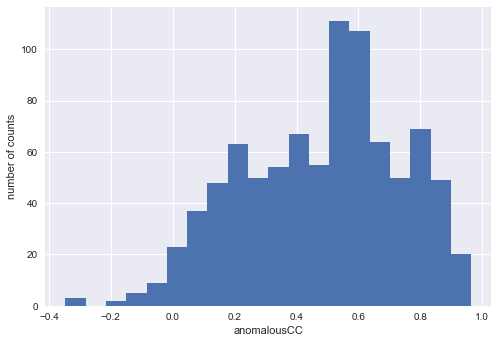

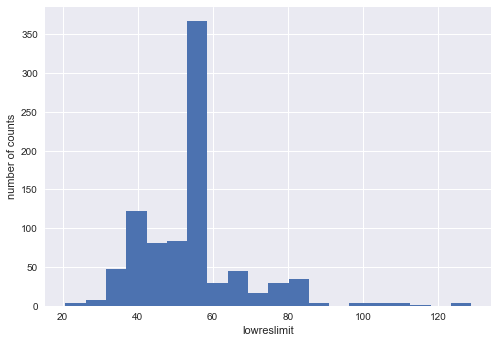

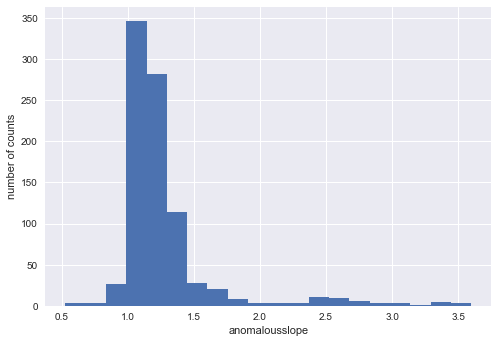

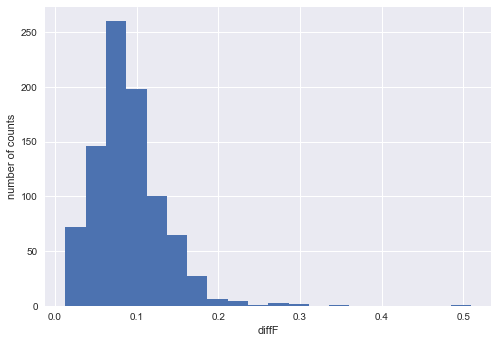

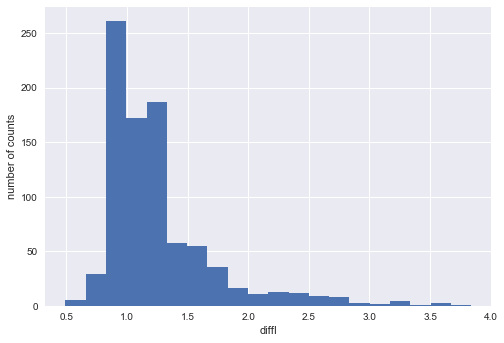

...

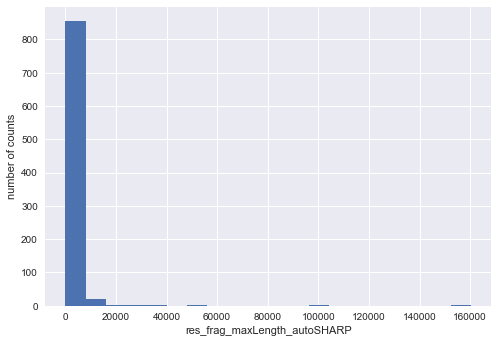

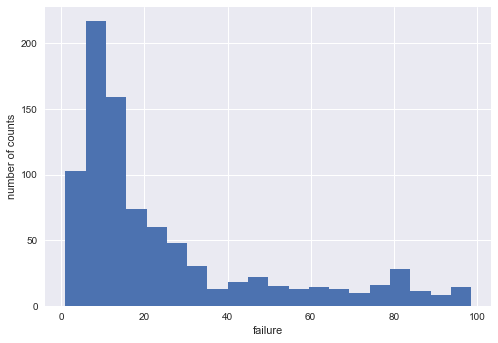

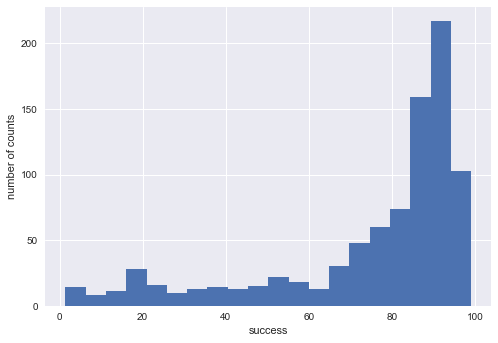

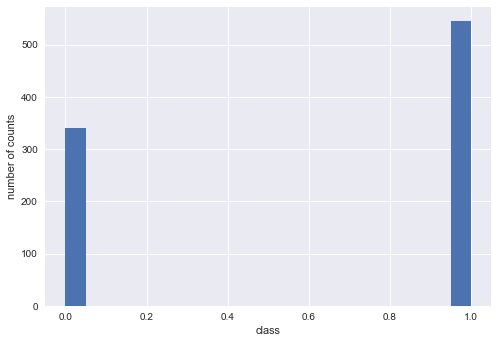

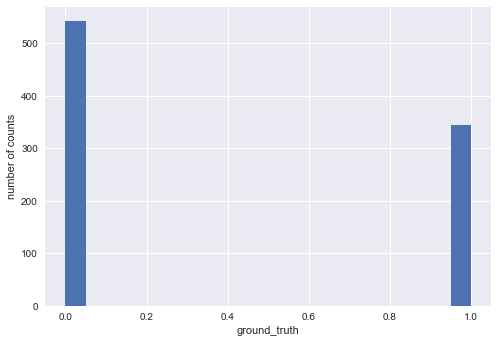

################################################################################
########################### full training data DIALS ###########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


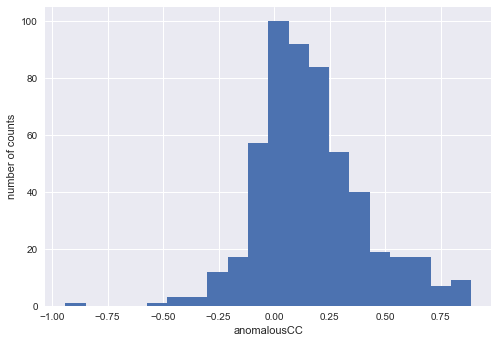

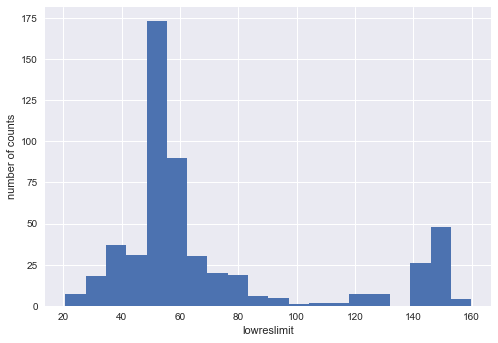

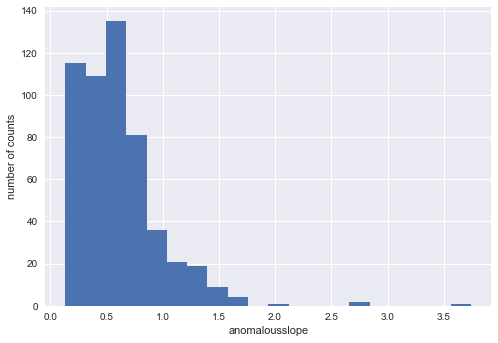

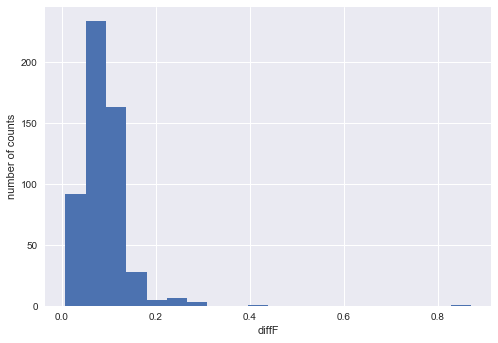

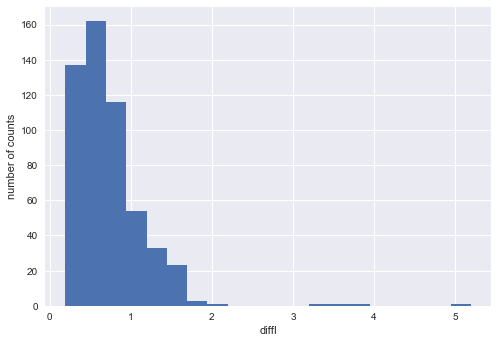

...

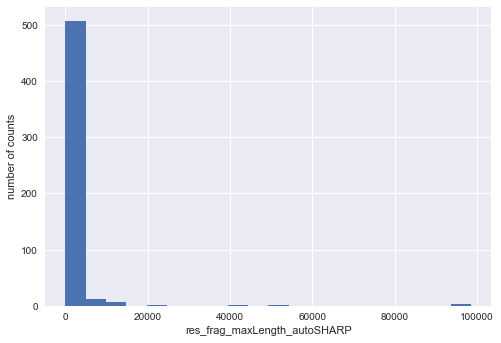

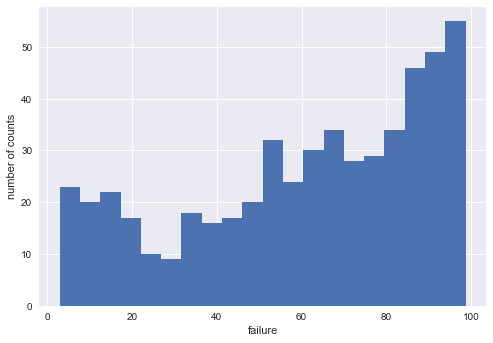

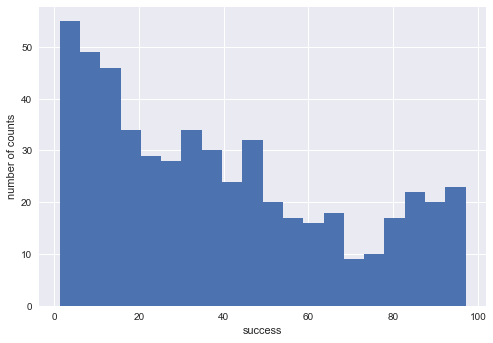

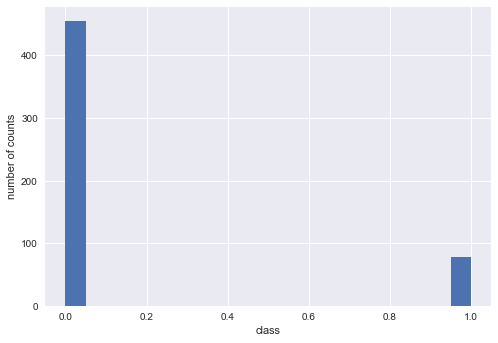

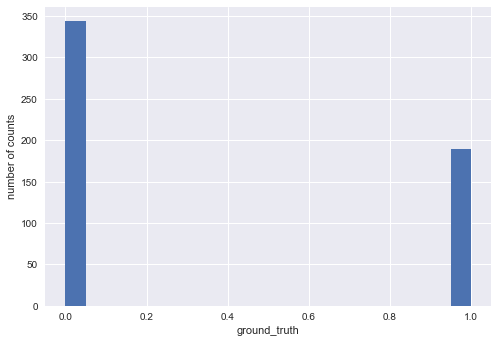

################################################################################
############################## standardised data #############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


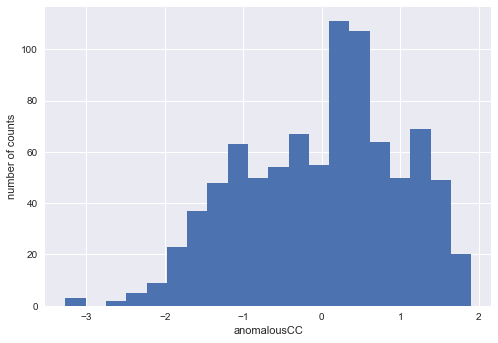

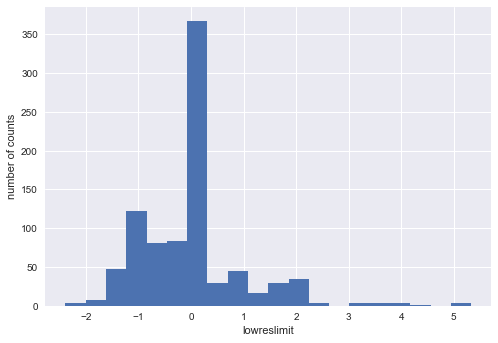

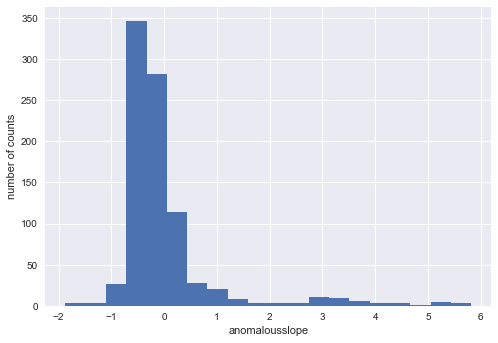

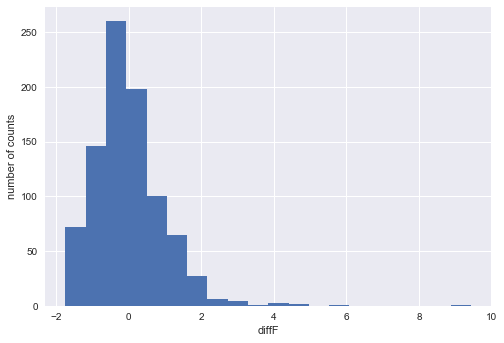

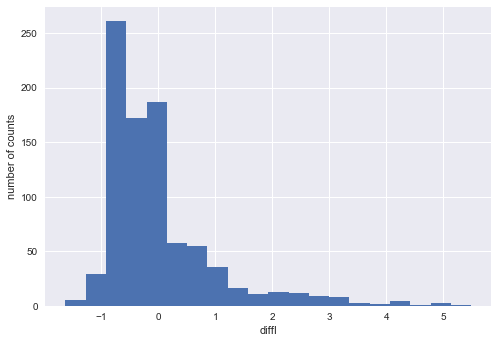

...

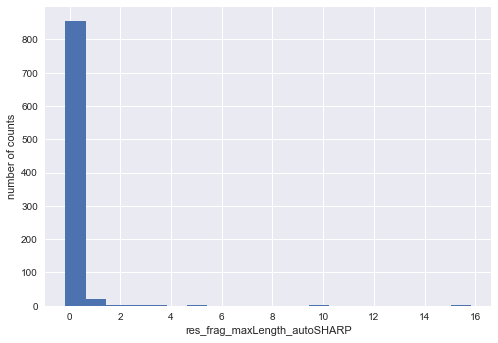

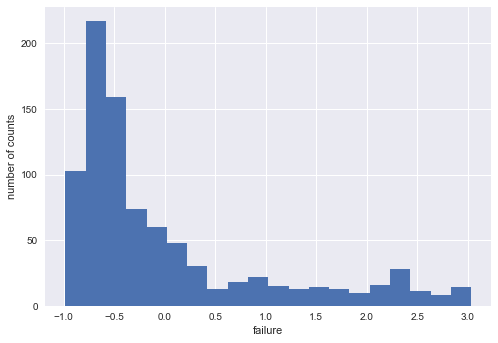

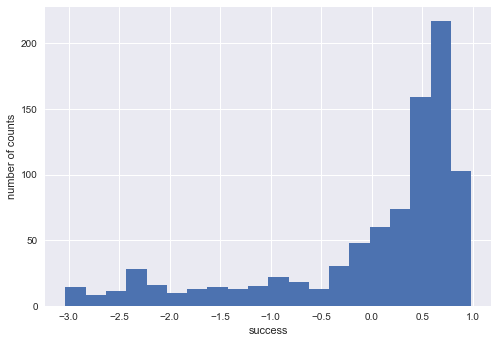

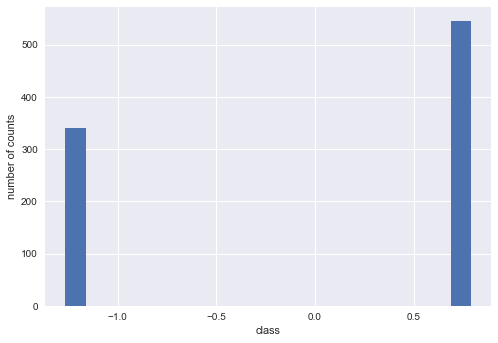

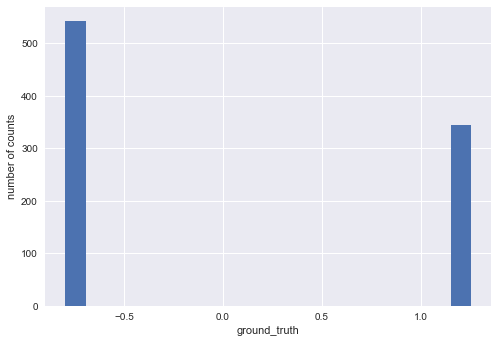

################################################################################
########################### full training data DIALS ###########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


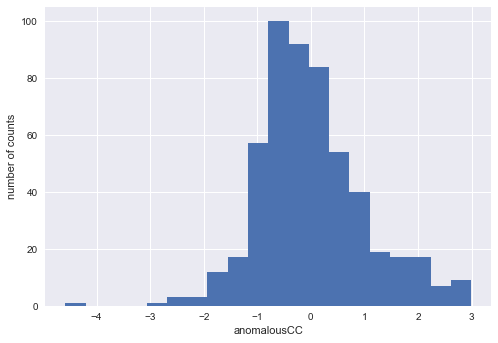

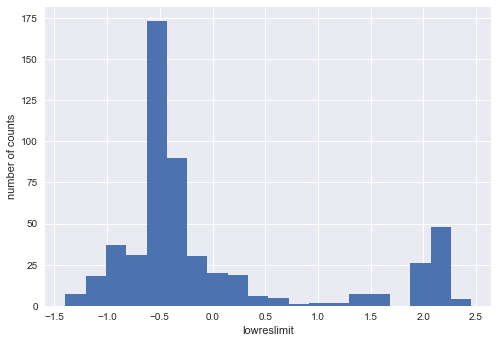

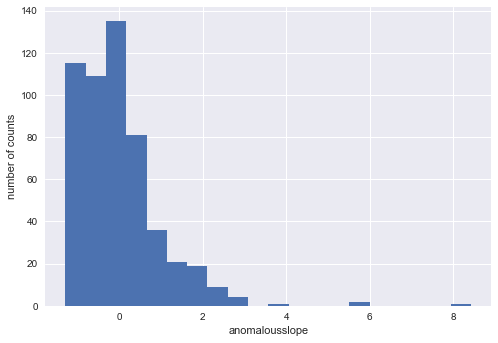

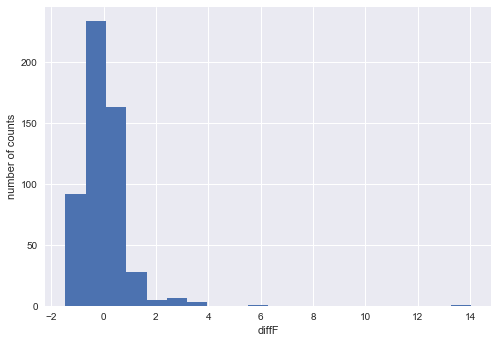

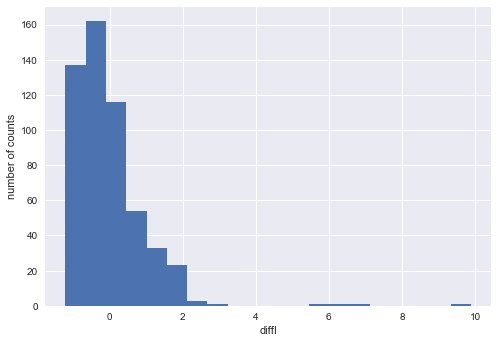

...

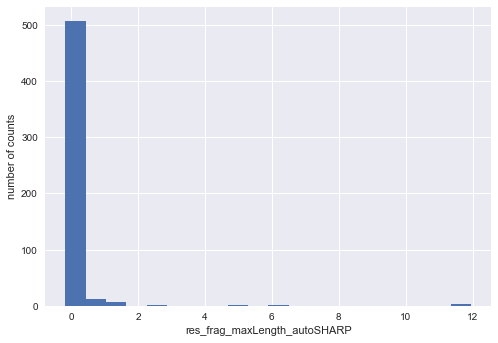

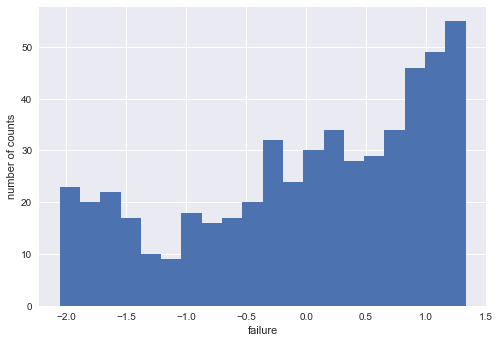

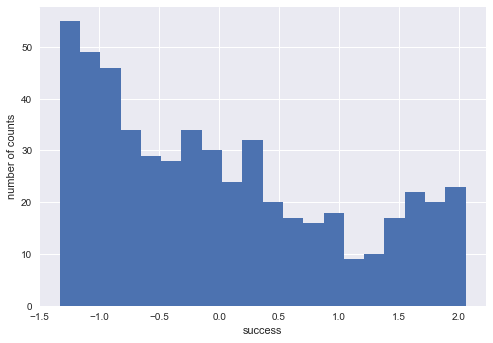

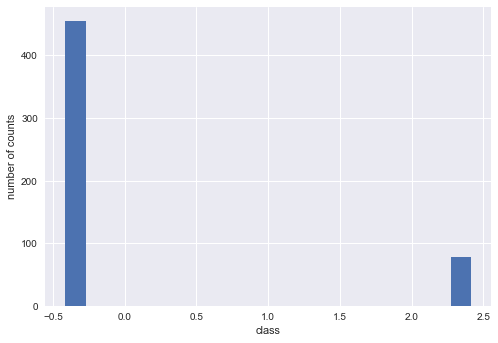

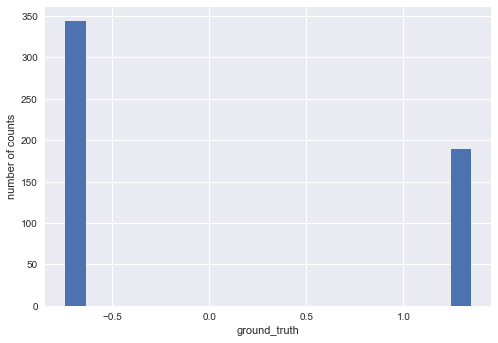

################################################################################
############################# unstandardised data ############################
################################################################################
######################### subsets of training data with phasing results 3dii ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


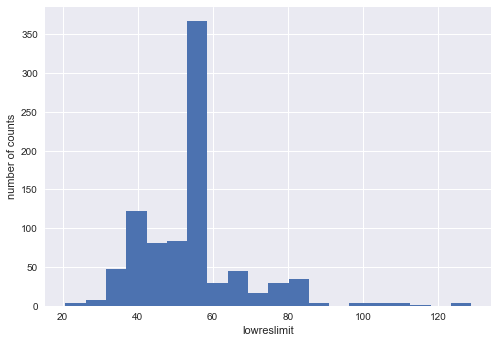

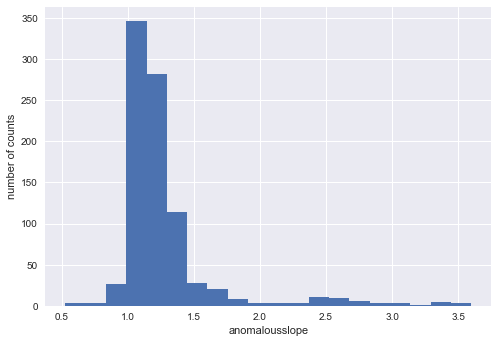

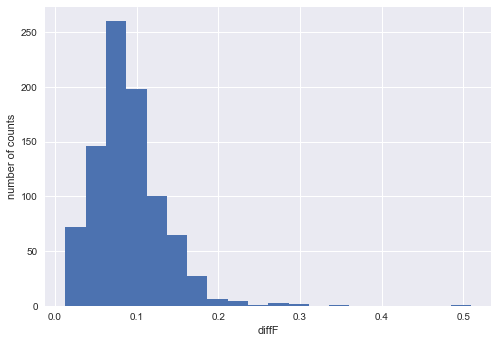

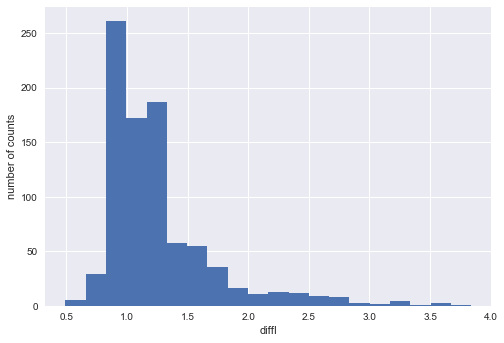

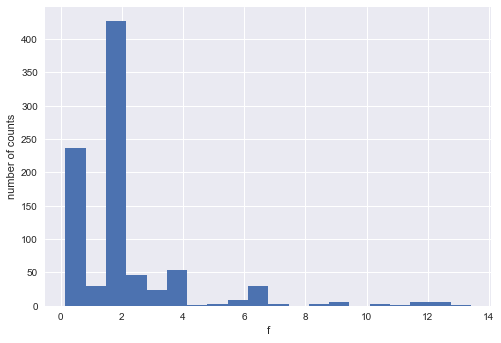

...

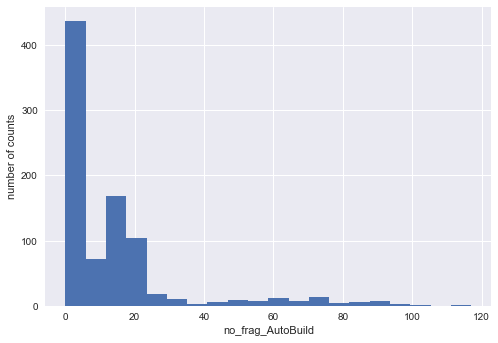

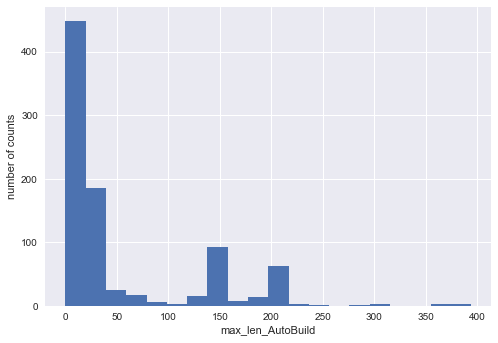

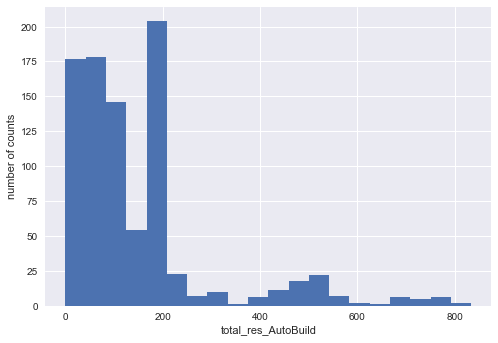

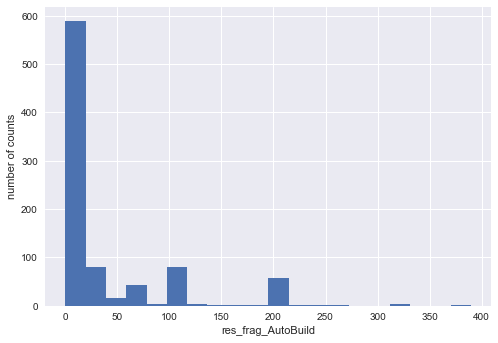

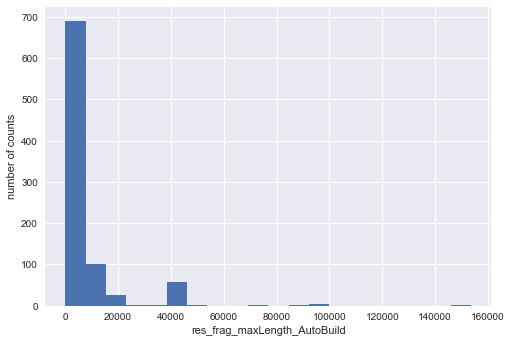

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


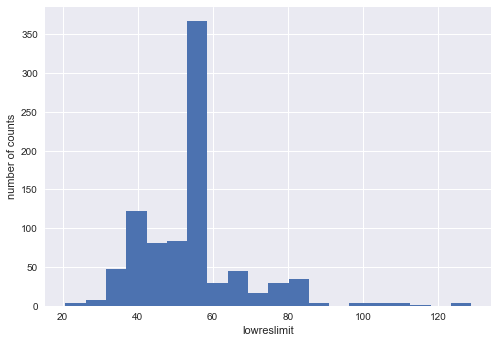

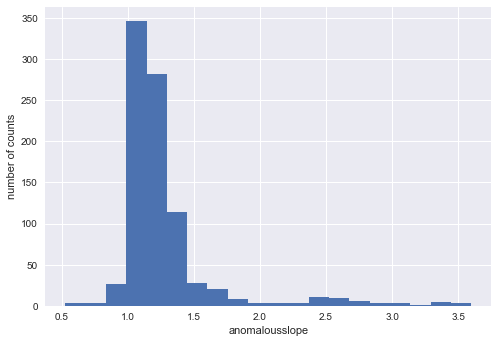

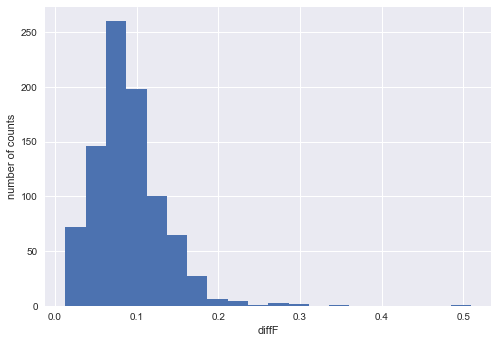

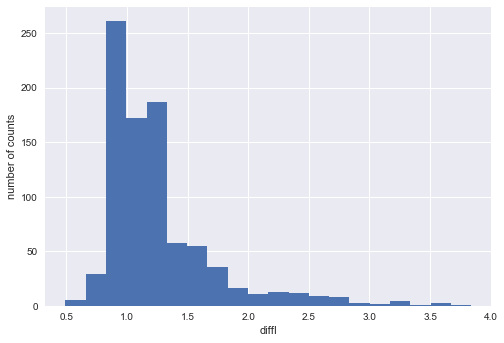

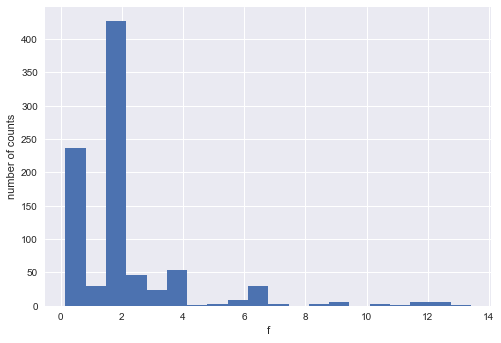

...

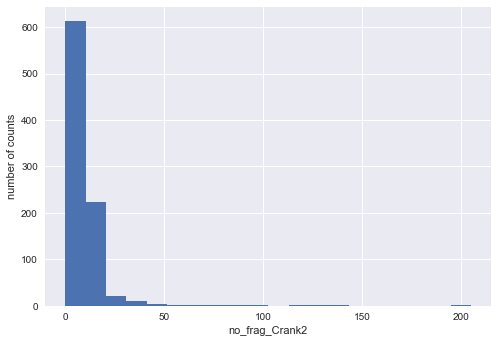

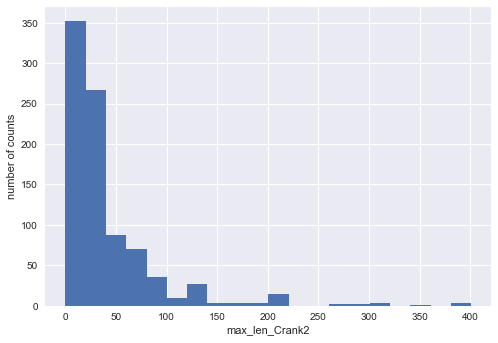

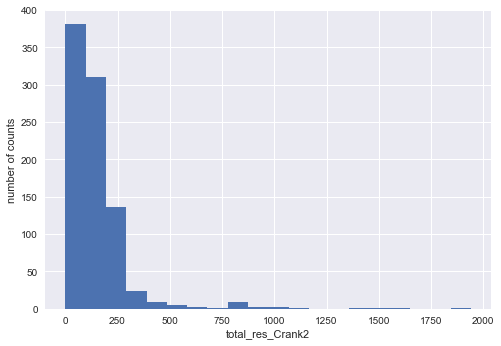

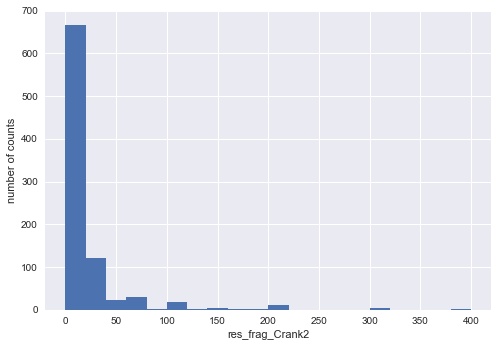

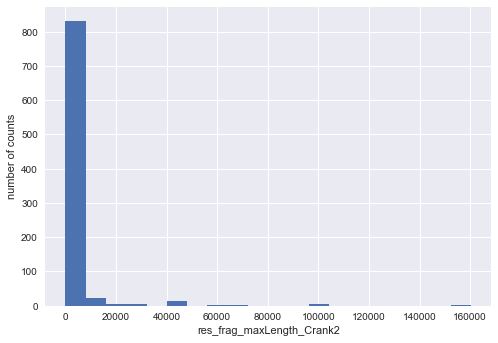

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


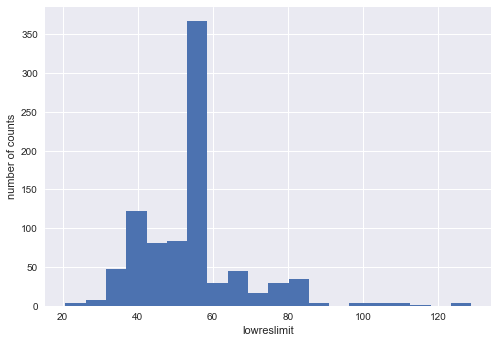

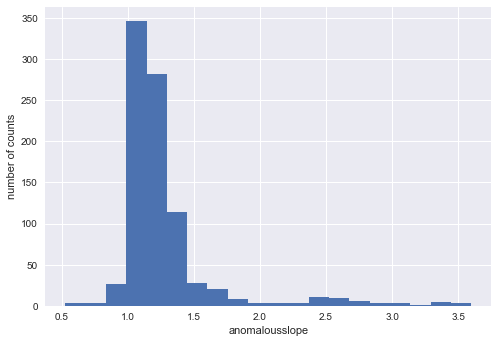

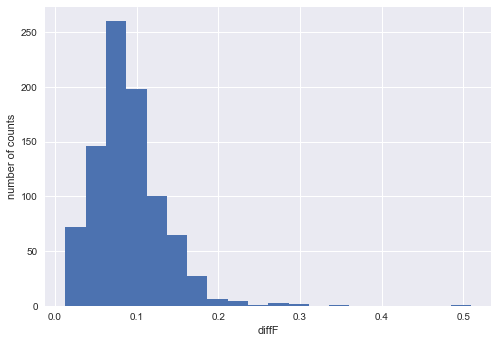

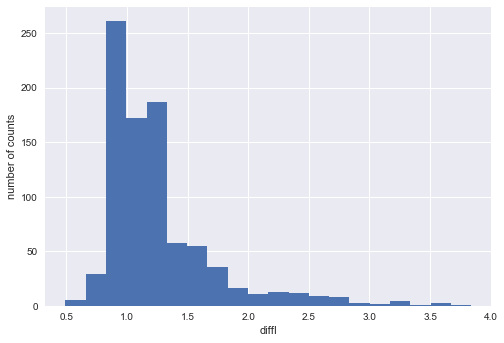

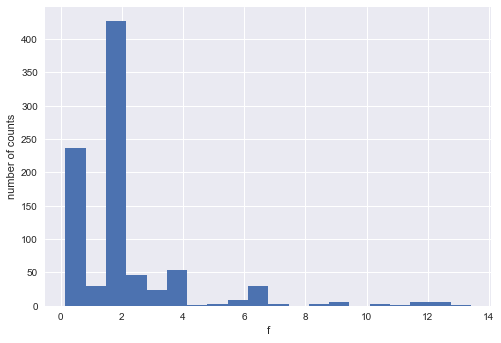

...

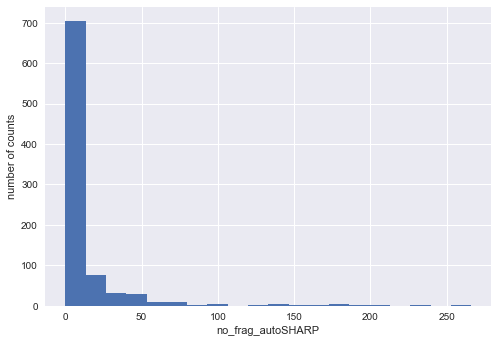

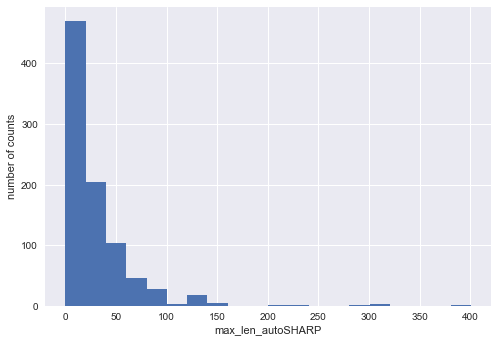

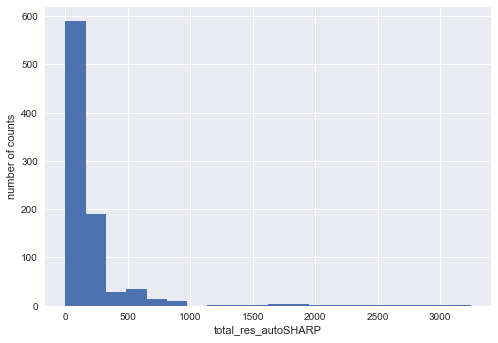

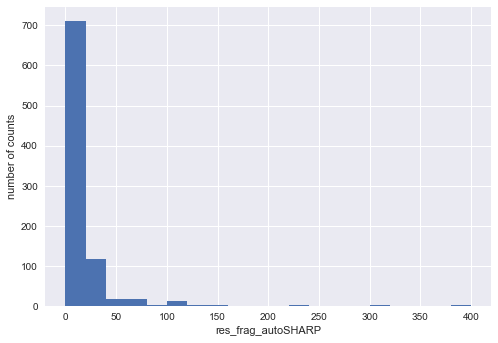

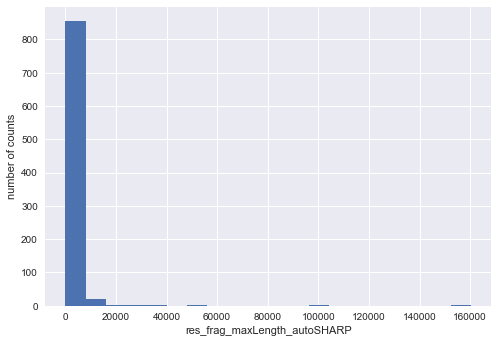

################################################################################
######################## subsets of training data with phasing results DIALS ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


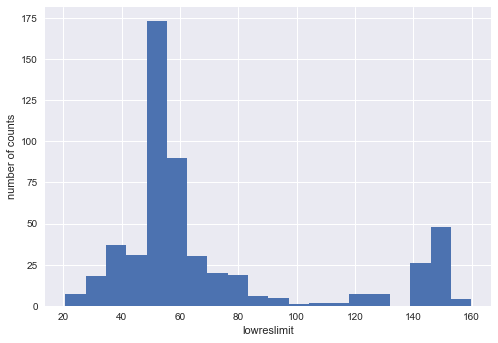

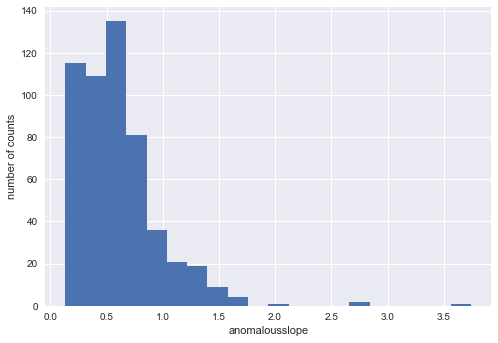

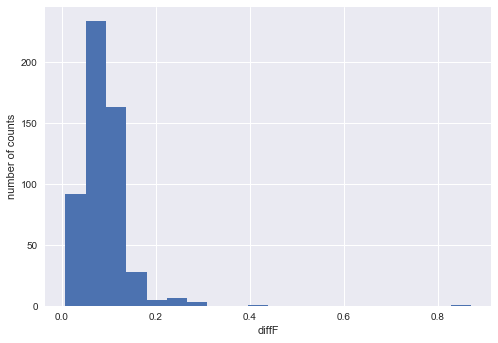

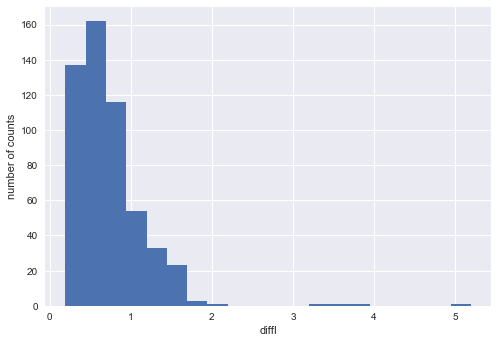

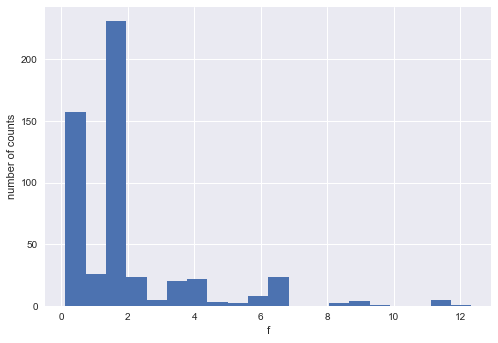

...

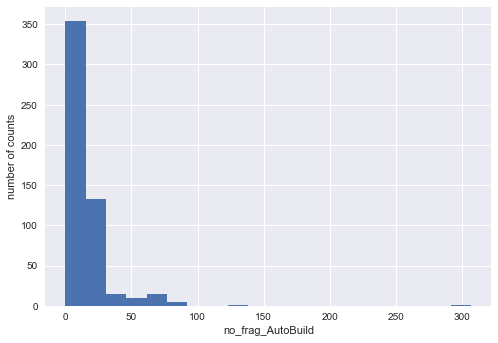

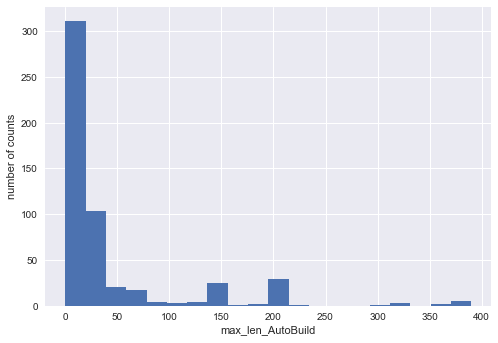

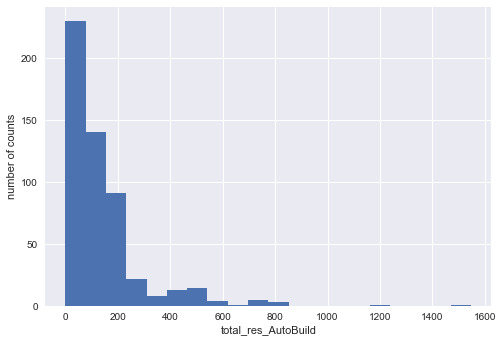

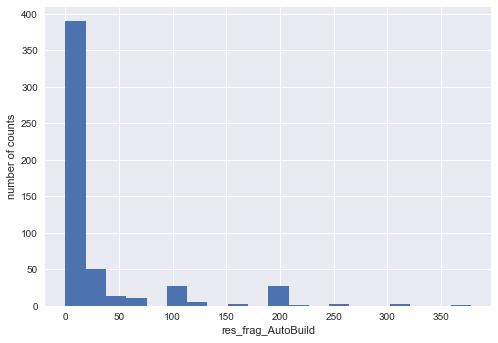

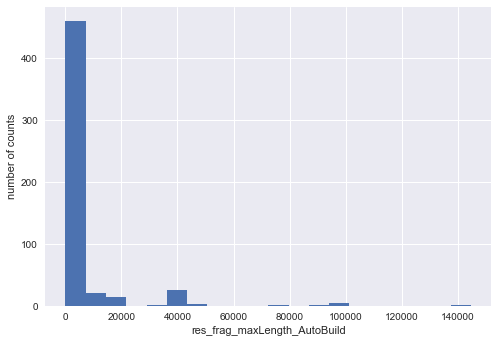

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


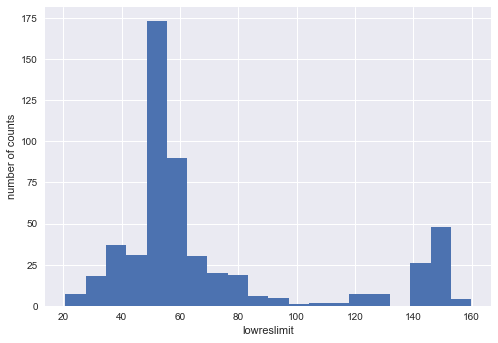

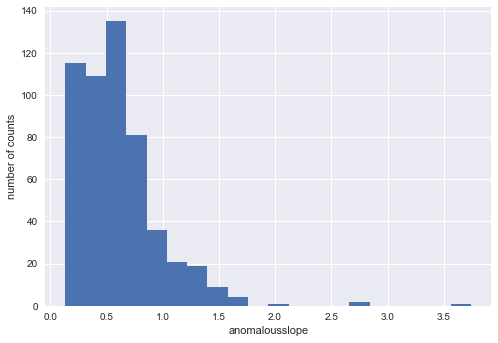

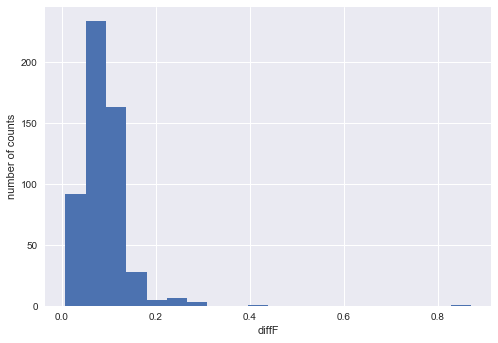

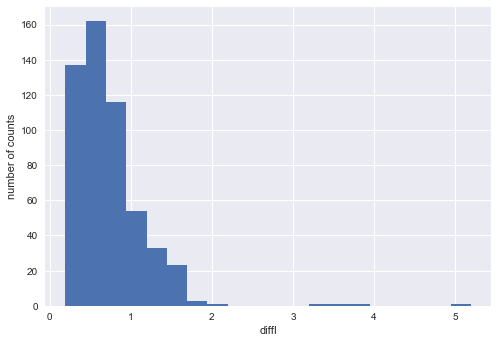

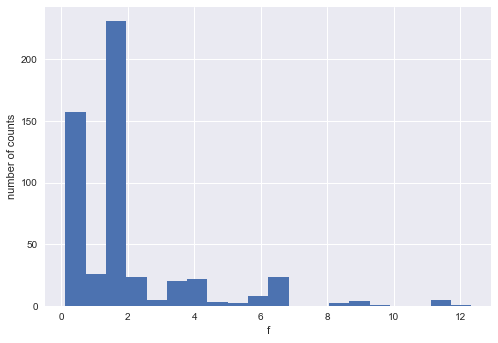

...

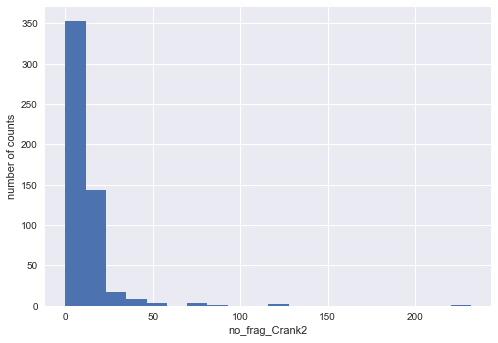

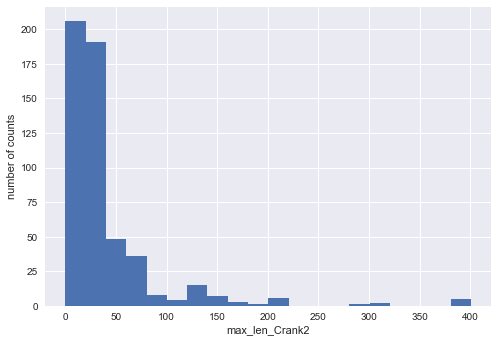

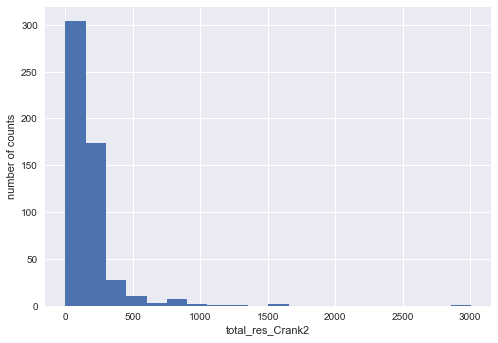

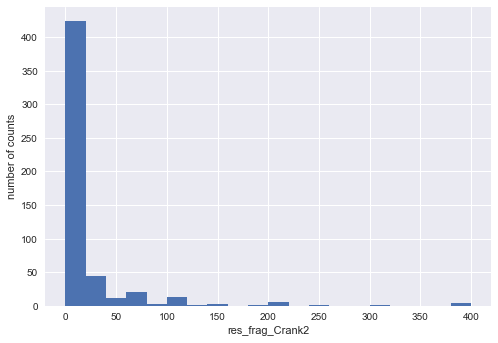

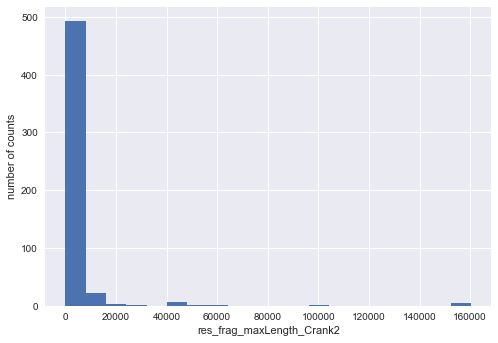

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


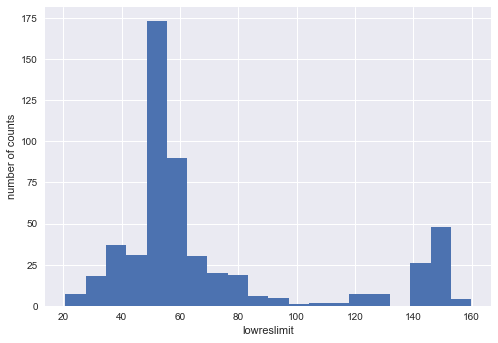

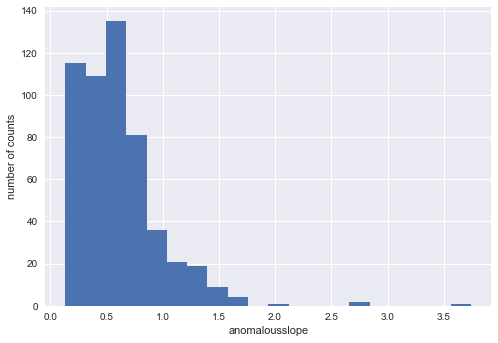

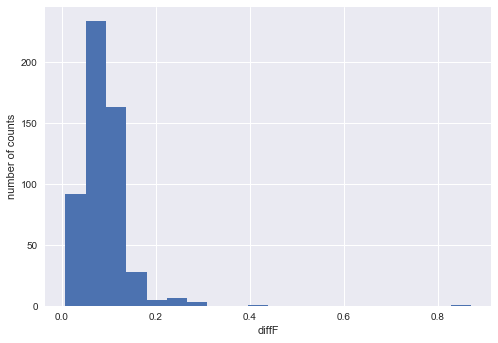

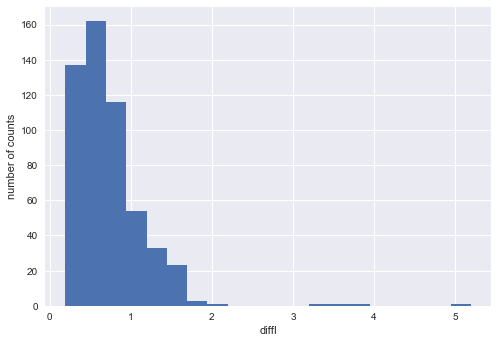

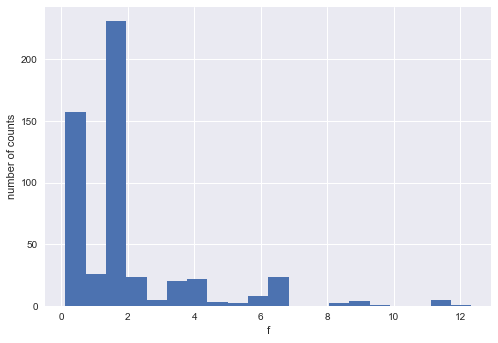

...

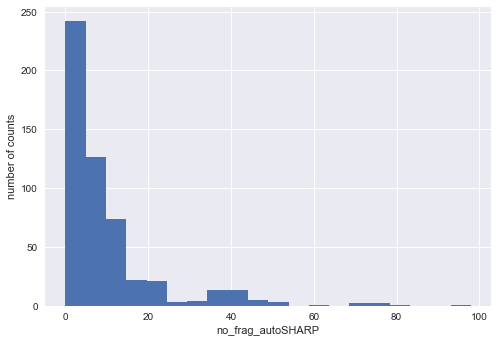

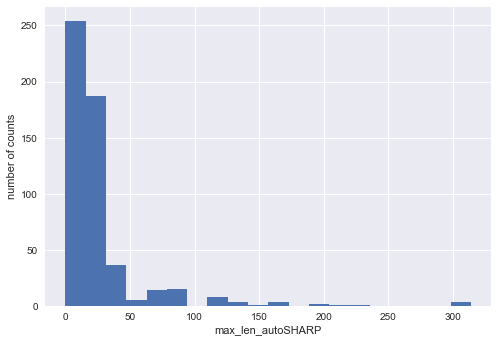

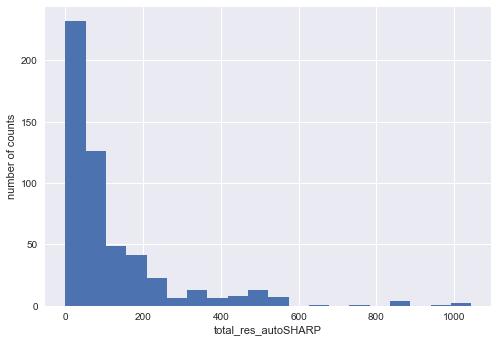

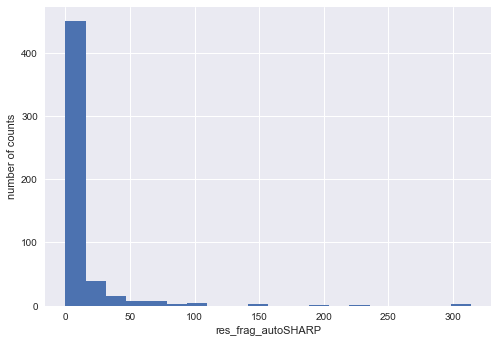

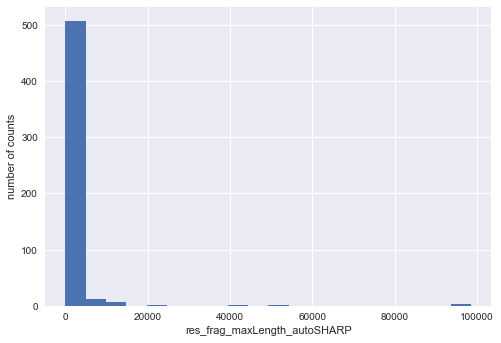

################################################################################
######################### subsets of training data without phasing results 3dii ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


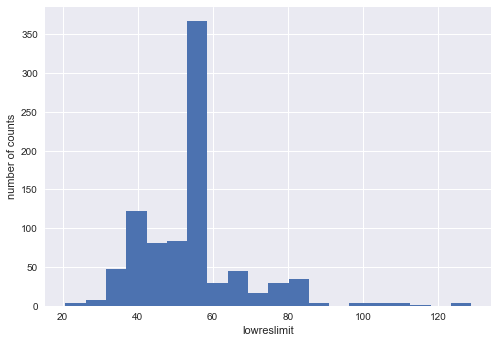

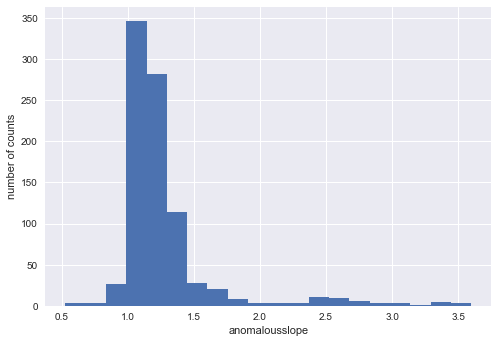

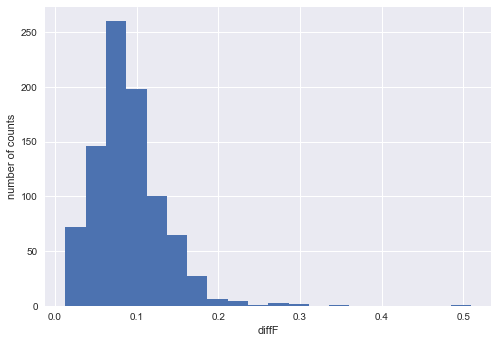

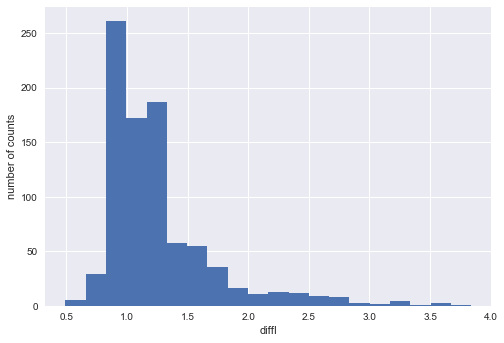

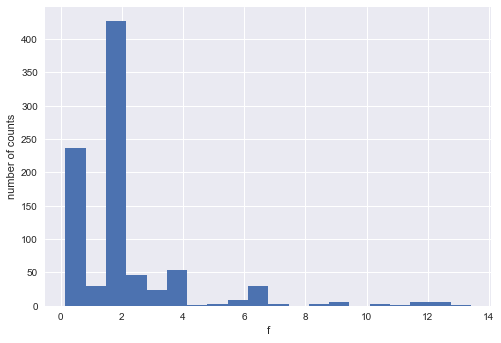

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


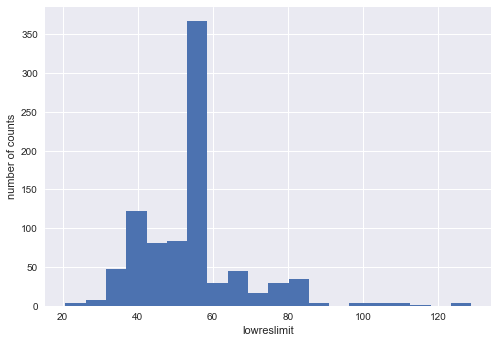

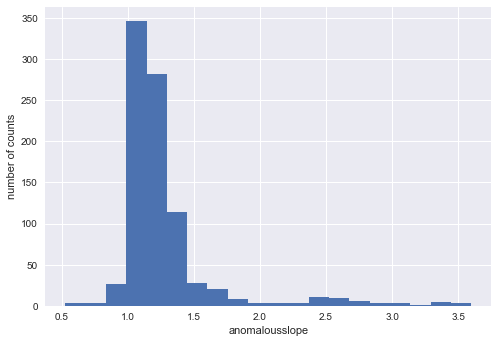

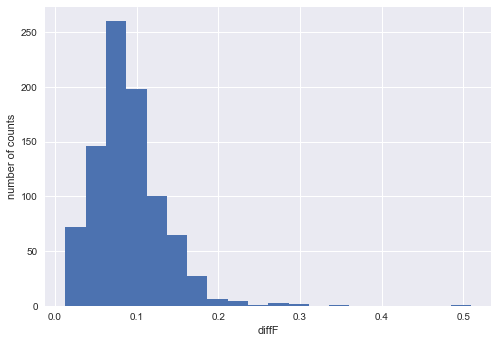

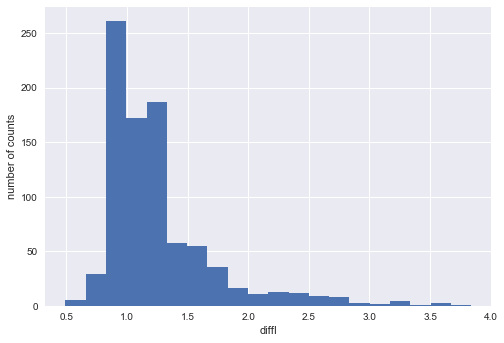

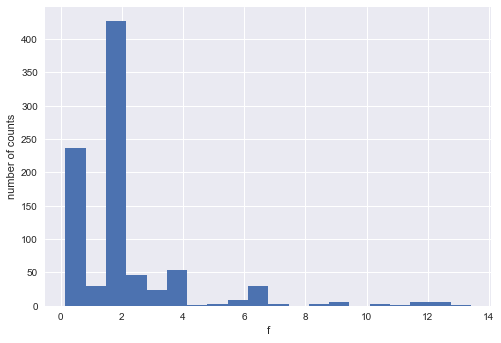

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


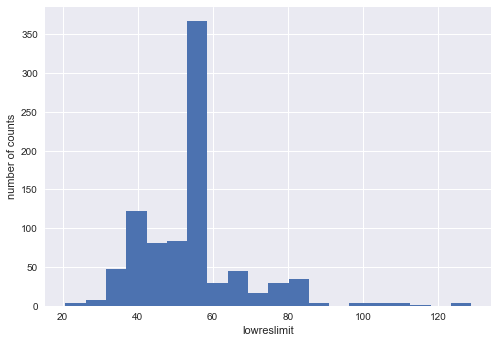

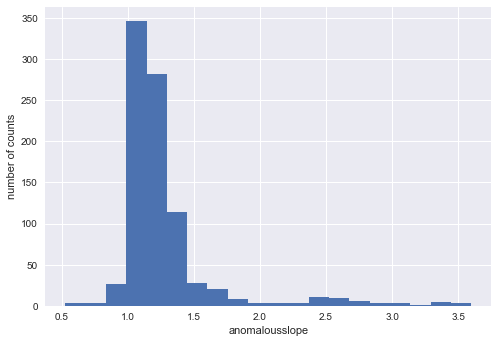

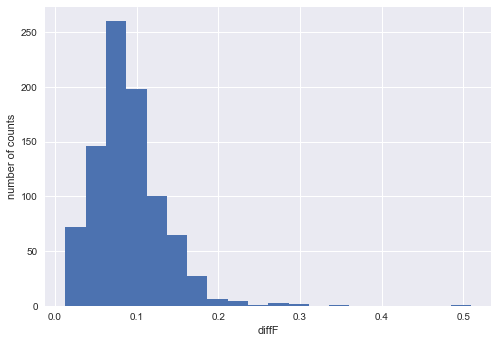

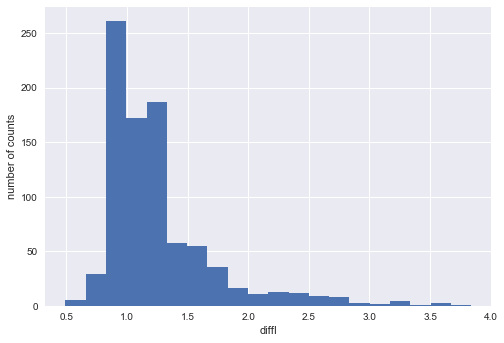

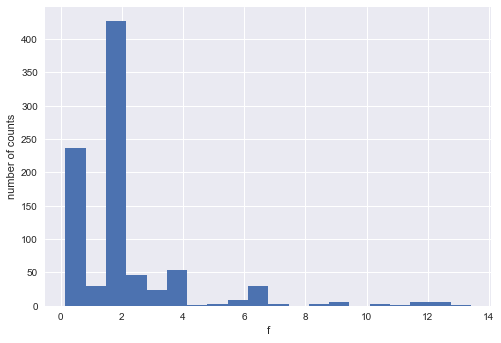

################################################################################
######################## subsets of training data without phasing results DIALS ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


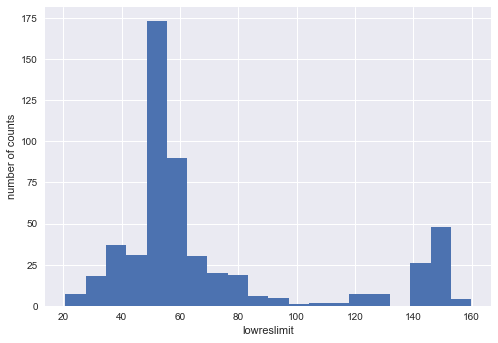

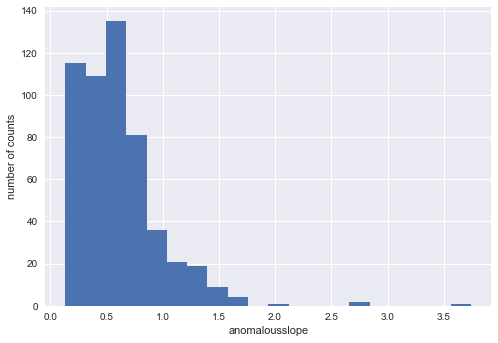

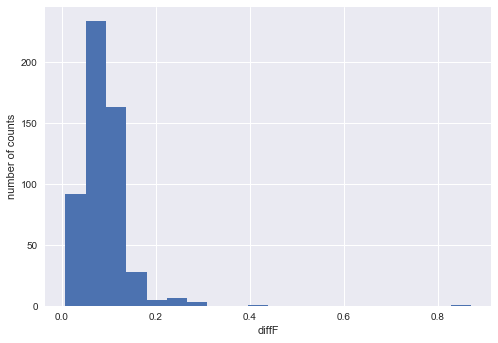

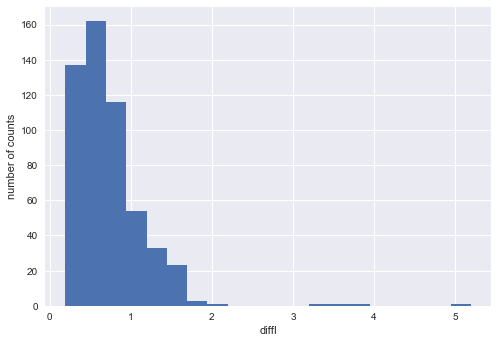

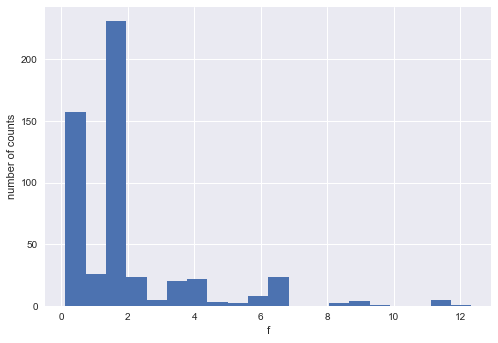

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


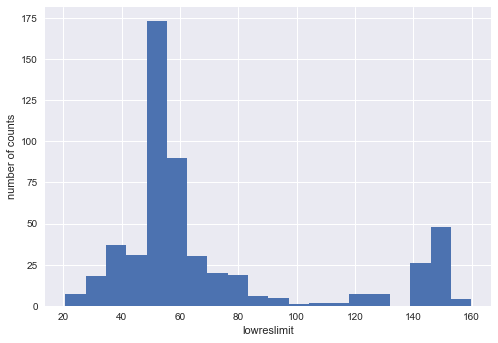

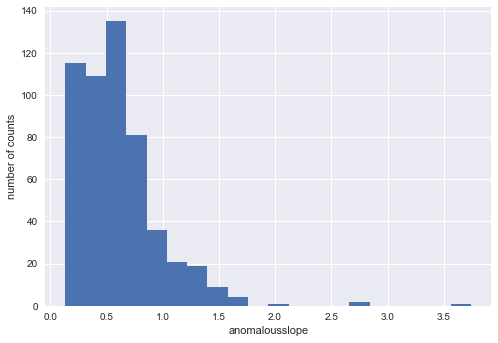

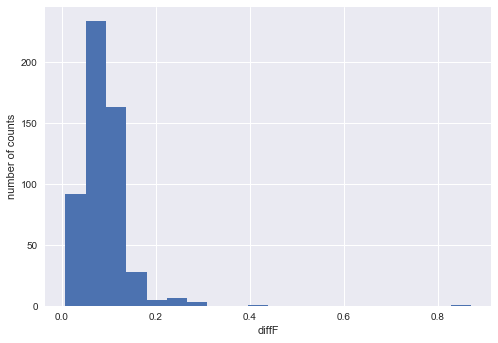

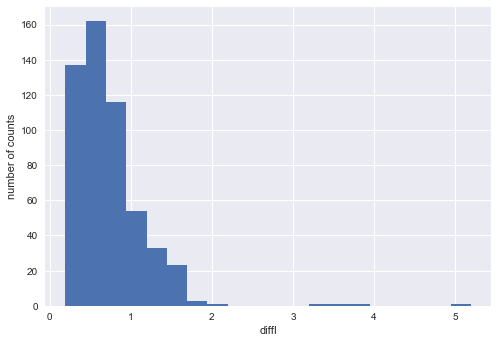

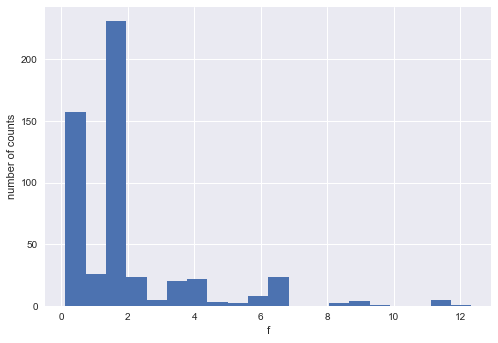

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


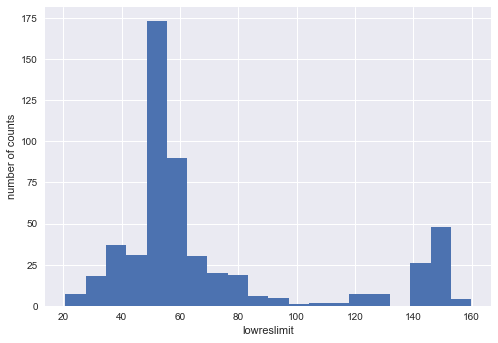

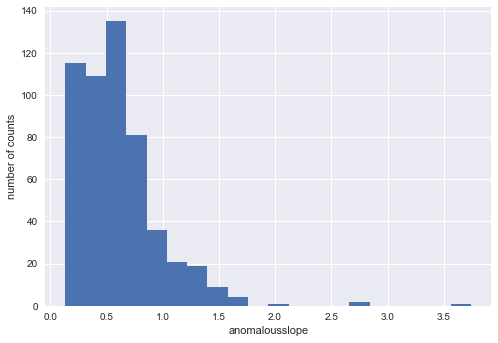

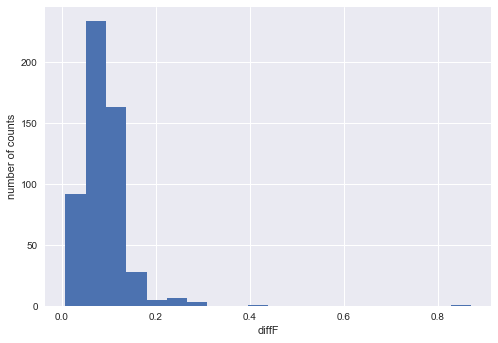

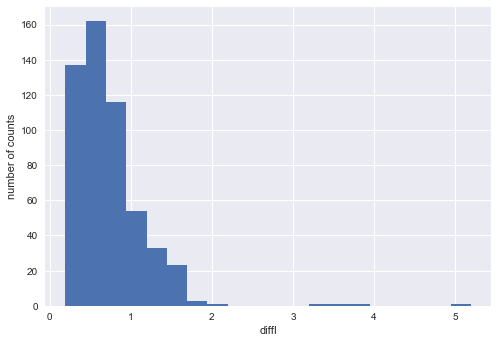

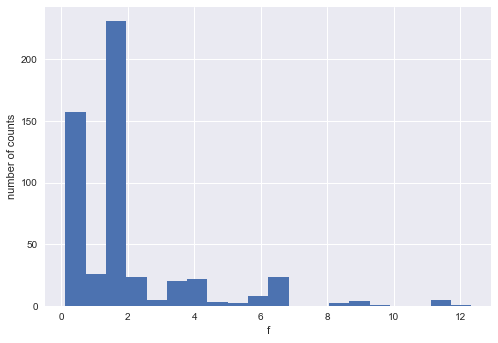

################################################################################
############################## standardised data #############################
################################################################################
######################### subsets of training data with phasing results 3dii ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


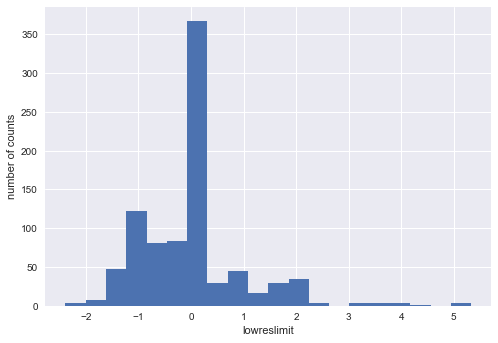

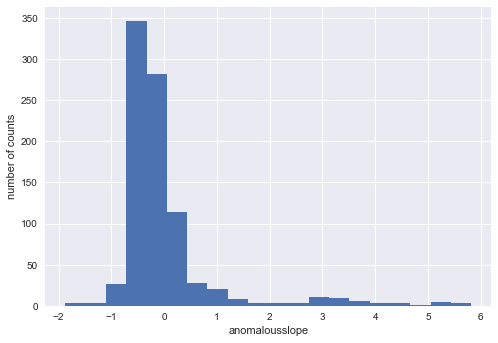

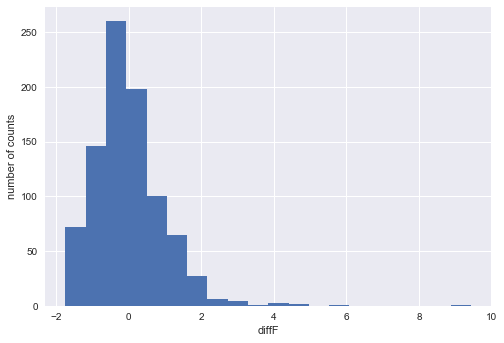

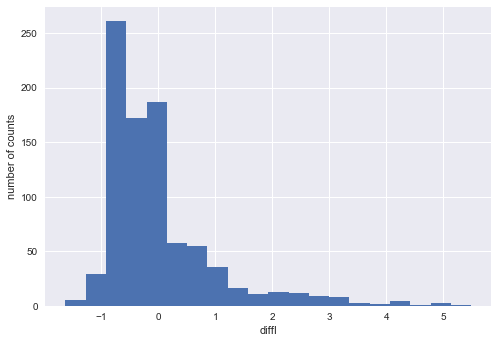

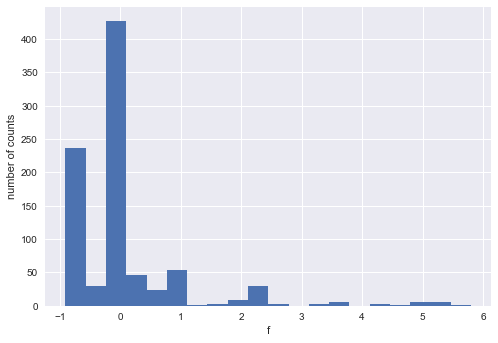

...

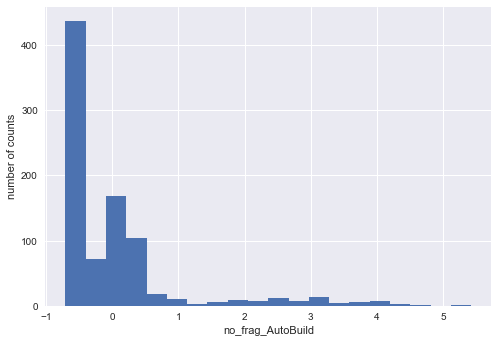

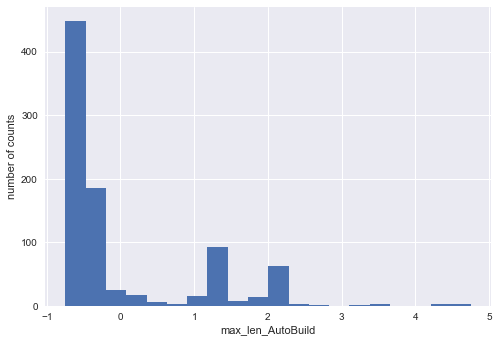

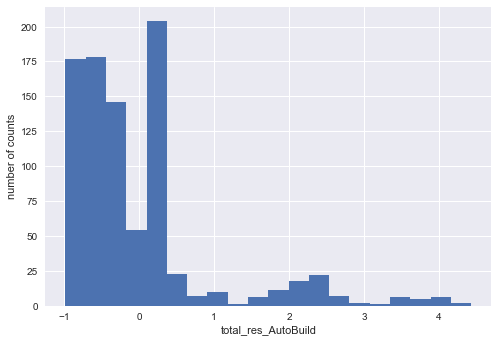

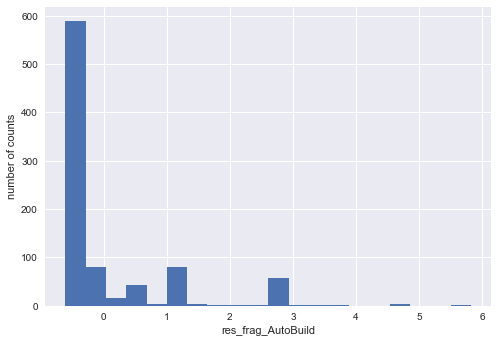

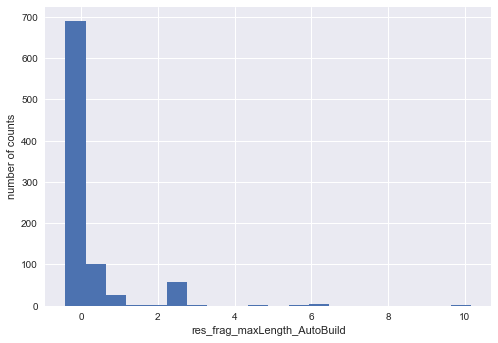

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


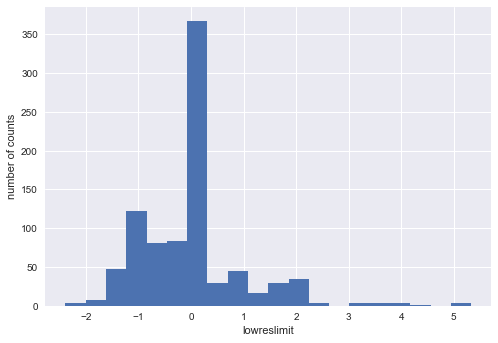

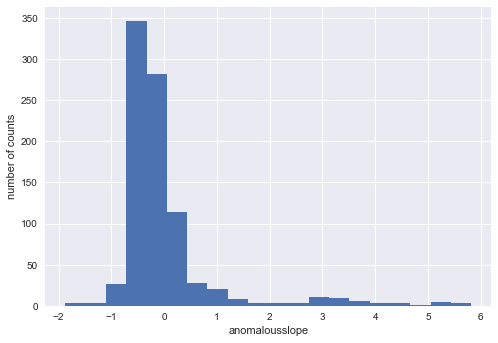

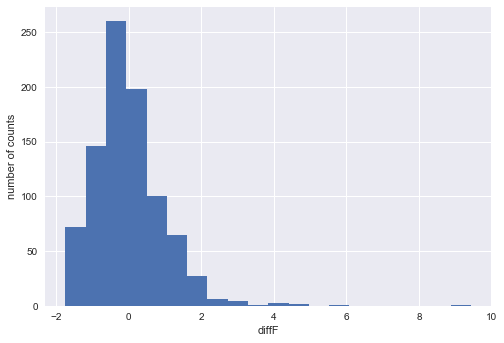

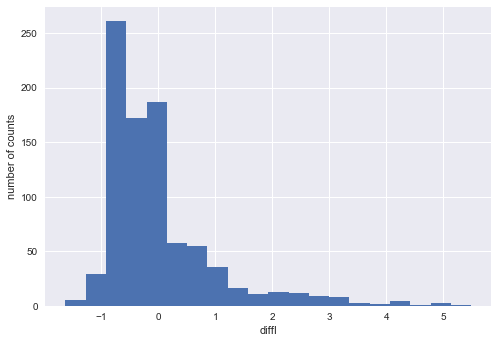

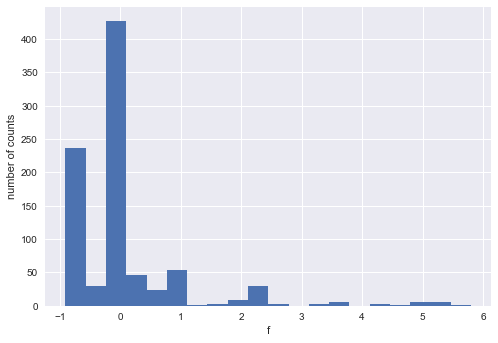

...

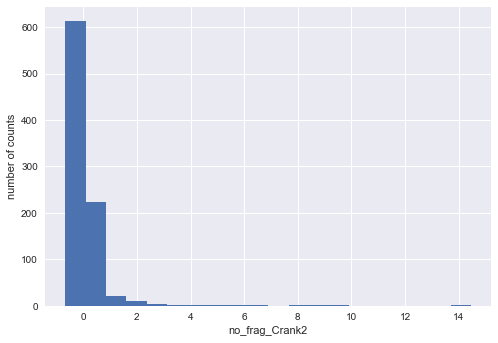

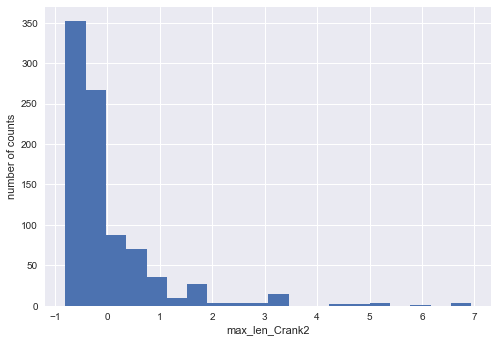

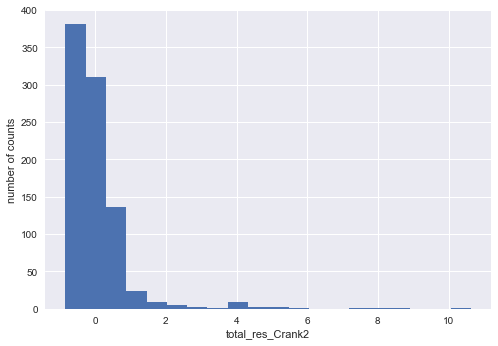

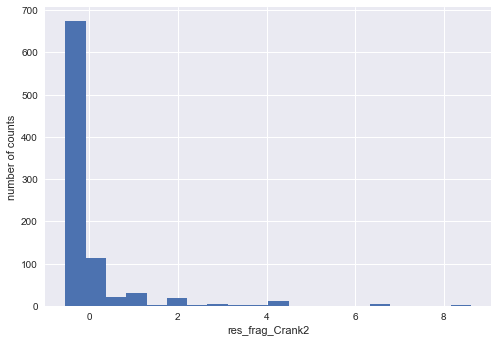

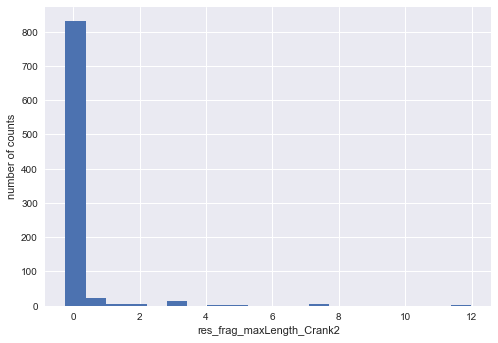

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


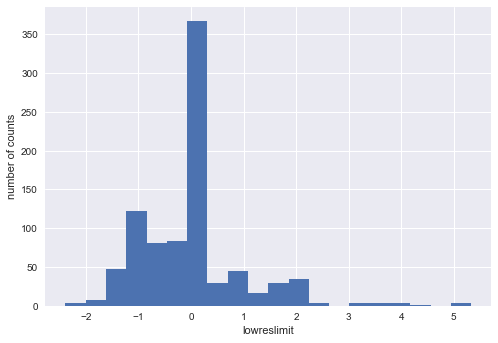

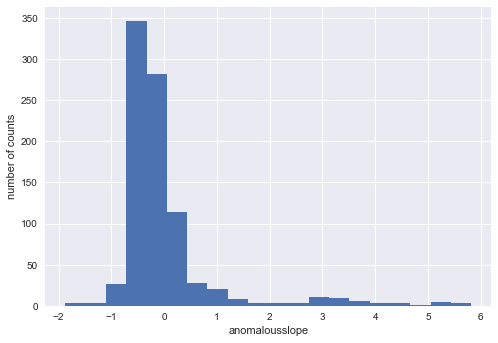

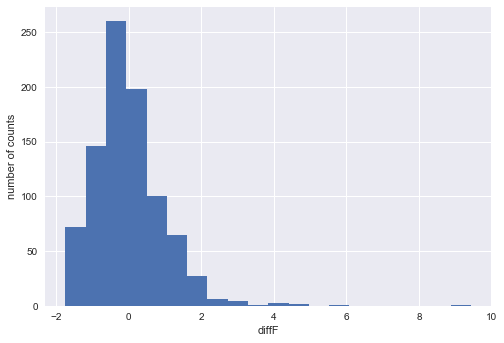

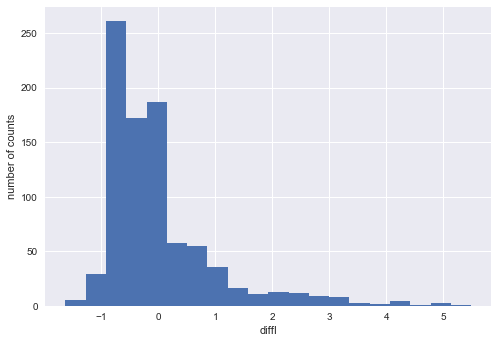

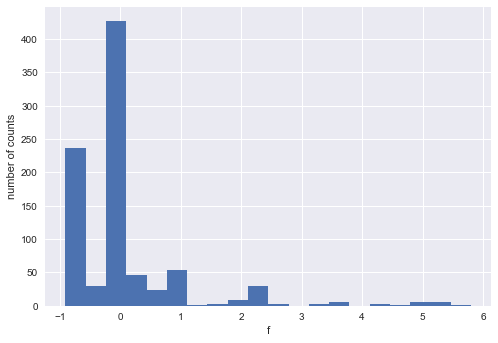

...

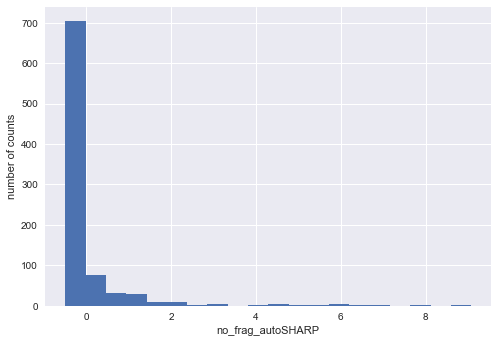

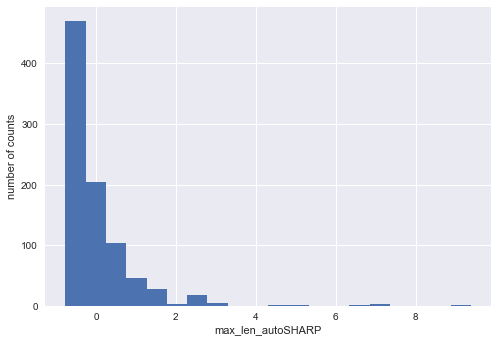

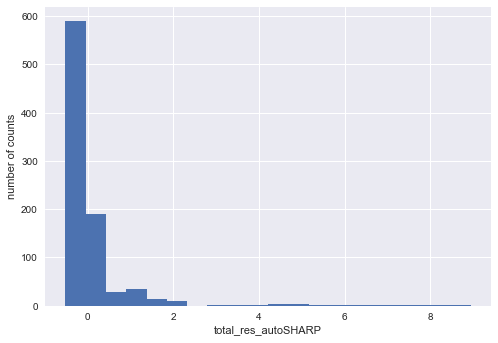

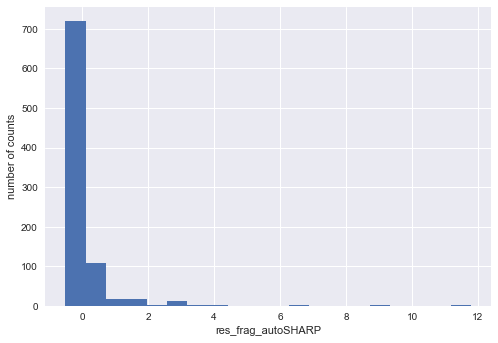

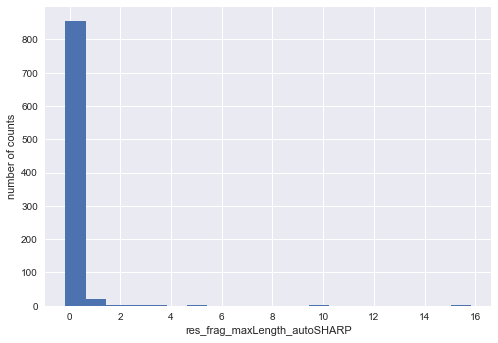

################################################################################
######################## subsets of training data with phasing results DIALS ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


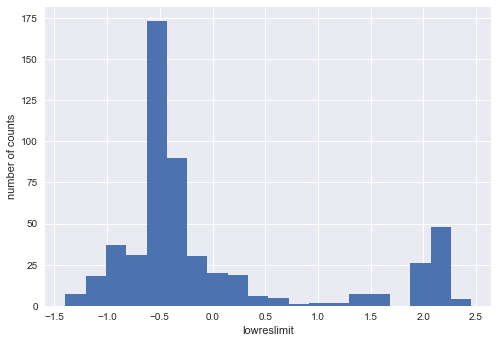

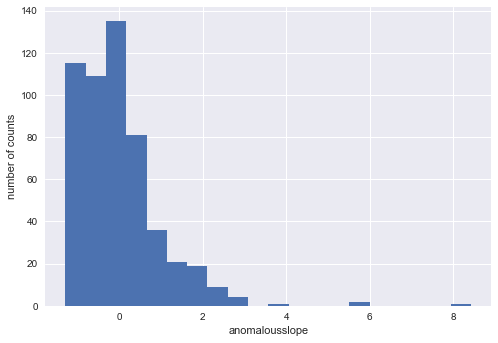

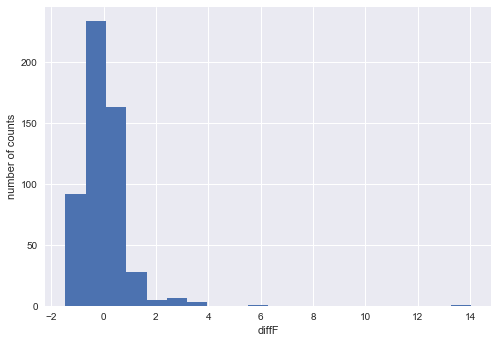

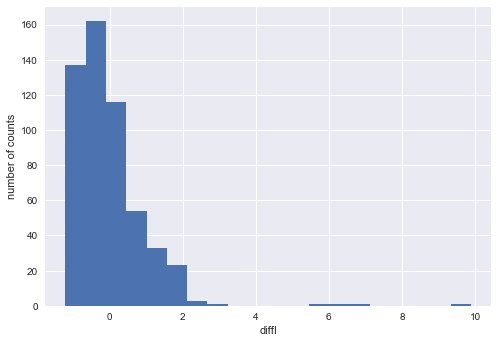

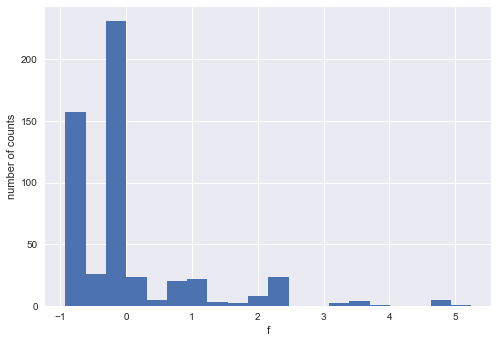

...

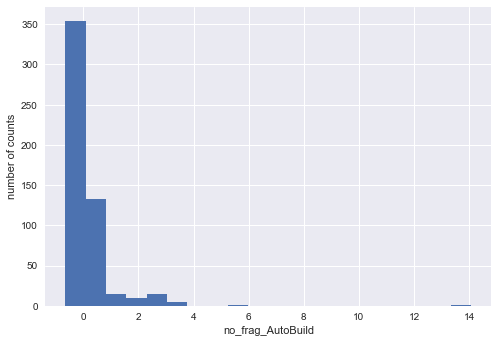

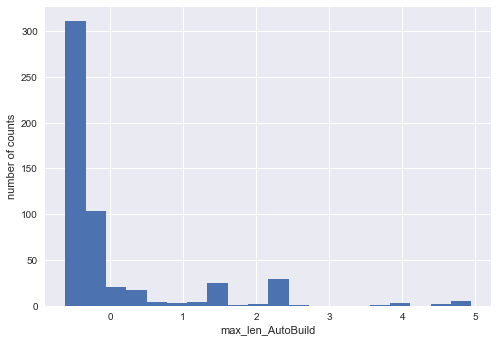

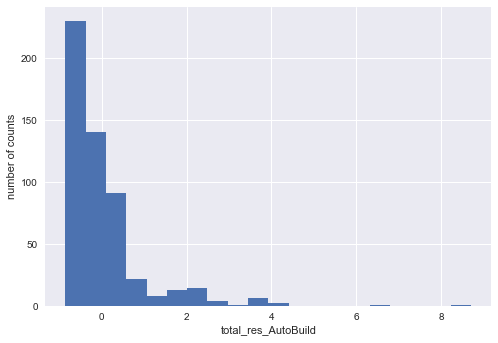

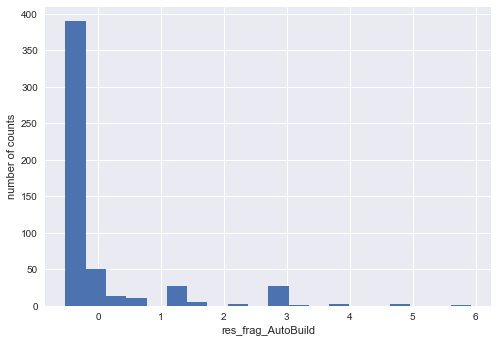

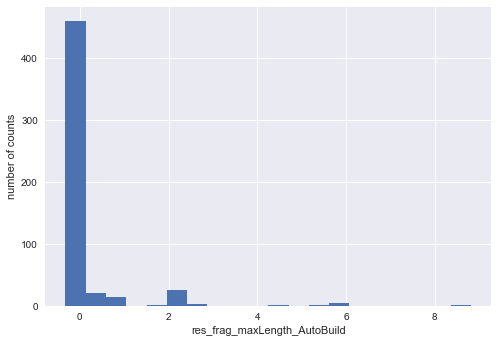

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


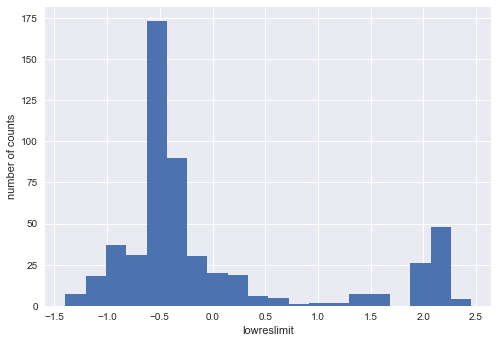

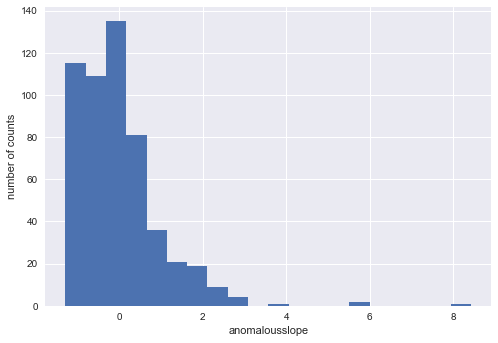

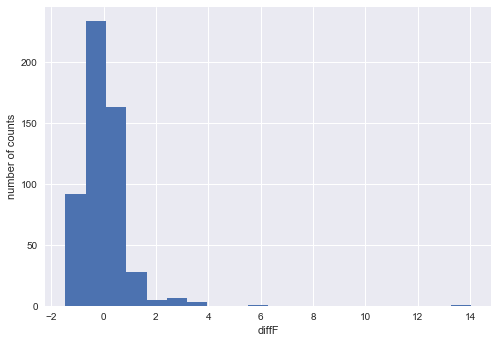

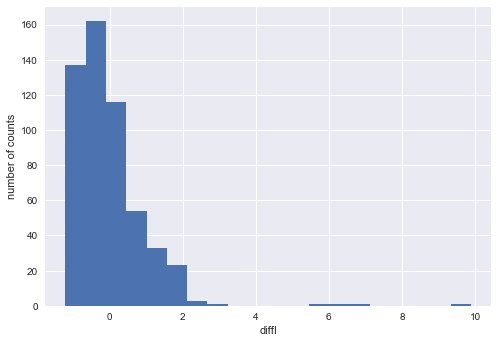

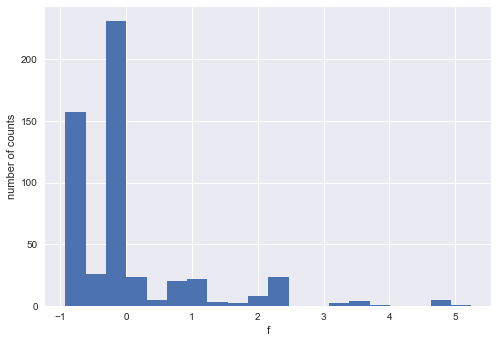

...

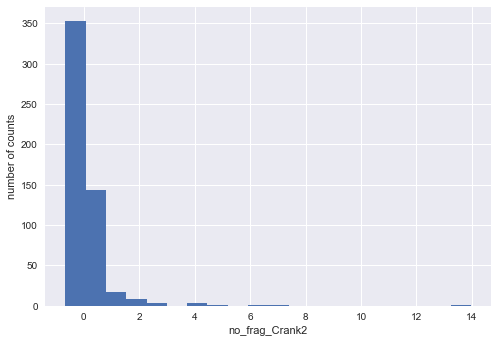

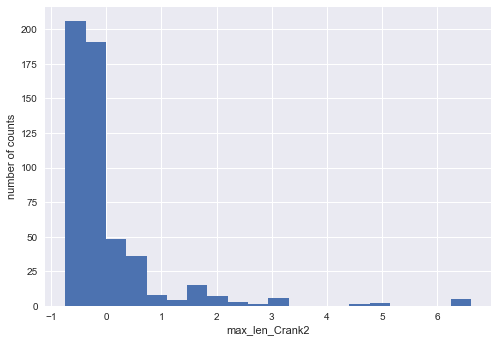

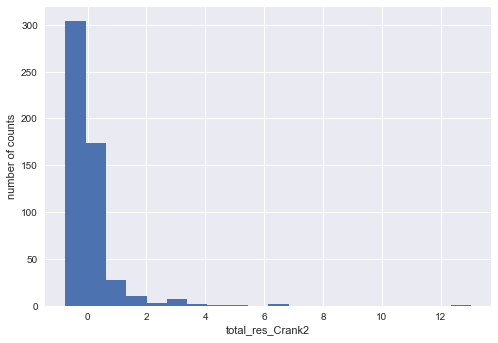

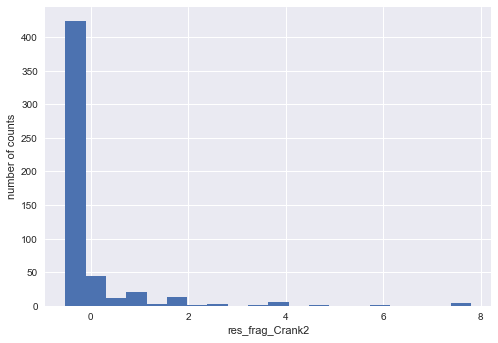

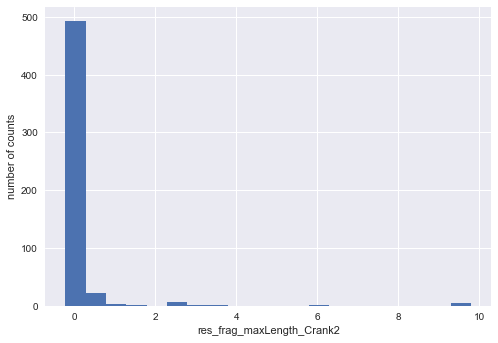

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


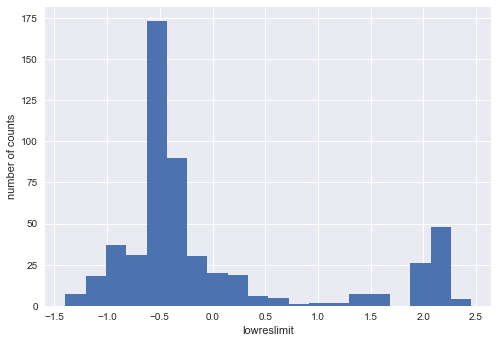

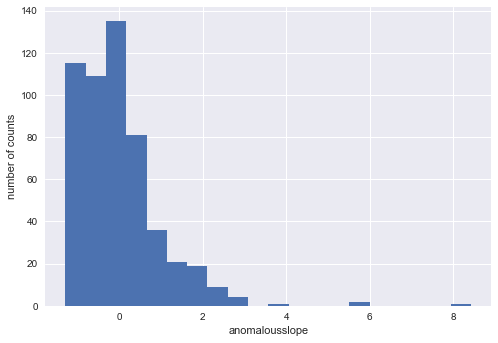

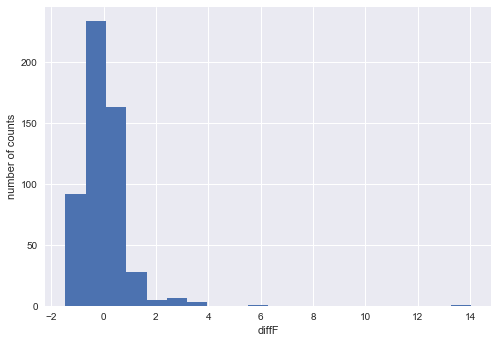

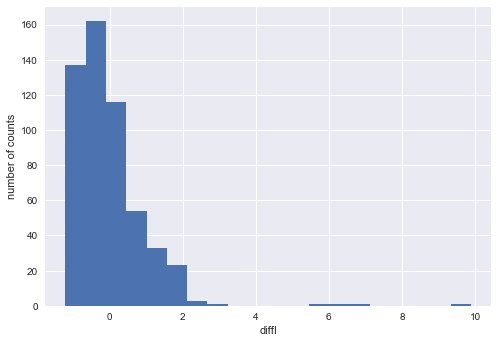

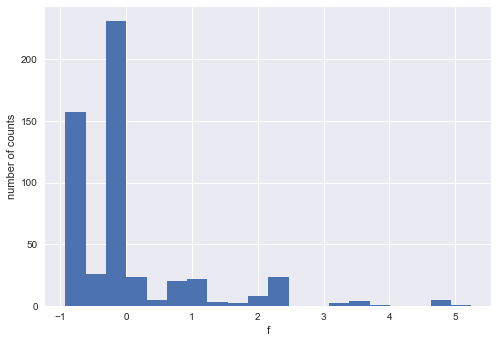

...

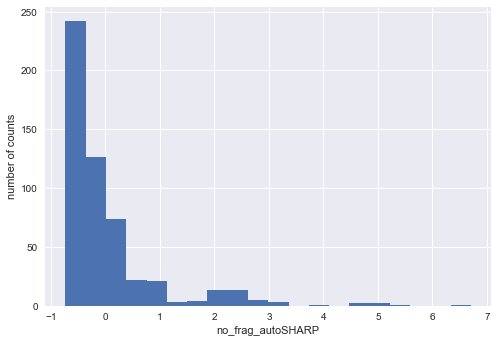

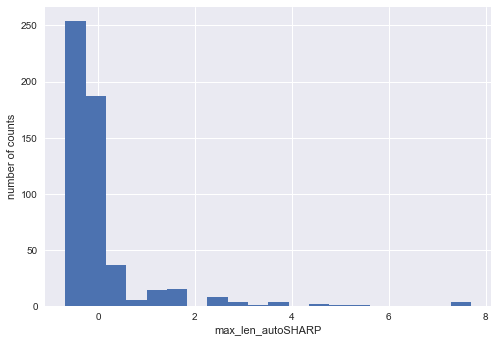

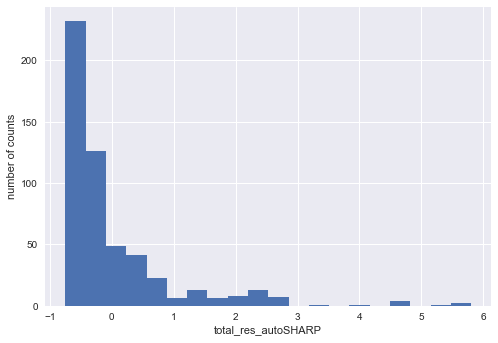

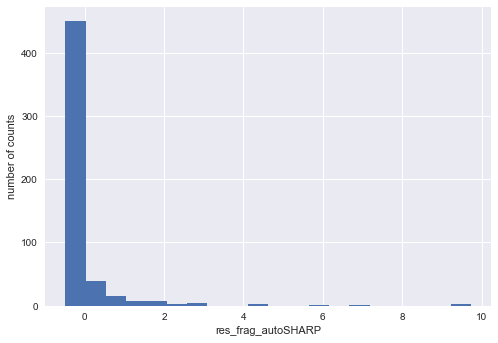

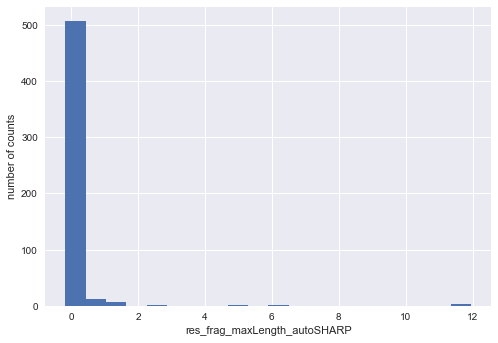

################################################################################
######################### subsets of training data without phasing results 3dii ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


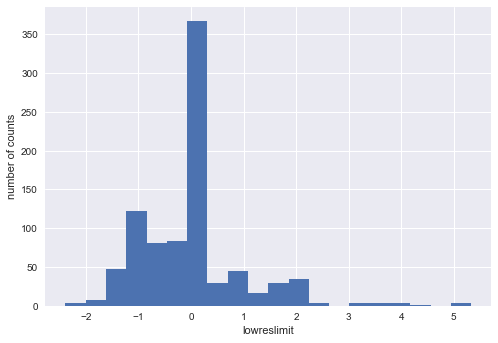

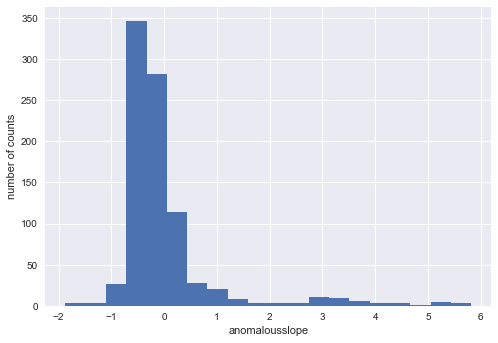

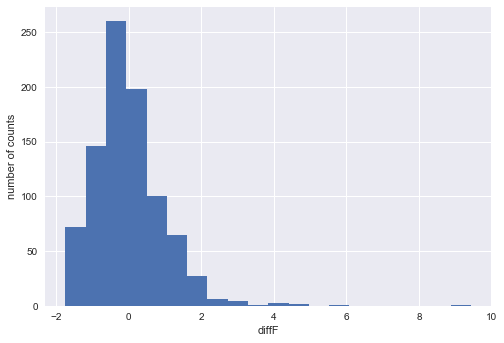

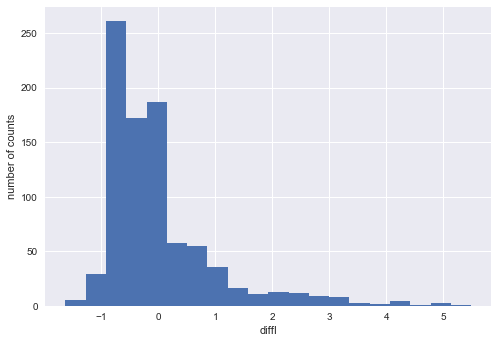

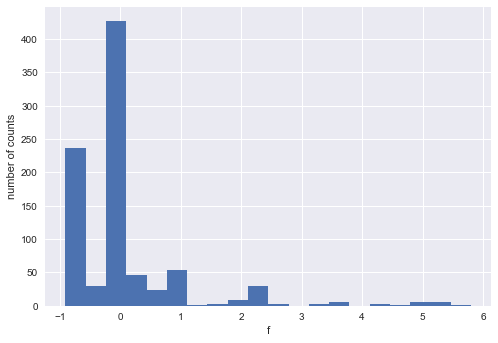

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


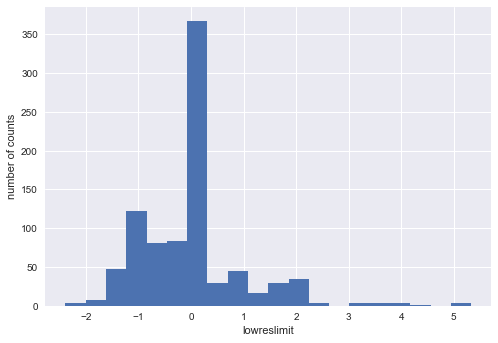

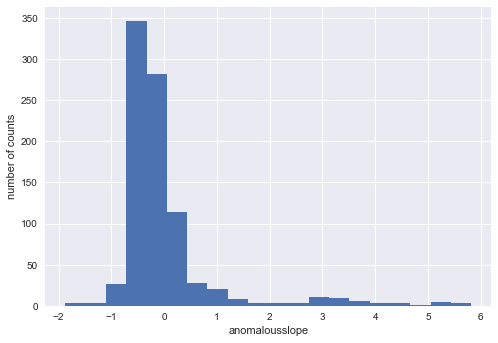

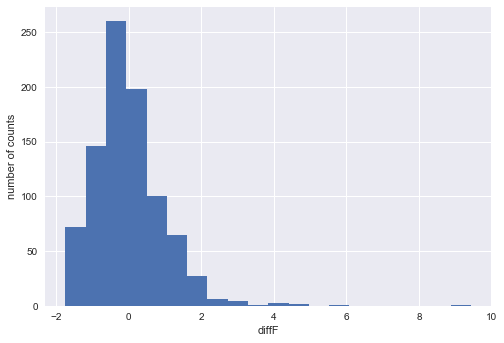

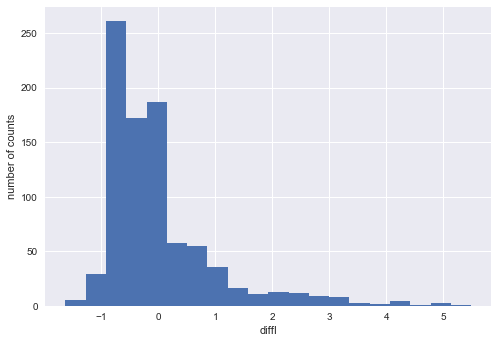

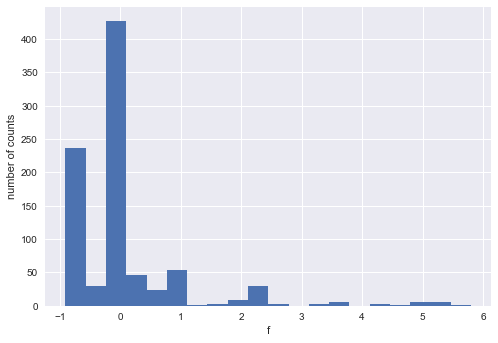

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


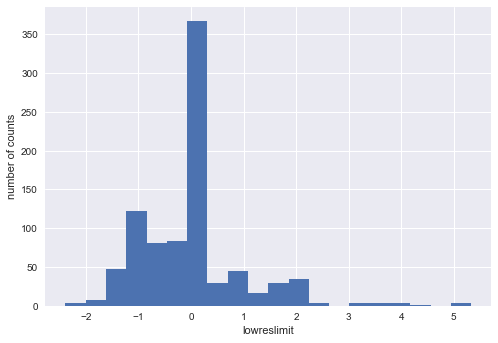

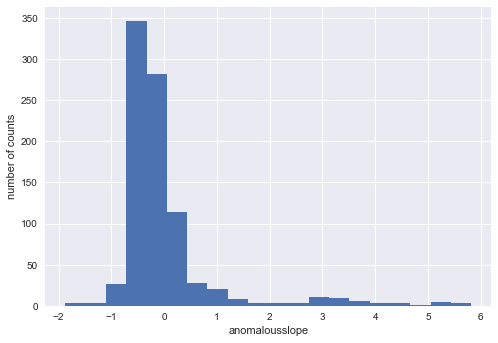

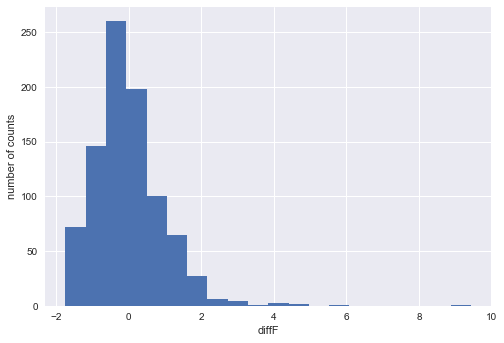

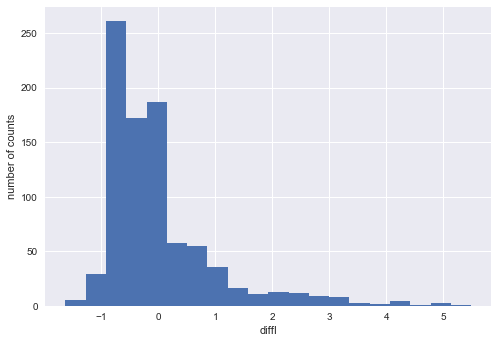

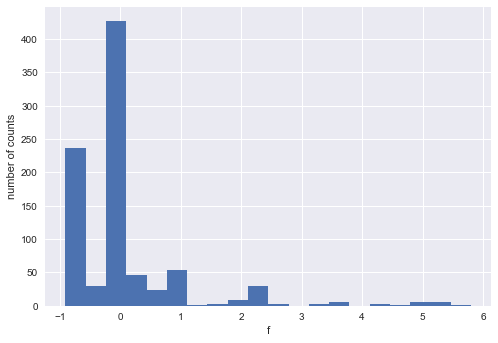

################################################################################
######################## subsets of training data without phasing results DIALS ########################
################################################################################
********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


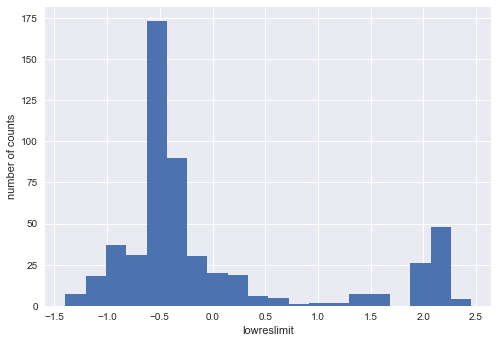

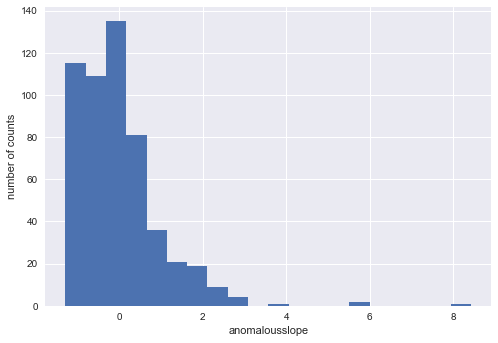

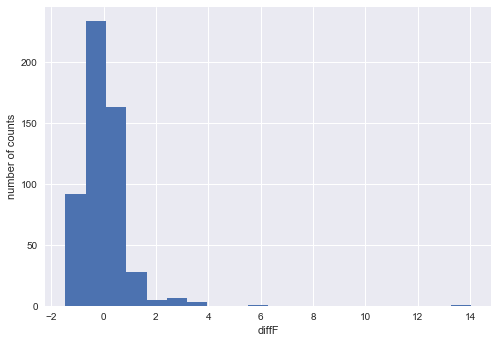

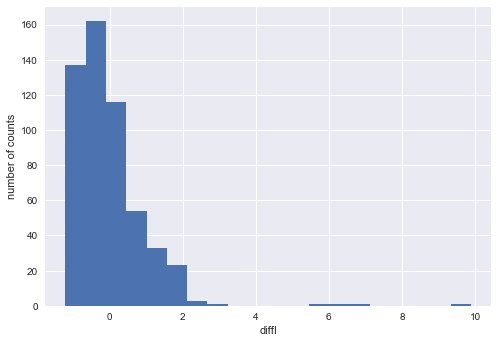

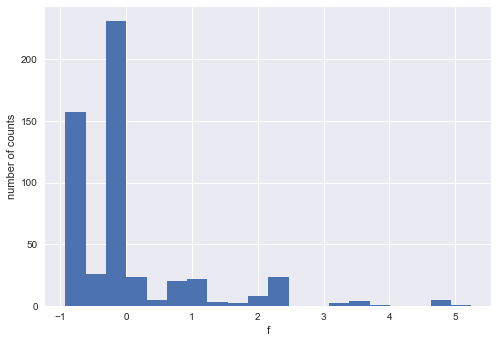

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


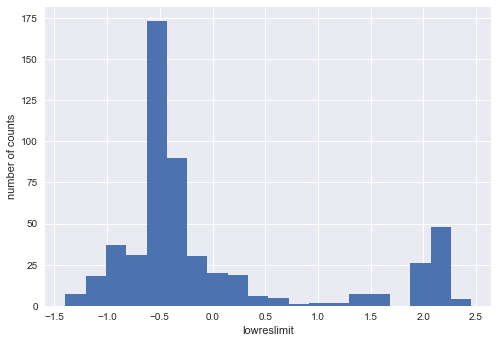

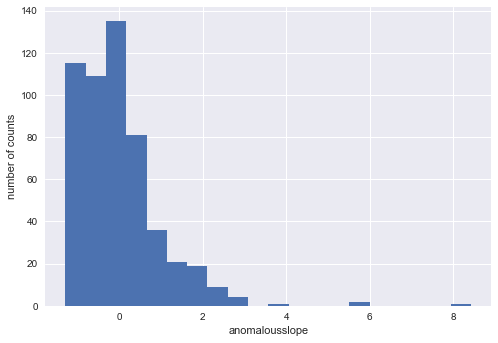

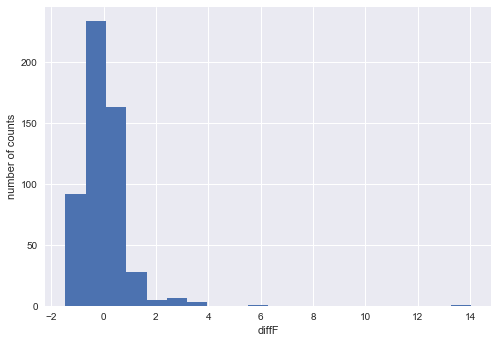

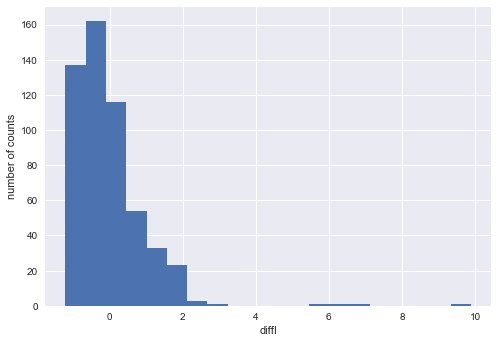

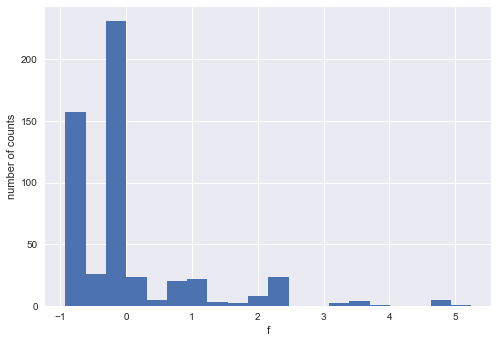

********************************************************************************
*    Plotting histogram for each feature
********************************************************************************


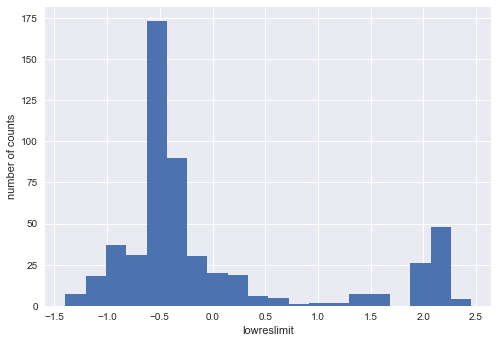

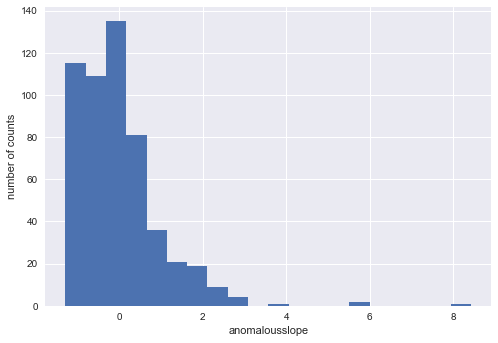

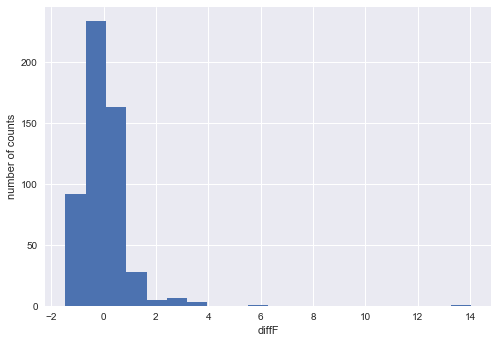

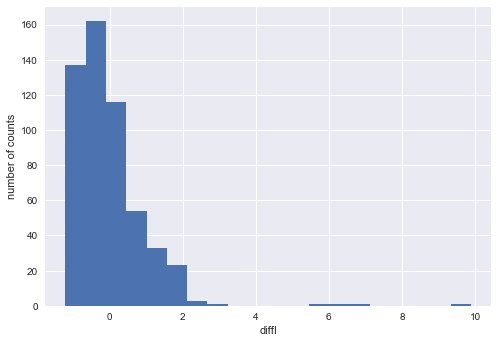

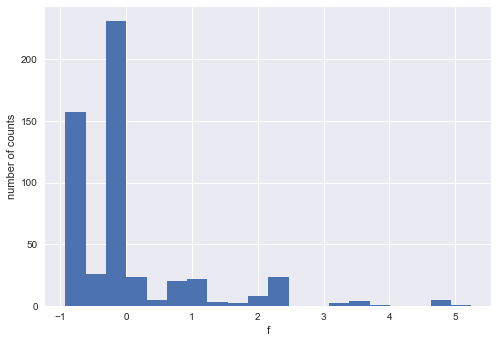

In [65]:
def plot_feature_hist(dataframe):
    '''Plot a histogram for each feature.'''
    print('*' *80)
    print('*    Plotting histogram for each feature')
    print('*' *80)
    
    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    itter = dataframe.columns

    for name in itter[1:]:
        hist = plt.hist(dataframe[name], bins=20)
        hist = plt.xlabel(name)
        hist = plt.ylabel('number of counts')
        plt.show()
        #plt.savefig(os.path.join(self.output_dir,
        #              'histogram_feature_'+name+'_'+datestring+'.png'), dpi=600)
        plt.close()

        
print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_hist(X_3dii_train)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
plot_feature_hist(X_dials_train)


print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_hist(X_3dii_train_std)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
plot_feature_hist(X_dials_train_std)


print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_X_3dii_train_df)
plot_feature_hist(crank2_X_3dii_train_df)
plot_feature_hist(autosharp_X_3dii_train_df)
print(80 * "#")
print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_X_dials_train_df)
plot_feature_hist(crank2_X_dials_train_df)
plot_feature_hist(autosharp_X_dials_train_df)
print(80 * "#")
print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_noPhase_X_3dii_train_df)
plot_feature_hist(crank2_noPhase_X_3dii_train_df)
plot_feature_hist(autosharp_noPhase_X_3dii_train_df)
print(80 * "#")
print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_noPhase_X_dials_train_df)
plot_feature_hist(crank2_noPhase_X_dials_train_df)
plot_feature_hist(autosharp_noPhase_X_dials_train_df)




print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_X_3dii_train_std_df)
plot_feature_hist(crank2_X_3dii_train_std_df)
plot_feature_hist(autosharp_X_3dii_train_std_df)
print(80 * "#")
print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_X_dials_train_std_df)
plot_feature_hist(crank2_X_dials_train_std_df)
plot_feature_hist(autosharp_X_dials_train_std_df)
print(80 * "#")
print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_noPhase_X_3dii_train_std_df)
plot_feature_hist(crank2_noPhase_X_3dii_train_std_df)
plot_feature_hist(autosharp_noPhase_X_3dii_train_std_df)
print(80 * "#")
print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_hist(autobuild_noPhase_X_dials_train_std_df)
plot_feature_hist(crank2_noPhase_X_dials_train_std_df)
plot_feature_hist(autosharp_noPhase_X_dials_train_std_df)




################################################################################
############################# unstandardised data ############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


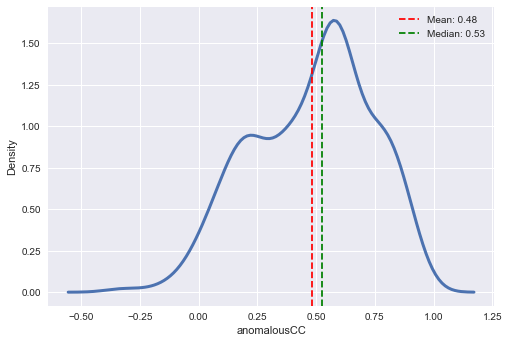

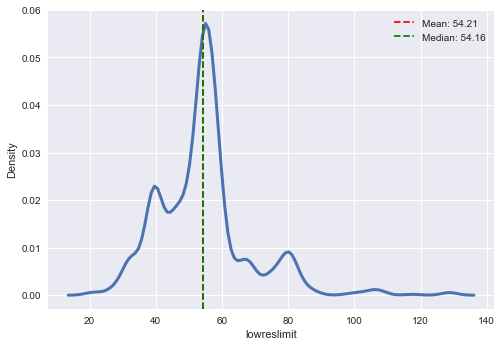

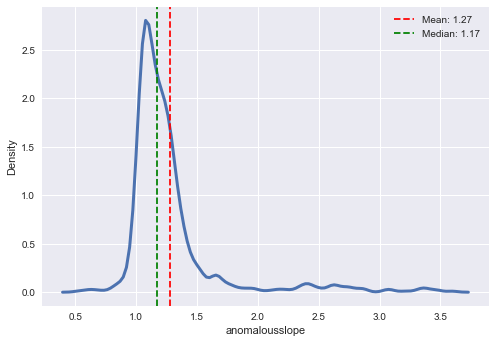

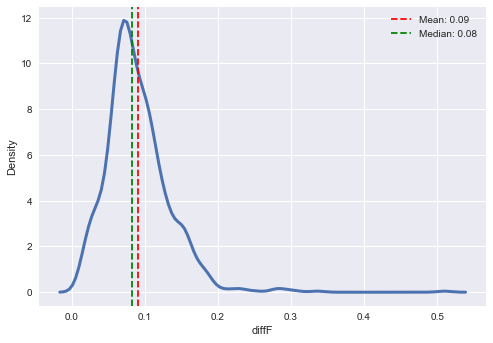

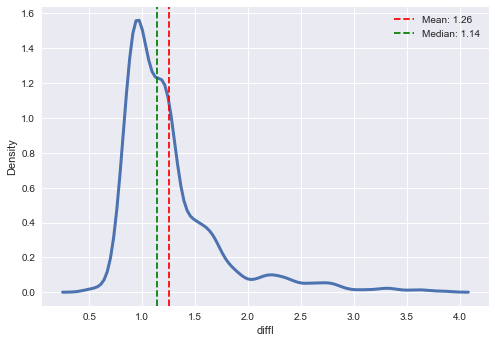

...

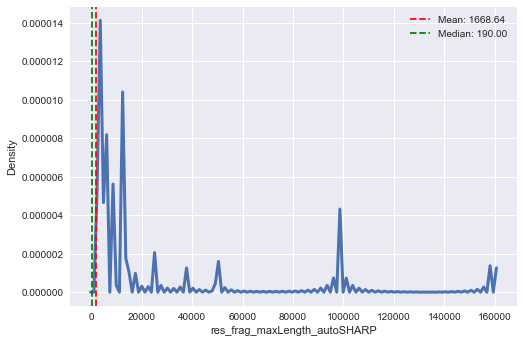

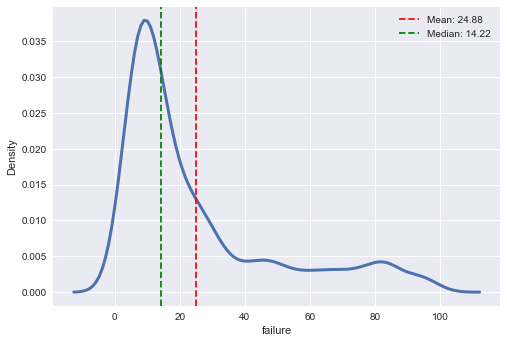

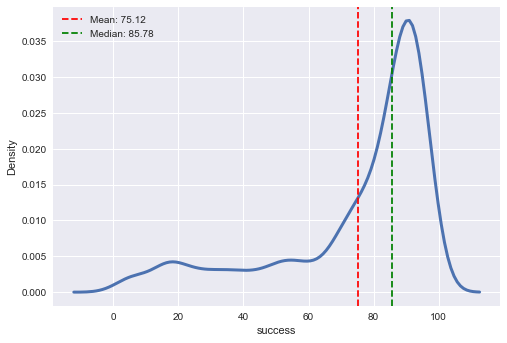

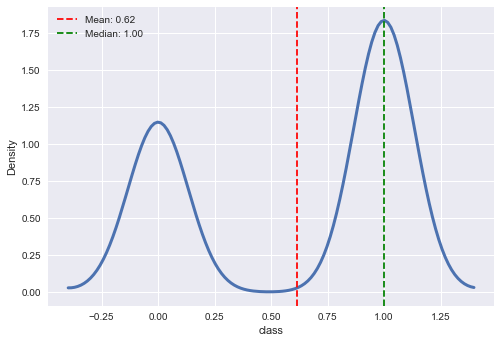

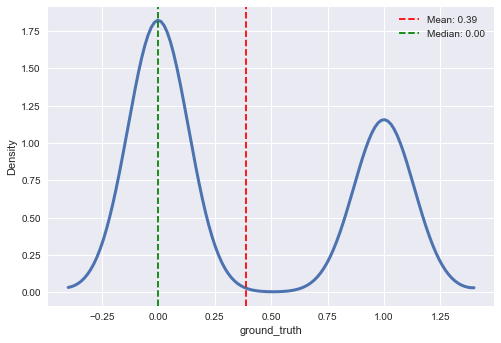

################################################################################
########################### full training data DIALS ###########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


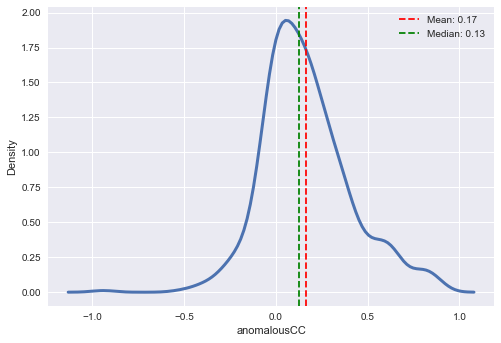

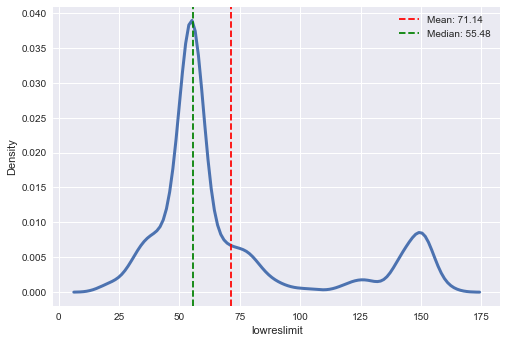

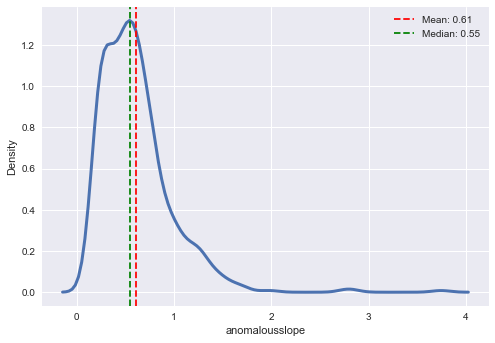

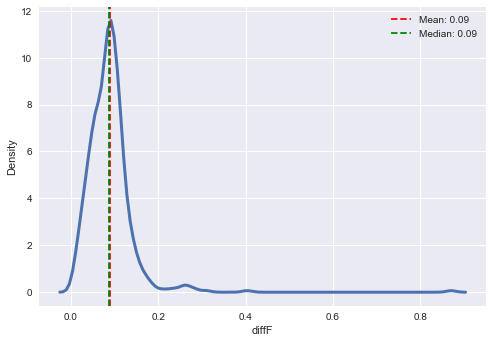

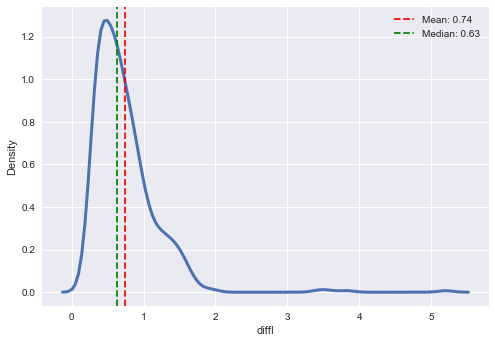

...

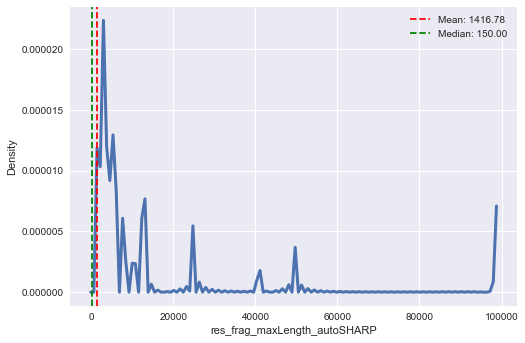

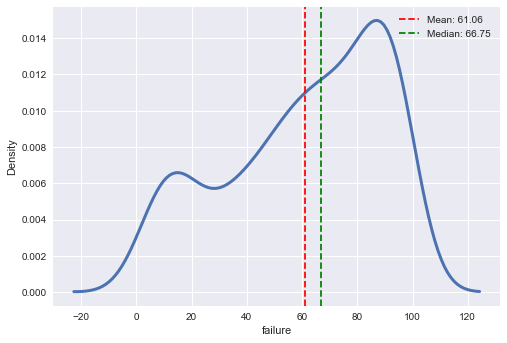

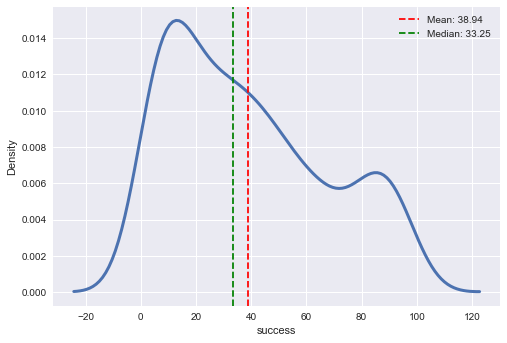

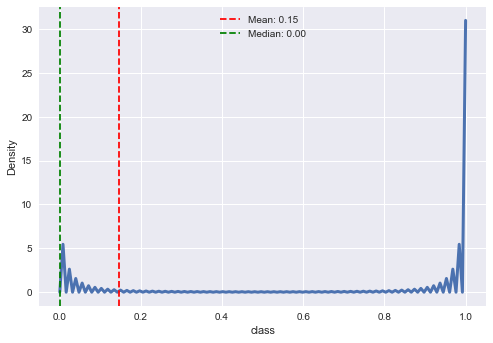

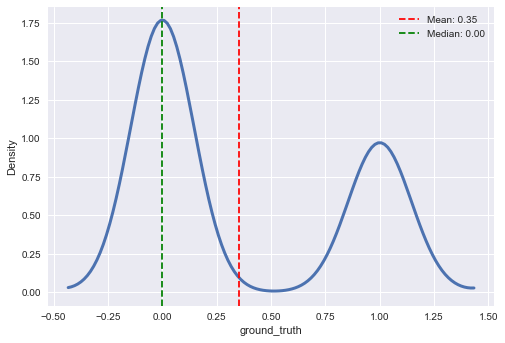

################################################################################
############################## standardised data #############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


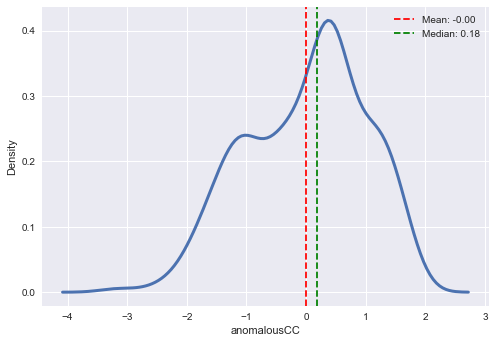

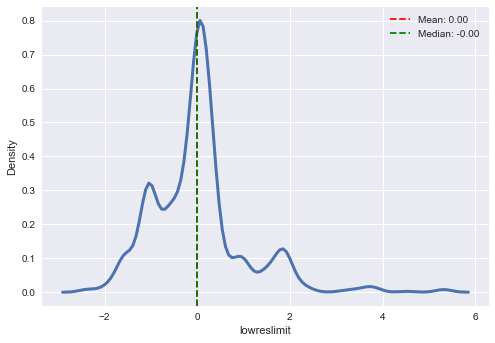

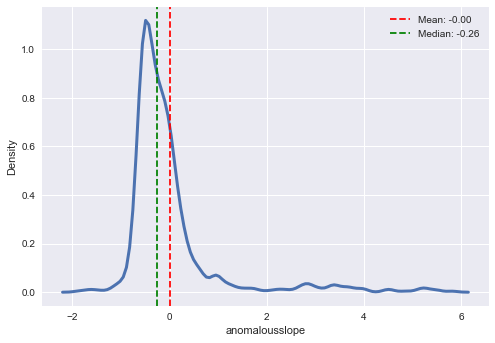

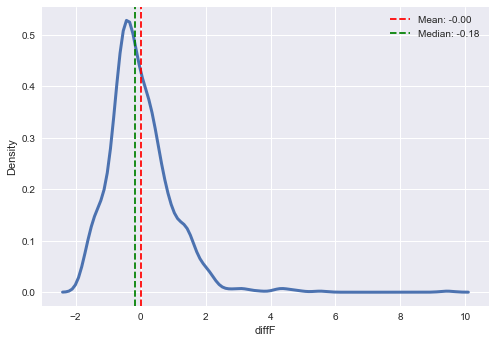

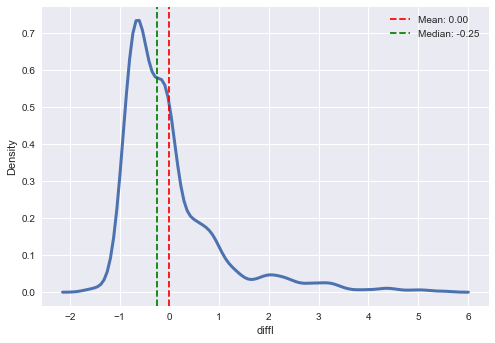

...

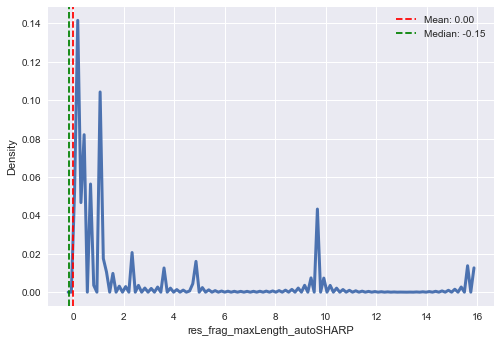

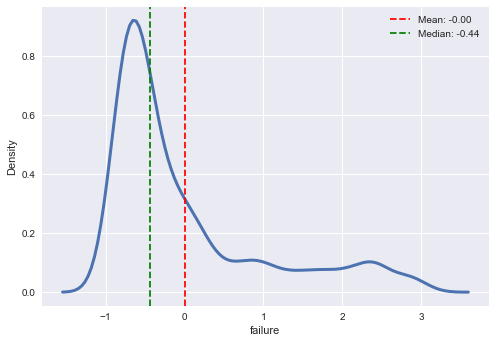

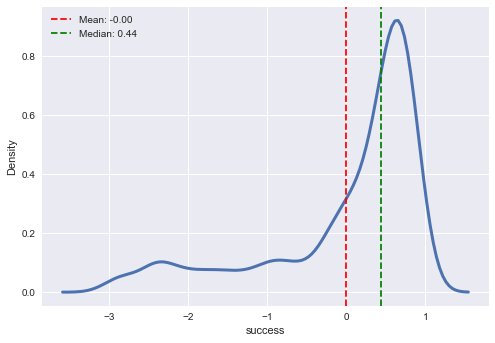

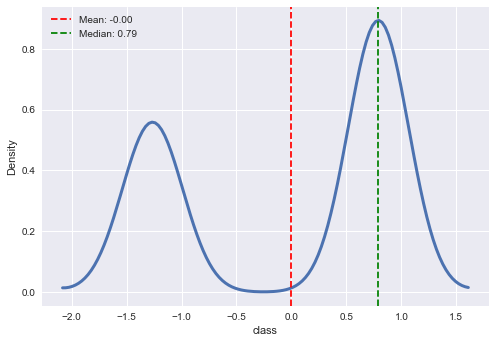

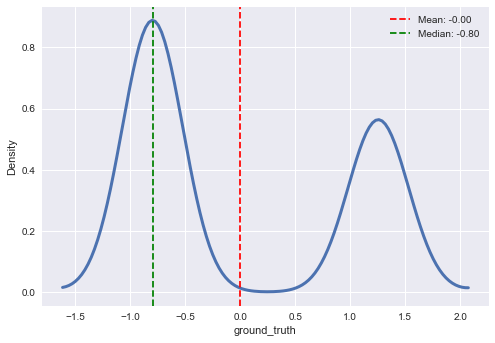

################################################################################
########################### full training data DIALS ###########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


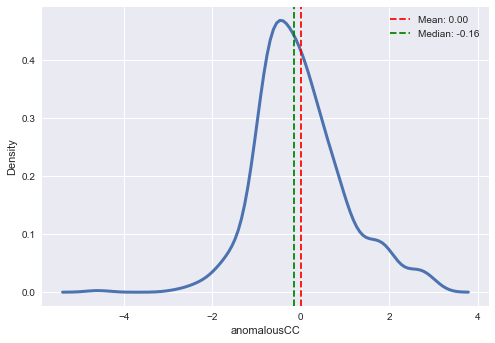

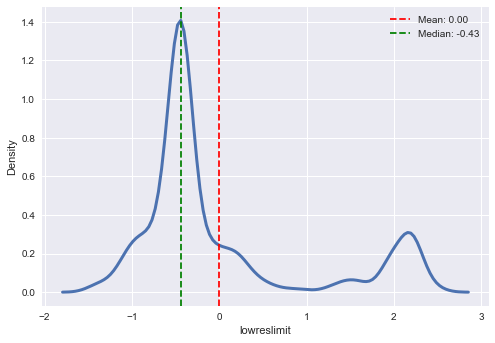

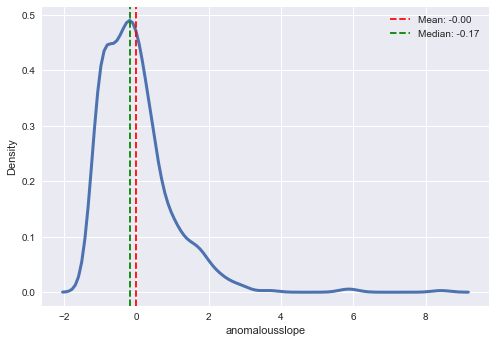

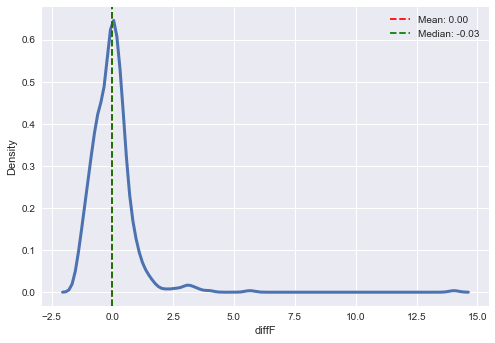

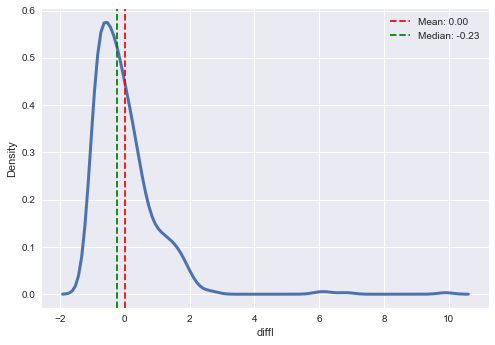

...

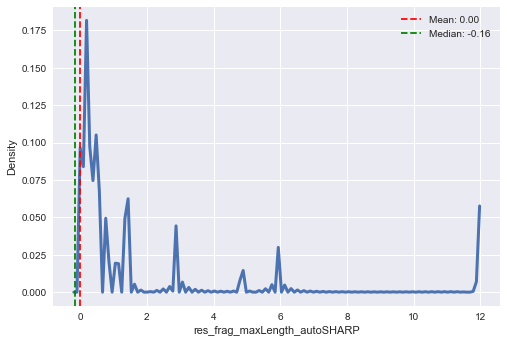

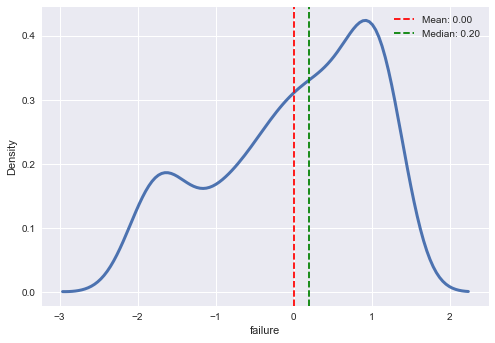

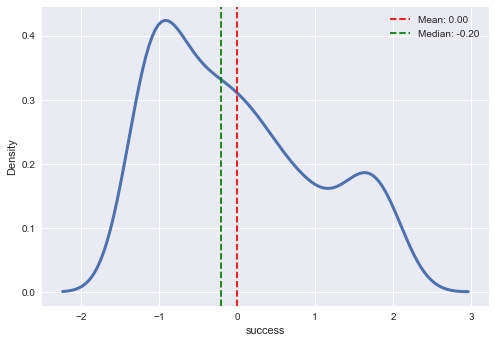

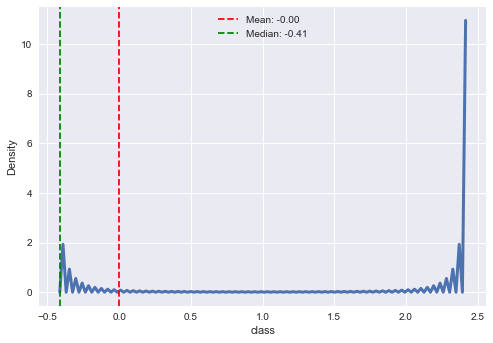

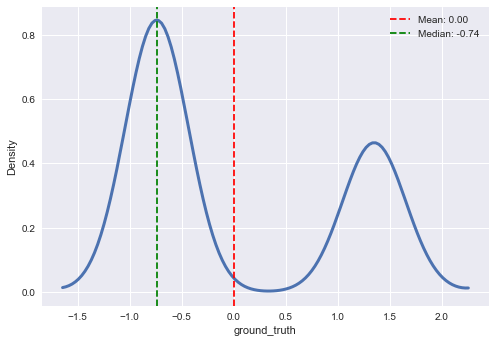

################################################################################
############################# unstandardised data ############################
################################################################################
######################### subsets of training data 3dii ########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


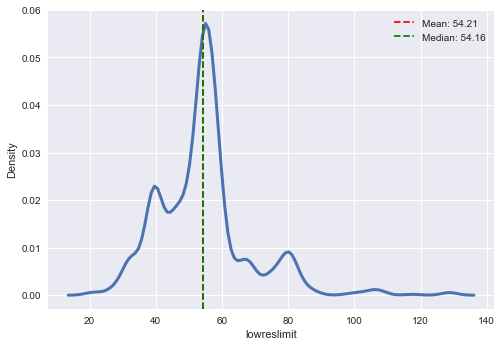

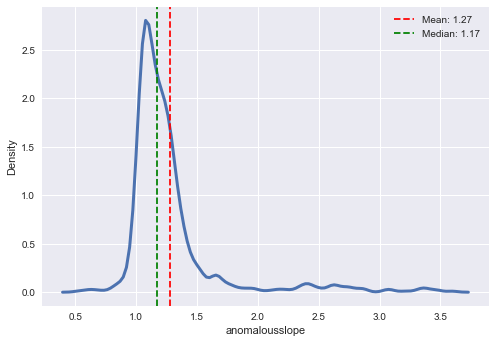

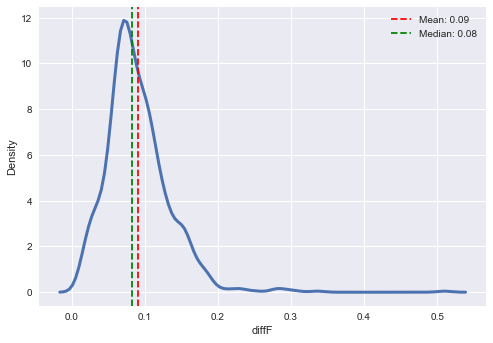

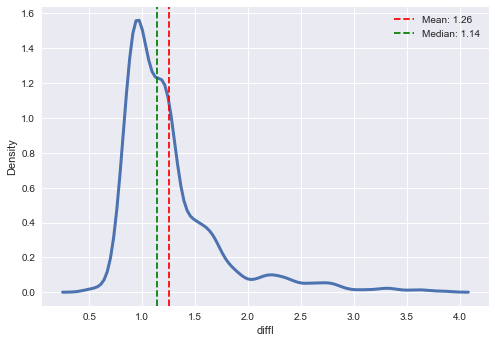

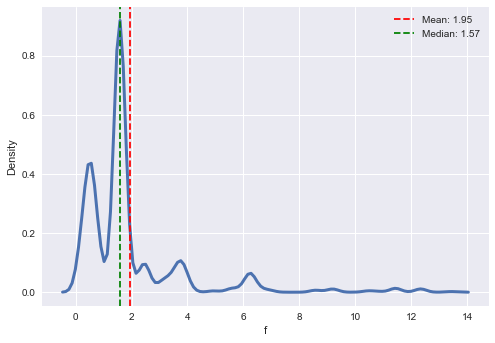

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


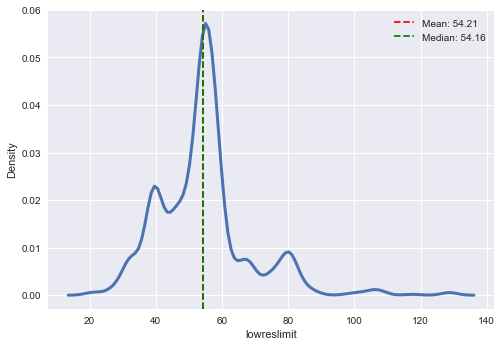

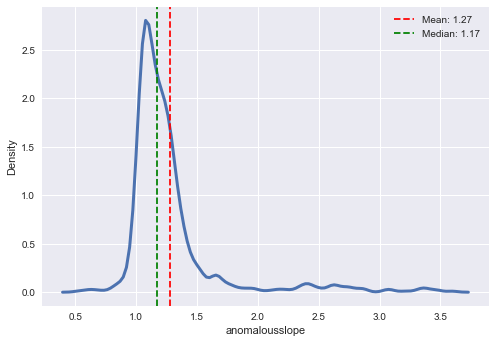

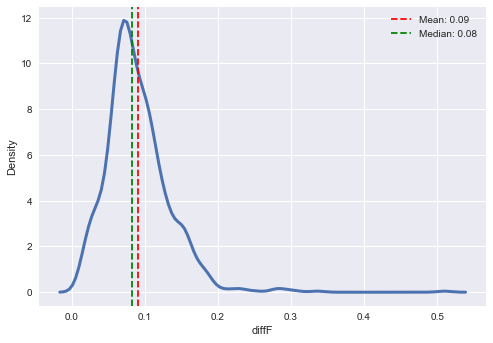

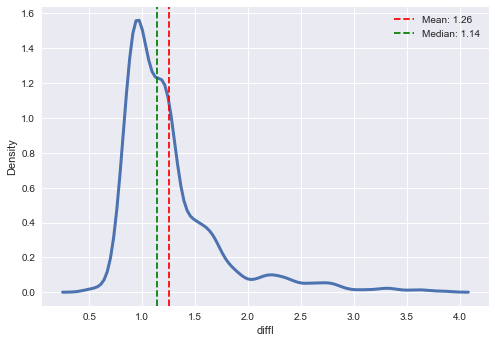

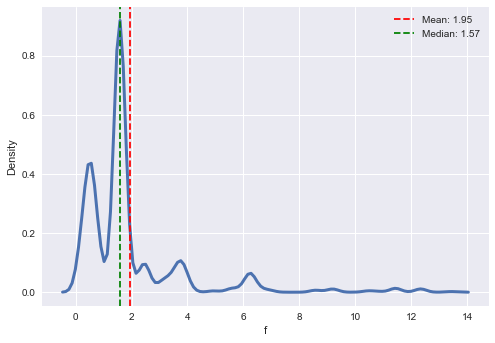

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


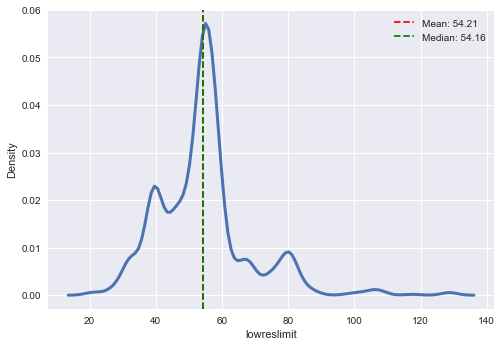

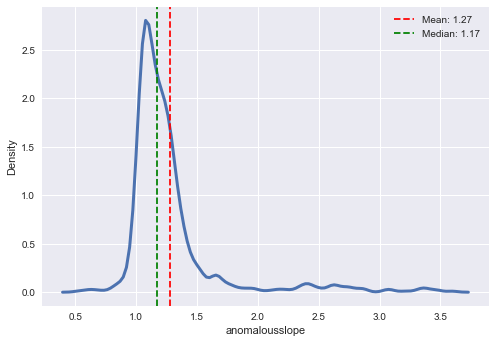

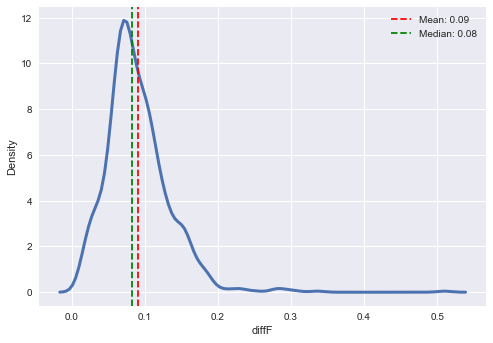

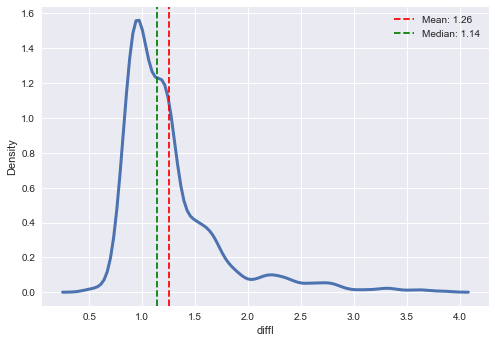

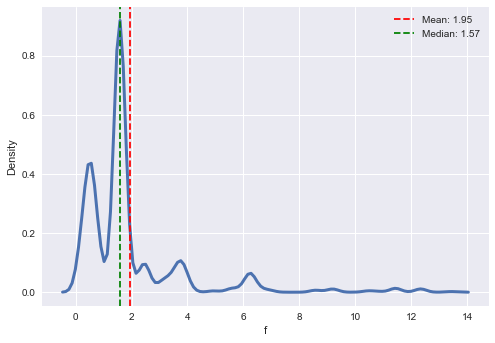

################################################################################
######################## subsets of training data DIALS ########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


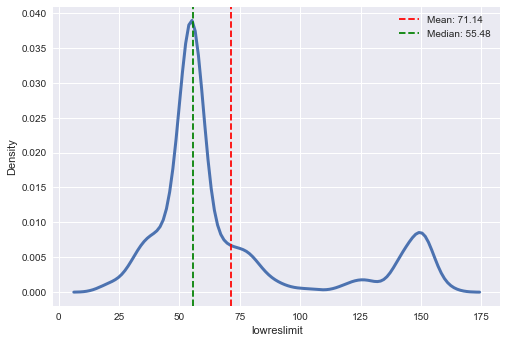

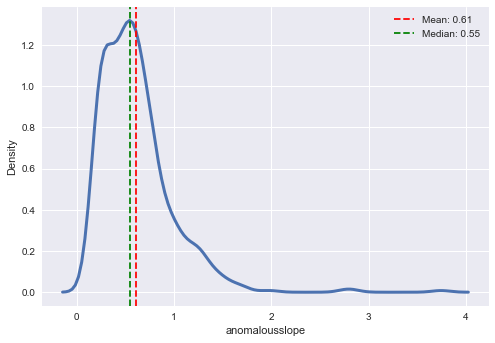

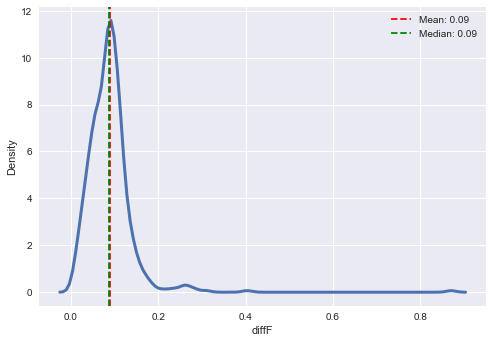

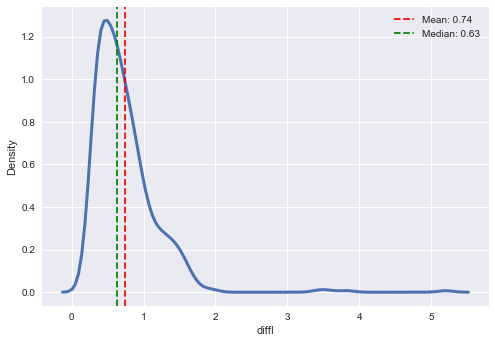

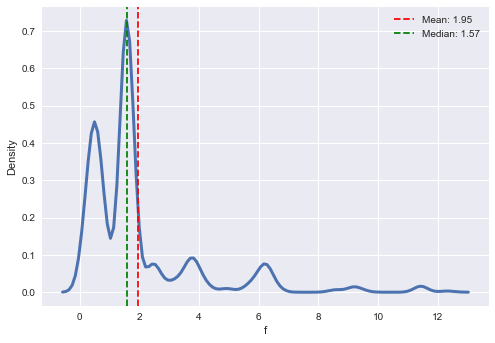

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


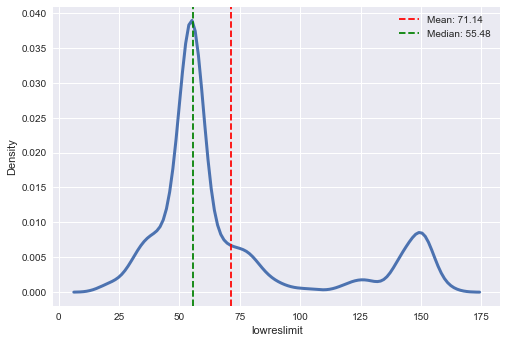

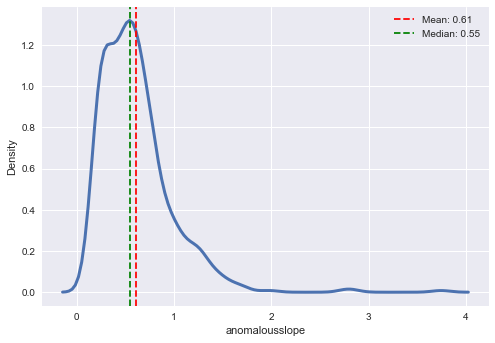

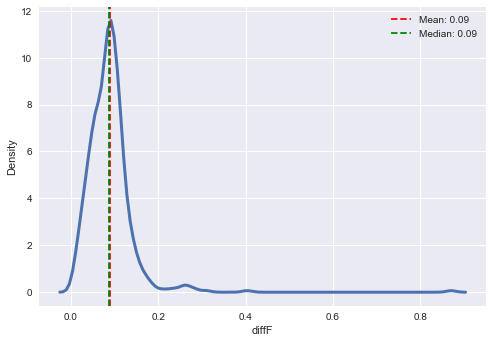

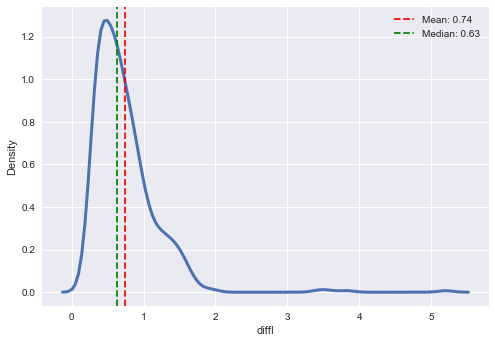

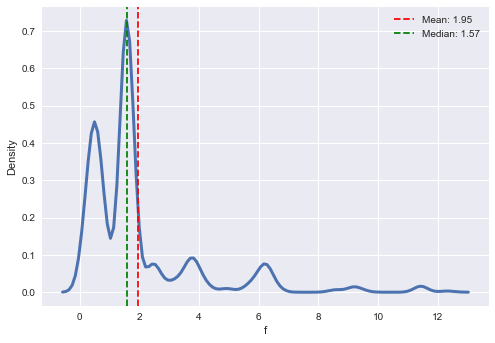

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


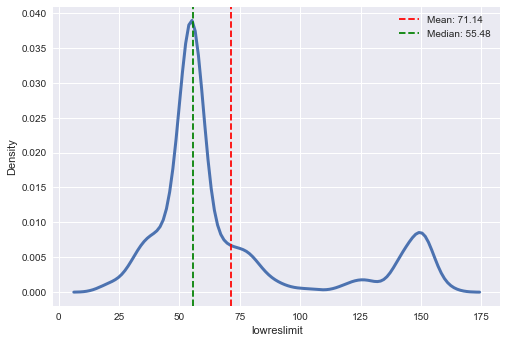

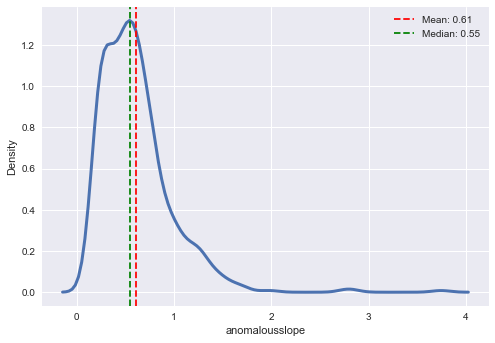

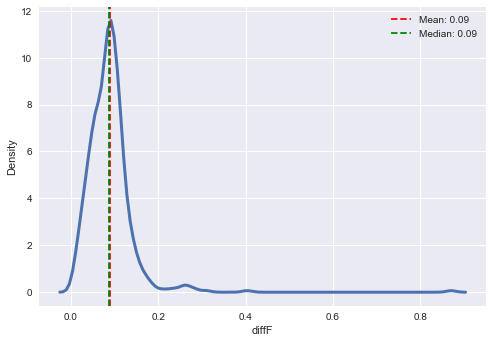

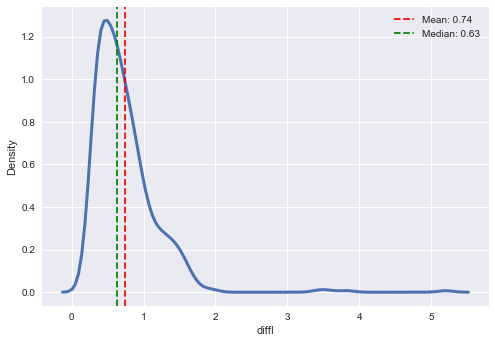

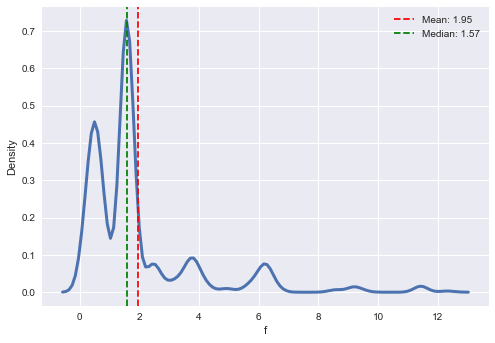

################################################################################
############################## standardised data #############################
################################################################################
######################### subsets of training data 3dii ########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


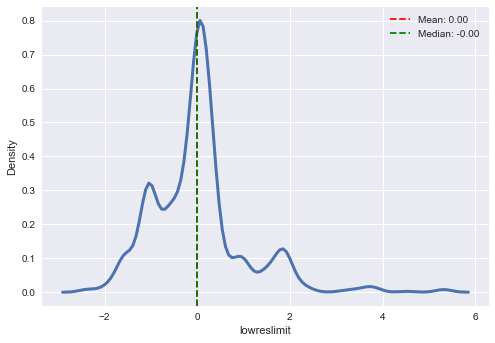

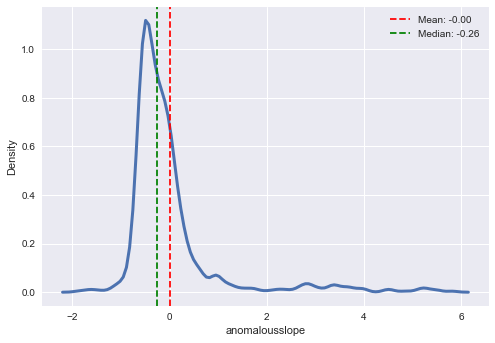

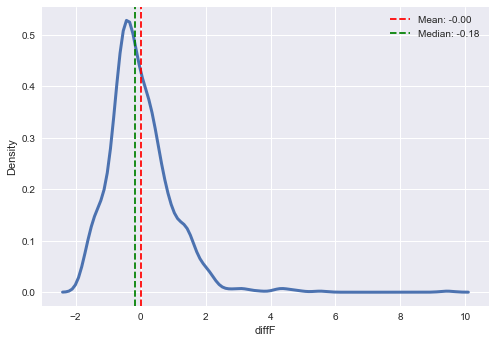

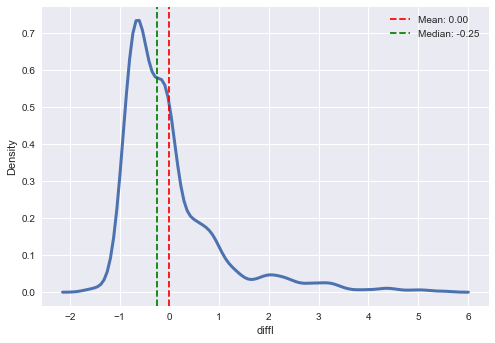

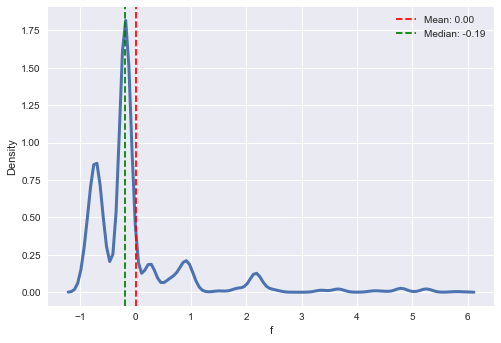

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


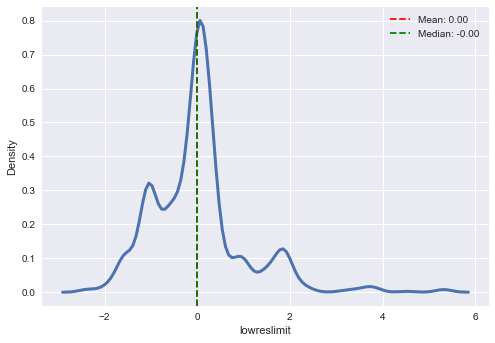

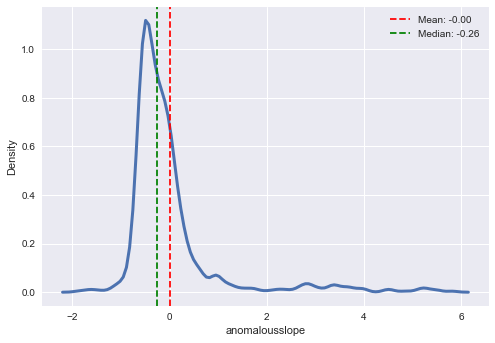

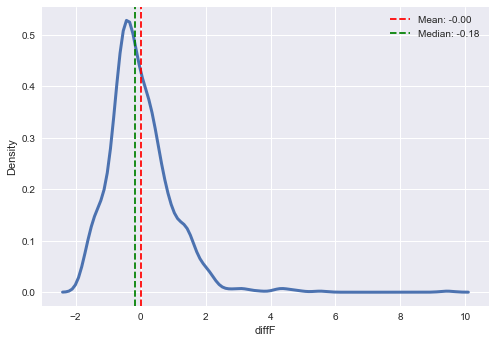

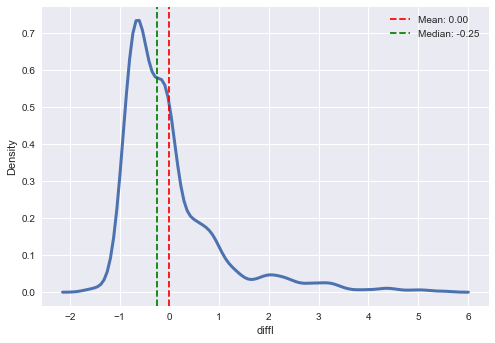

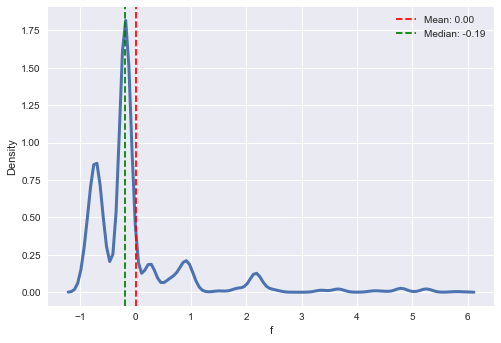

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


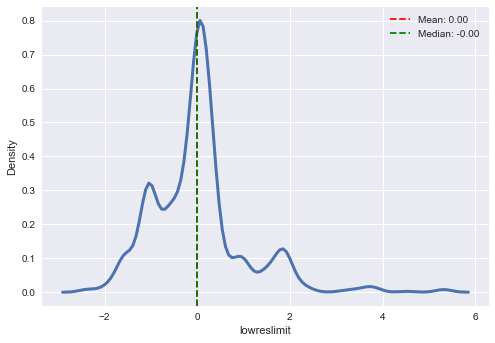

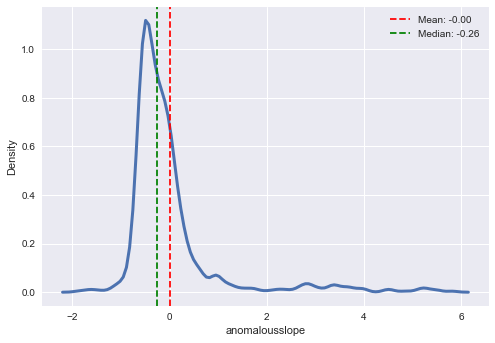

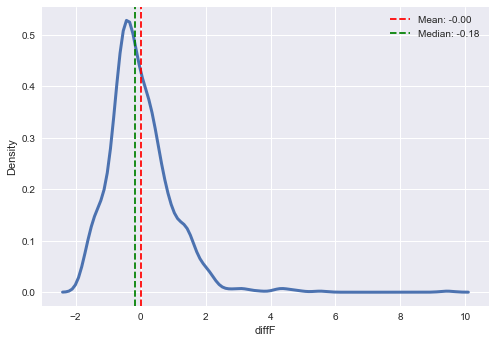

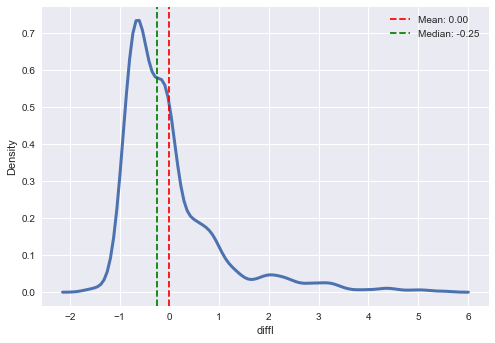

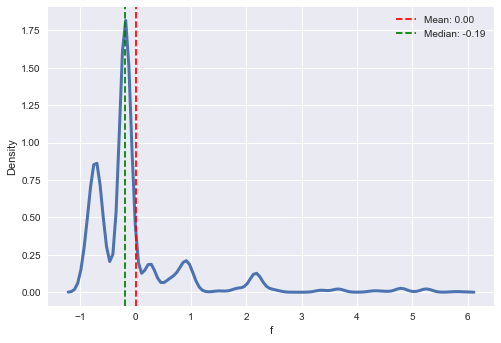

################################################################################
######################## subsets of training data DIALS ########################
################################################################################
********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


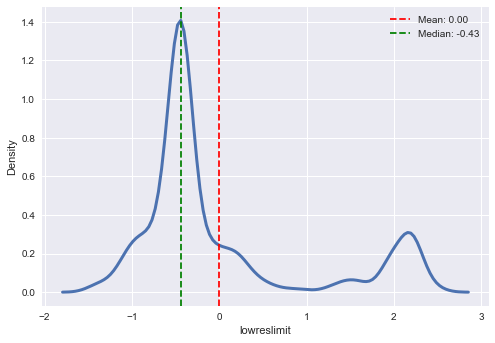

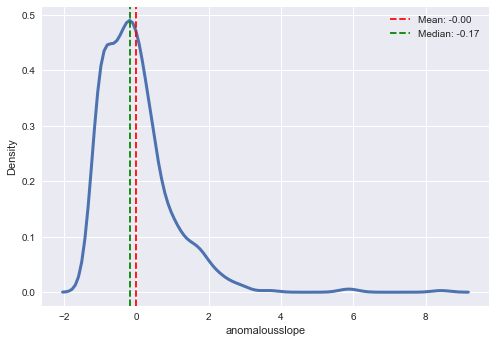

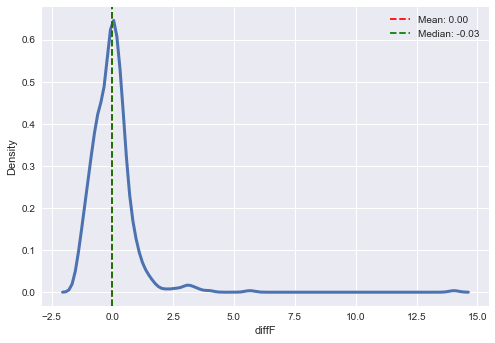

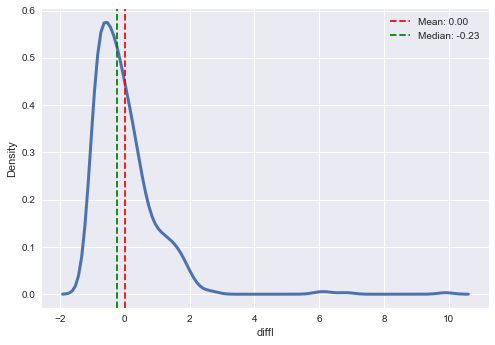

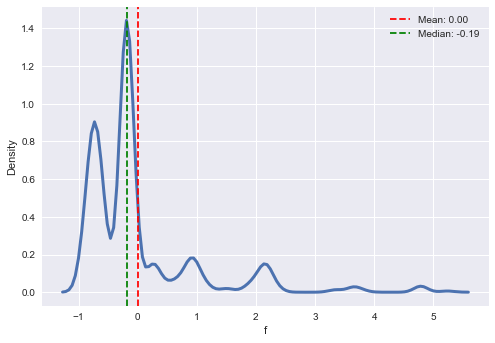

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


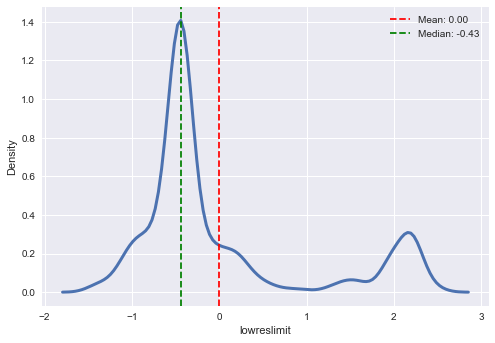

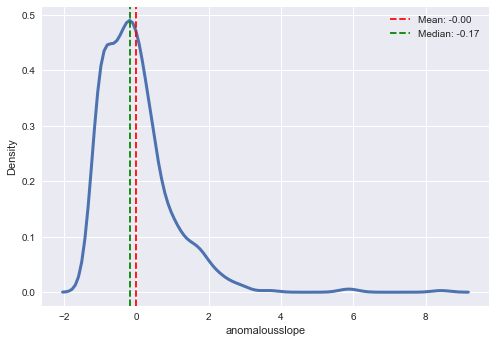

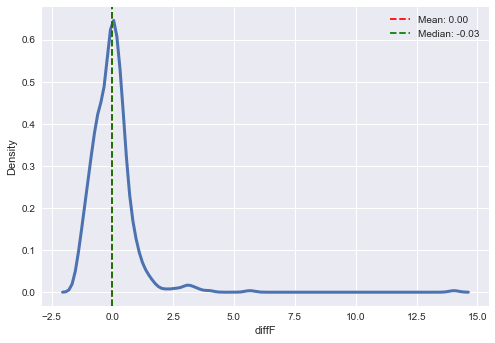

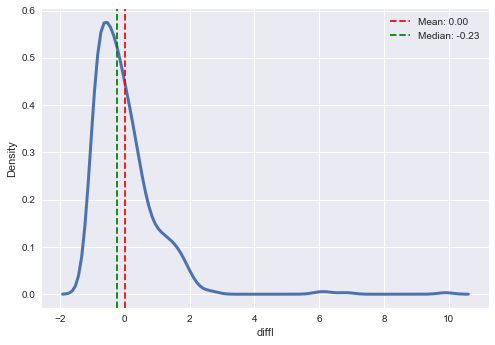

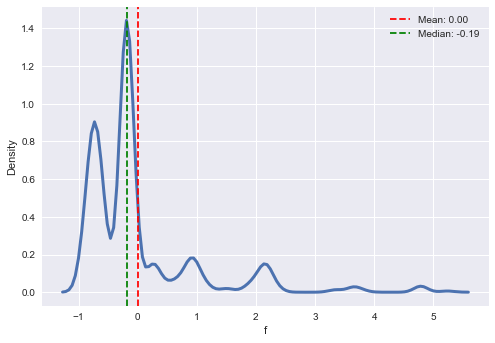

********************************************************************************
*    Plotting density curve for each feature
********************************************************************************


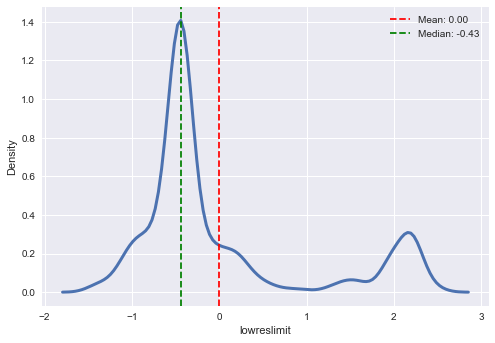

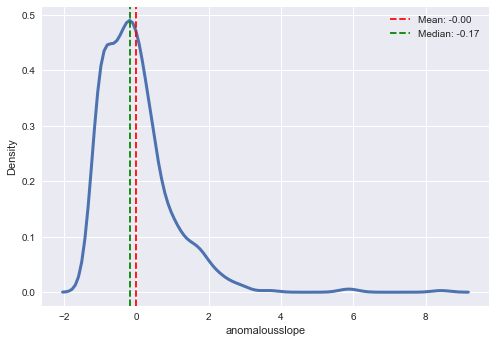

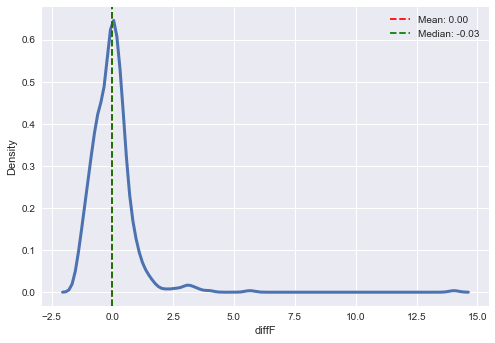

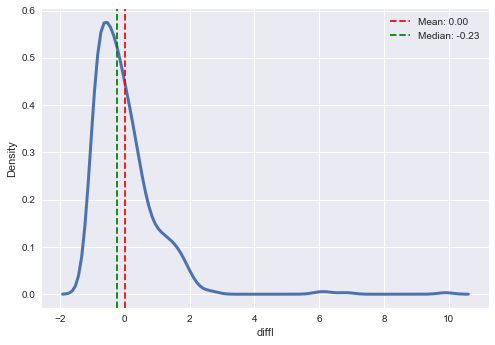

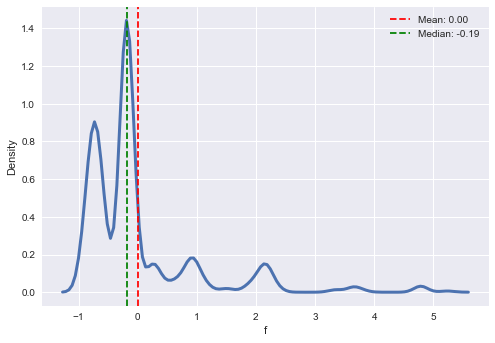

In [63]:
def plot_feature_pdf(dataframe):
    '''Plot probability density function (PDF) for each feature.'''
    print('*' *80)
    print('*    Plotting density curve for each feature')
    print('*' *80)

    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    itter = dataframe.columns
    
    for name in itter[1:]:
        '''Compute ECDF for a one-dimensional array of measurements'''
        mean = np.mean(dataframe[name])
        median = np.median(dataframe[name])

        mean_label = "Mean: %.2f" %mean
        median_label = "Median: %.2f" %median

        sns.distplot(dataframe[name], hist = False, kde = True,
                 kde_kws = {'linewidth': 3})  
        plt.axvline(mean, label=mean_label, color='r', linestyle='--')  
        plt.axvline(median, label=median_label, color='g', linestyle='--')
        plt.legend(loc='best')
        plt.xlabel(name)
        plt.ylabel('Density')
        plt.show()
        #plt.savefig(os.path.join(self.output_dir,
        #                'Density_feature_'+name+'_'+datestring+'.png'), dpi=600)
        plt.close()

print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_pdf(X_3dii_train)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
plot_feature_pdf(X_dials_train)


print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_pdf(X_3dii_train_std)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
plot_feature_pdf(X_dials_train_std)


print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_X_3dii_train_df)
plot_feature_pdf(crank2_X_3dii_train_df)
plot_feature_pdf(autosharp_X_3dii_train_df)
print(80 * "#")
print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_X_dials_train_df)
plot_feature_pdf(crank2_X_dials_train_df)
plot_feature_pdf(autosharp_X_dials_train_df)
print(80 * "#")
print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_noPhase_X_3dii_train_df)
plot_feature_pdf(crank2_noPhase_X_3dii_train_df)
plot_feature_pdf(autosharp_noPhase_X_3dii_train_df)
print(80 * "#")
print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_noPhase_X_dials_train_df)
plot_feature_pdf(crank2_noPhase_X_dials_train_df)
plot_feature_pdf(autosharp_noPhase_X_dials_train_df)




print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_X_3dii_train_std_df)
plot_feature_pdf(crank2_X_3dii_train_std_df)
plot_feature_pdf(autosharp_X_3dii_train_std_df)
print(80 * "#")
print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_X_dials_train_std_df)
plot_feature_pdf(crank2_X_dials_train_std_df)
plot_feature_pdf(autosharp_X_dials_train_std_df)
print(80 * "#")
print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_noPhase_X_3dii_train_std_df)
plot_feature_pdf(crank2_noPhase_X_3dii_train_std_df)
plot_feature_pdf(autosharp_noPhase_X_3dii_train_std_df)
print(80 * "#")
print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_pdf(autobuild_noPhase_X_dials_train_std_df)
plot_feature_pdf(crank2_noPhase_X_dials_train_std_df)
plot_feature_pdf(autosharp_noPhase_X_dials_train_std_df)

################################################################################
############################# unstandardised data ############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


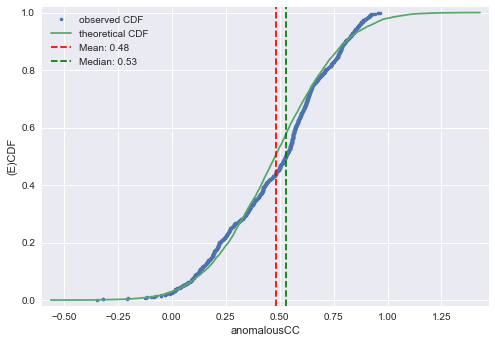

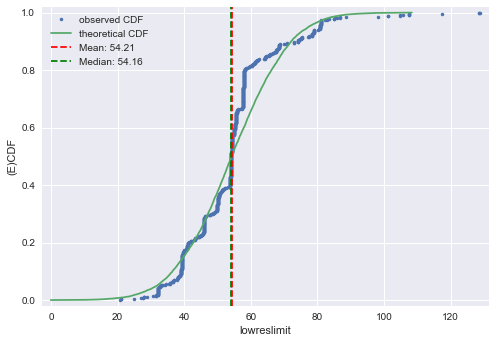

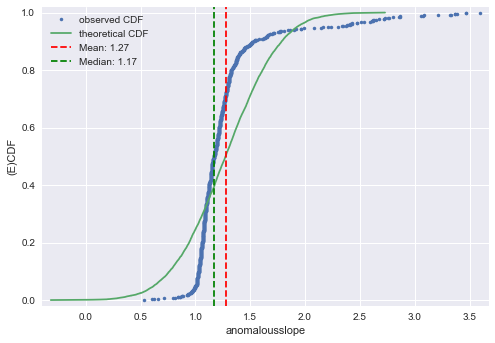

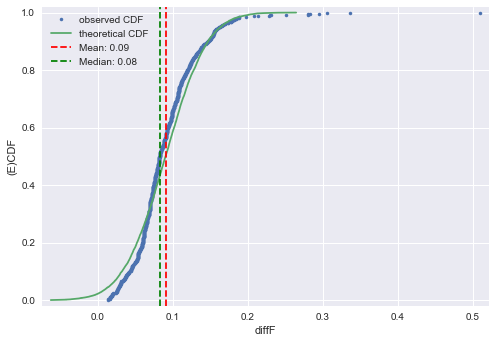

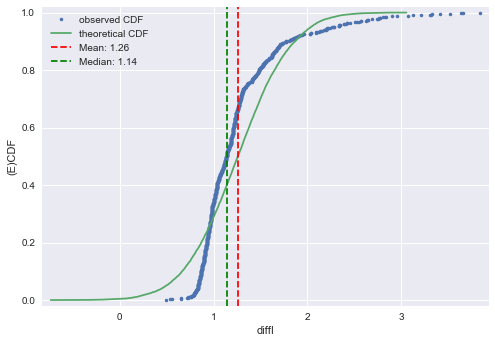

...

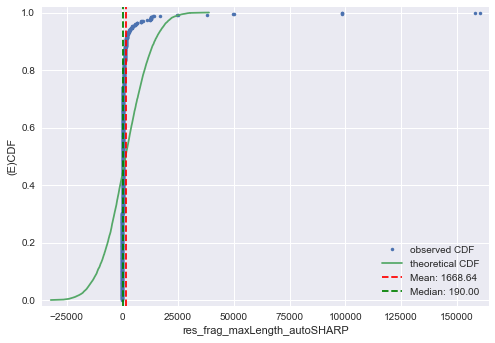

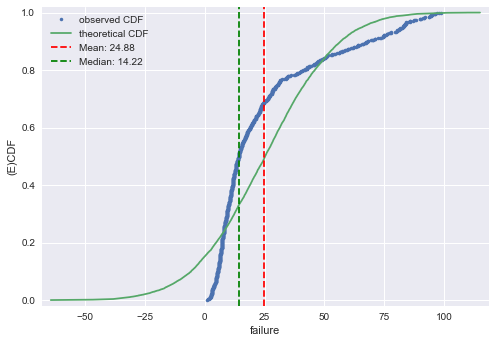

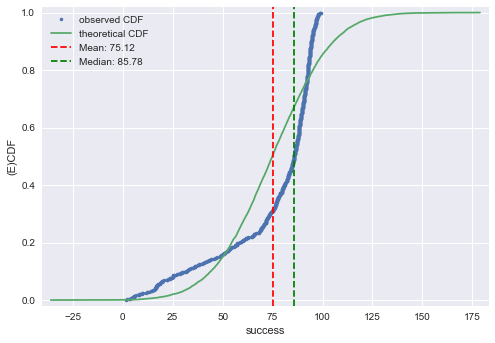

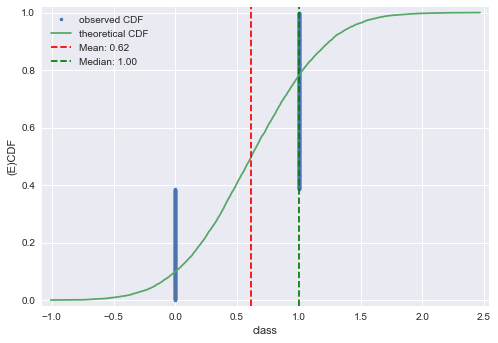

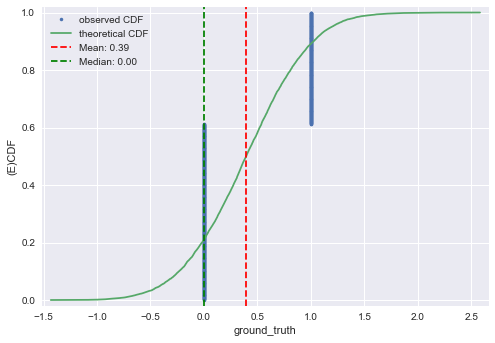

################################################################################
########################### full training data DIALS ###########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


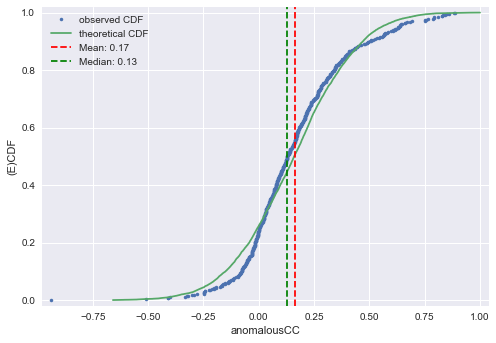

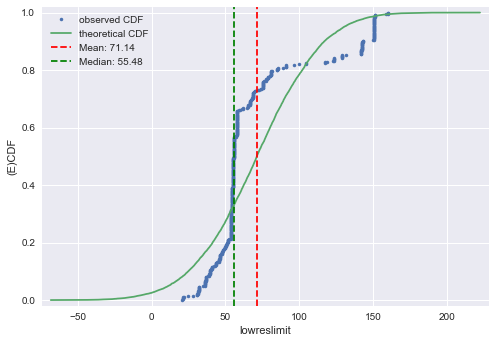

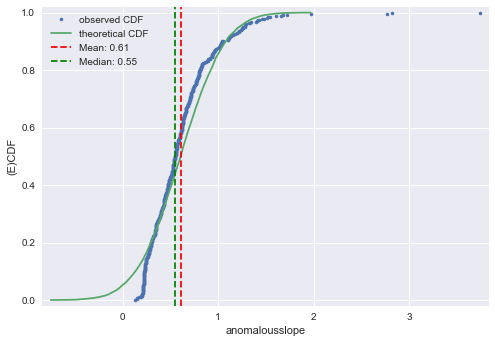

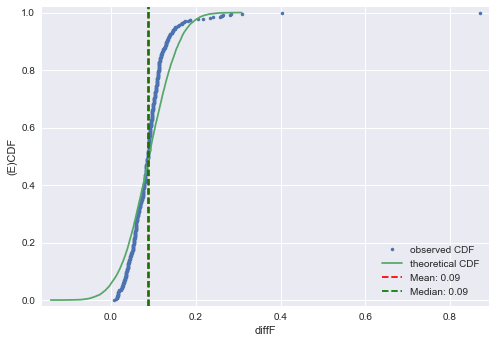

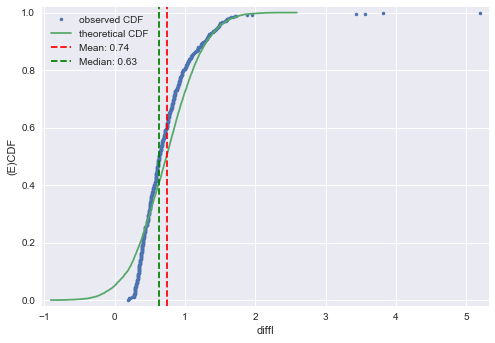

...

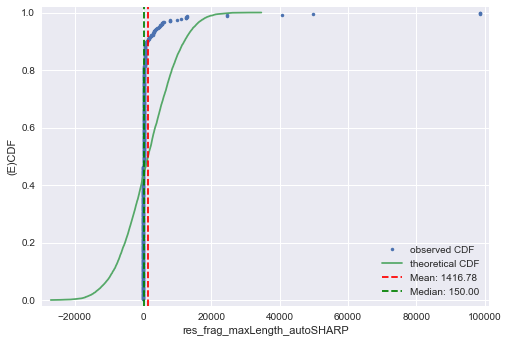

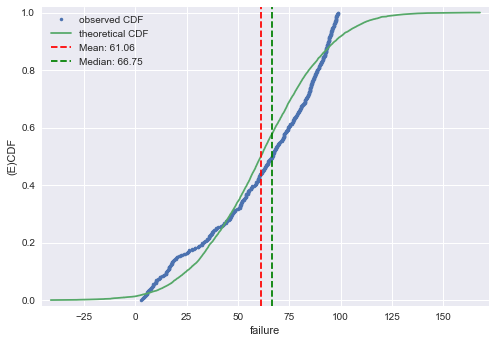

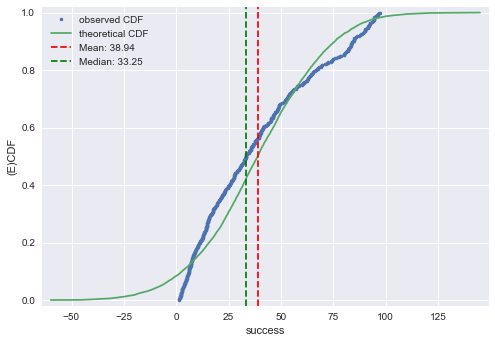

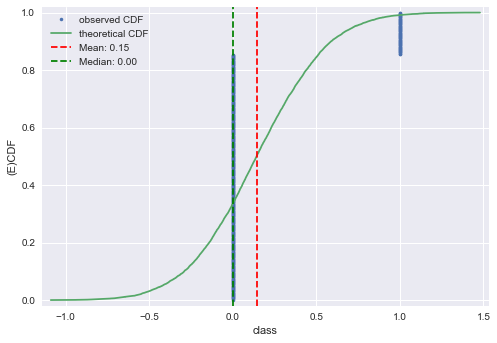

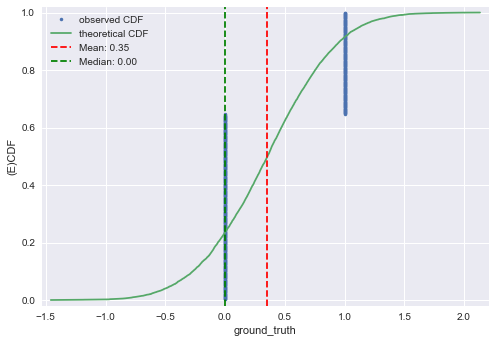

################################################################################
############################## standardised data #############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


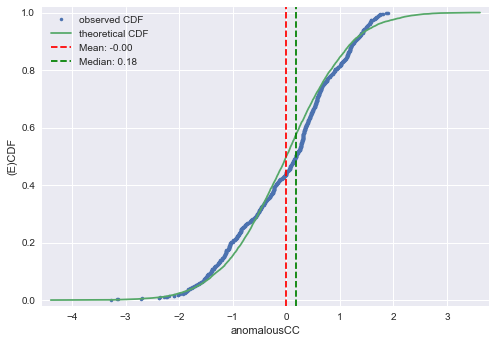

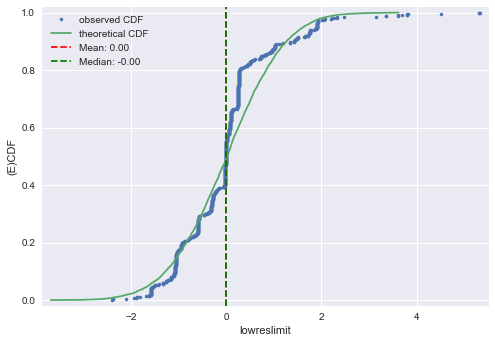

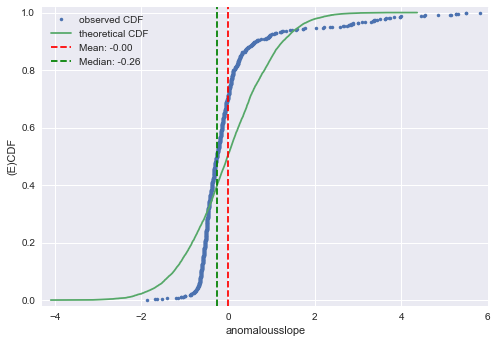

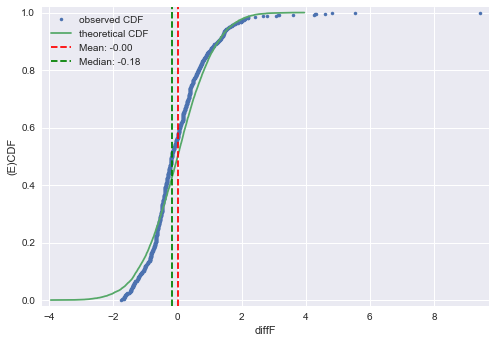

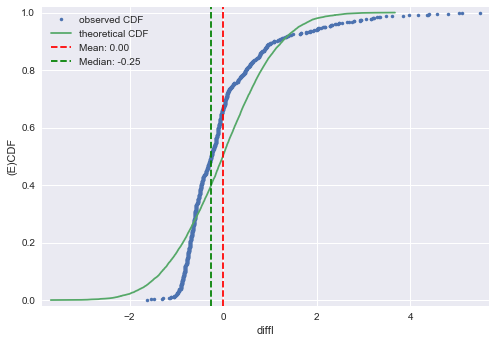

...

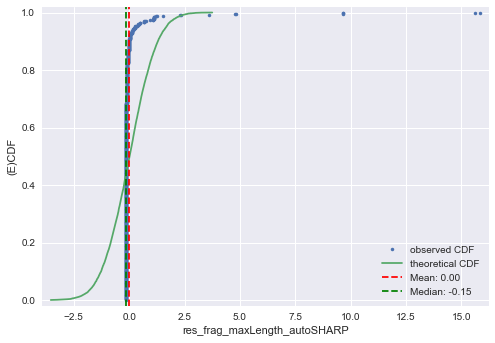

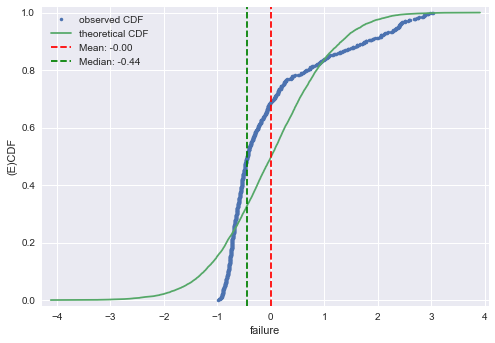

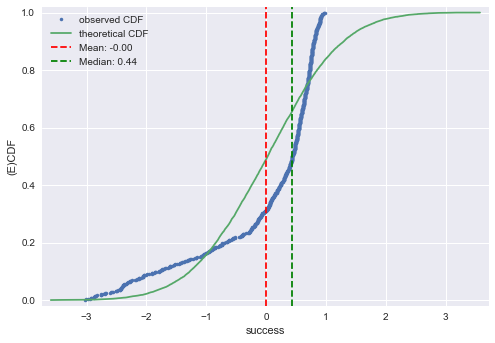

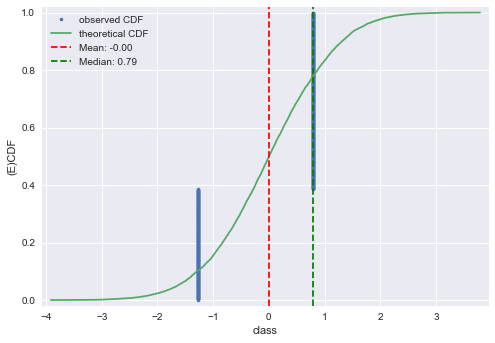

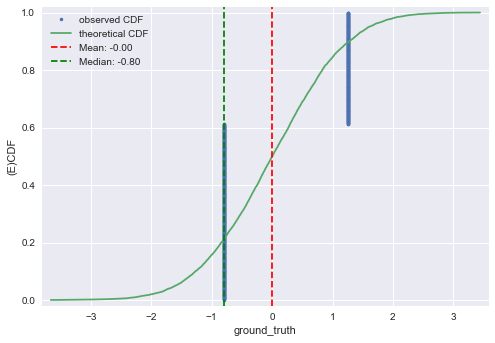

################################################################################
########################### full training data DIALS ###########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


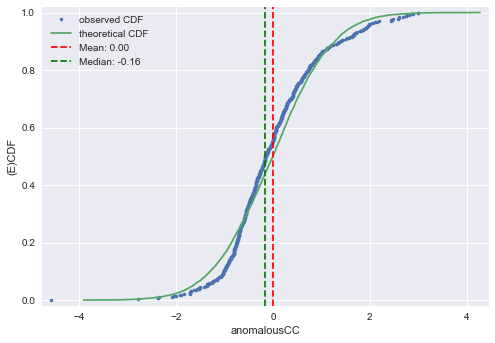

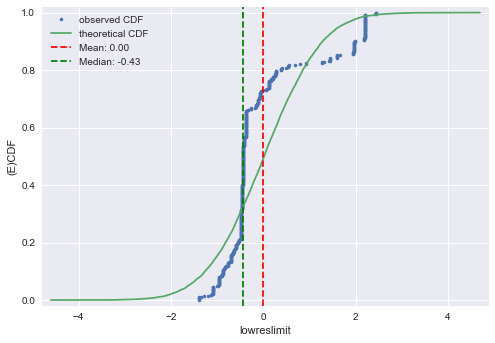

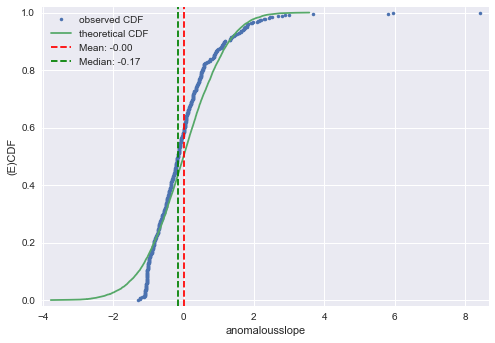

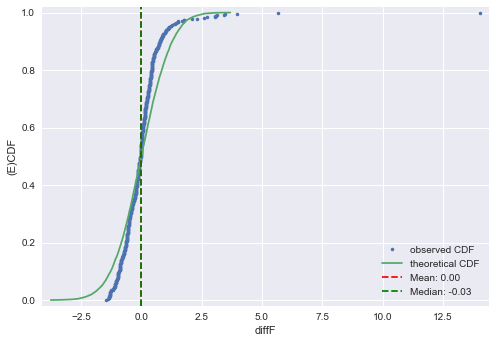

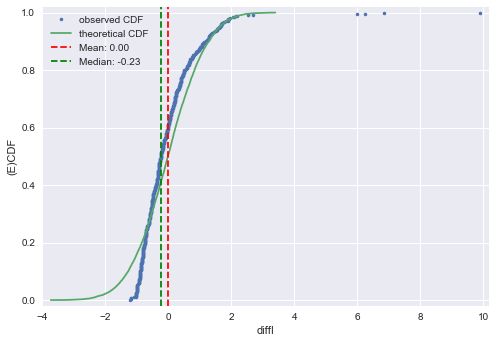

...

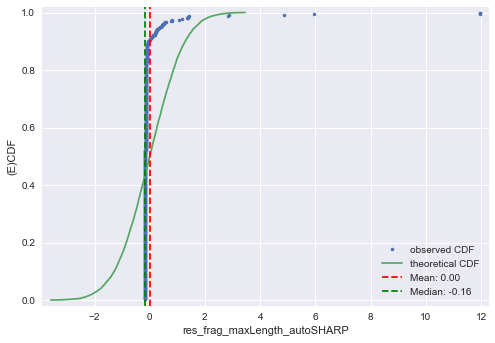

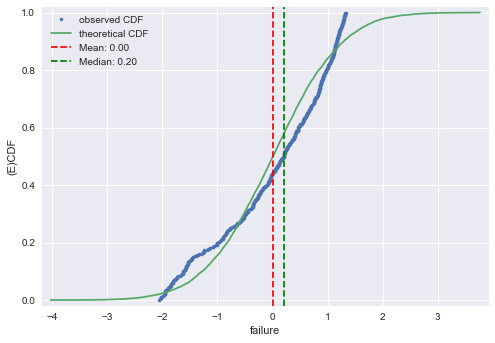

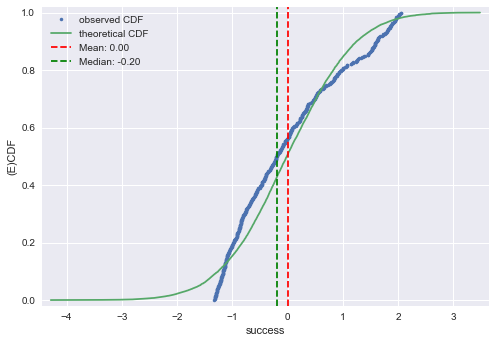

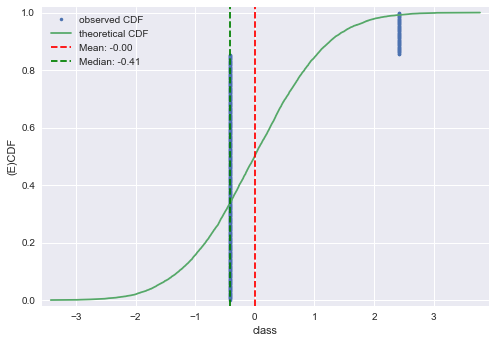

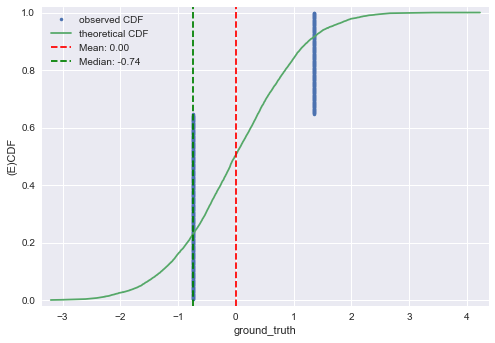

################################################################################
############################# unstandardised data ############################
################################################################################
######################### subsets of training data 3dii ########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


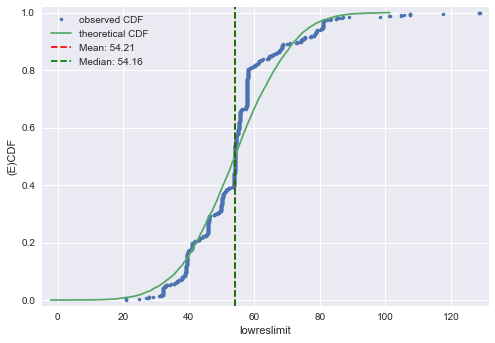

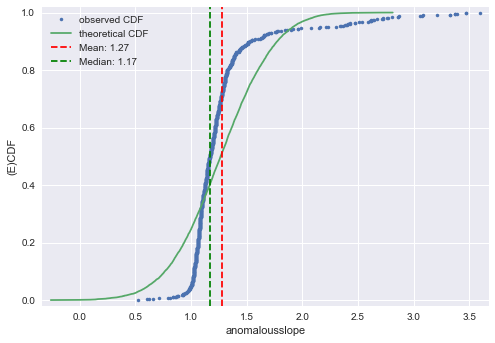

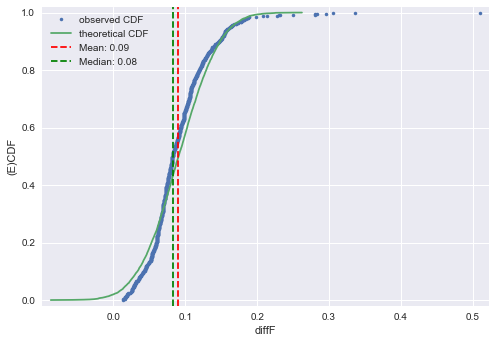

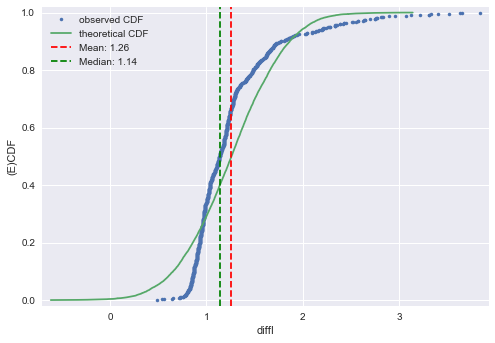

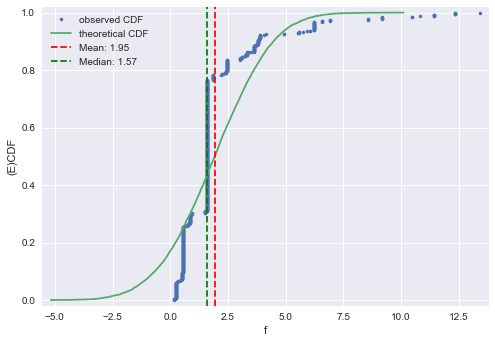

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


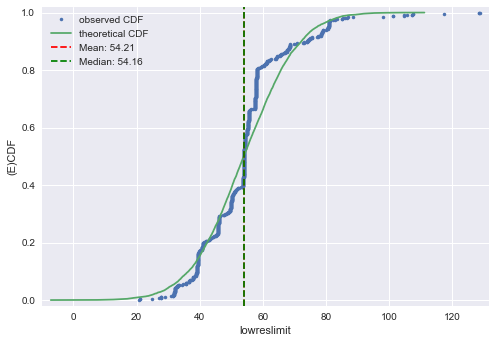

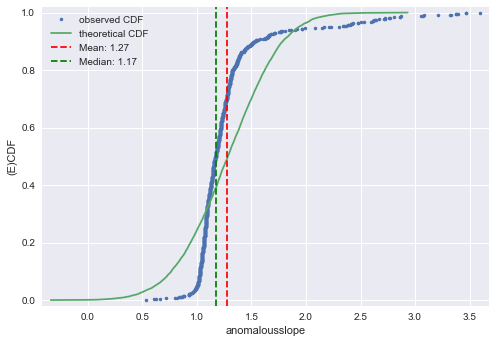

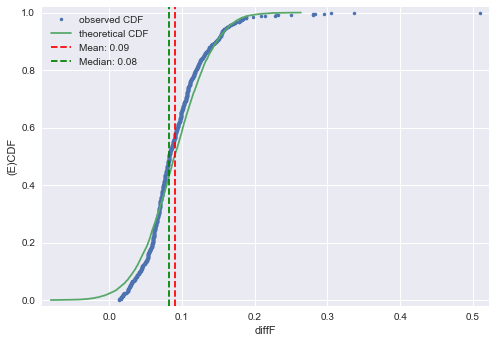

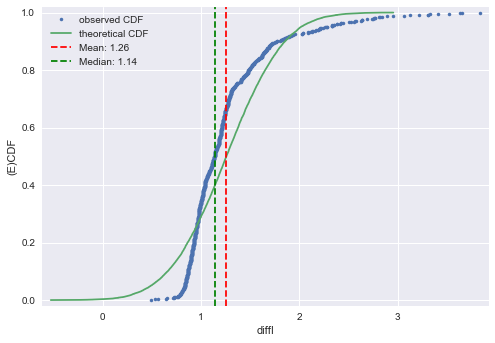

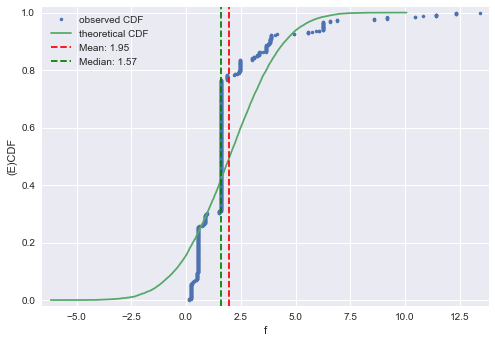

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


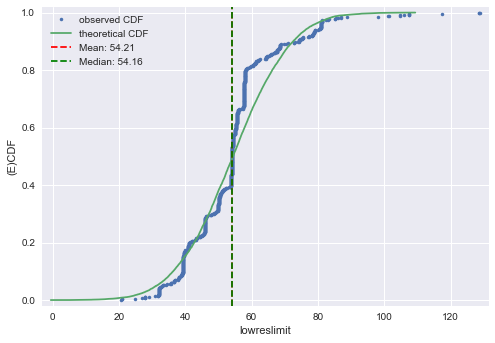

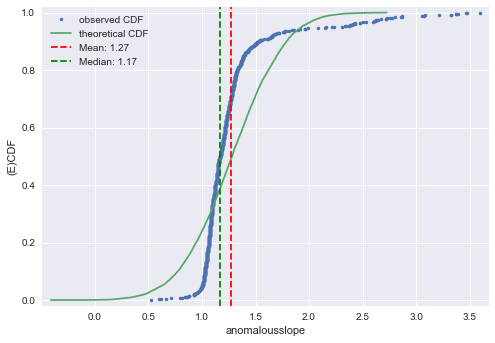

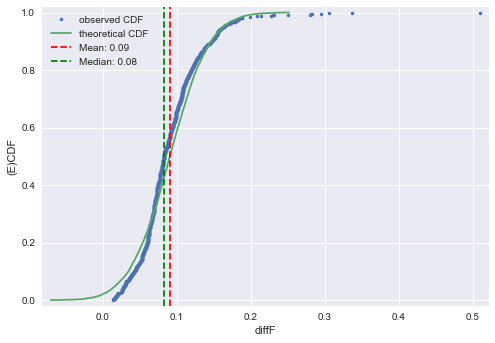

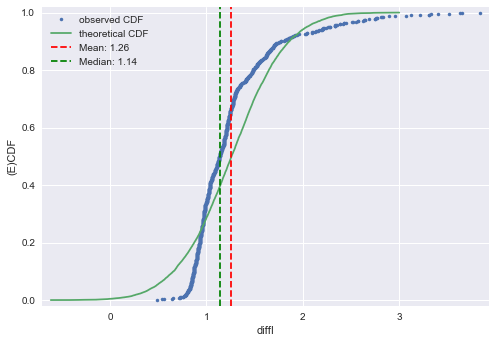

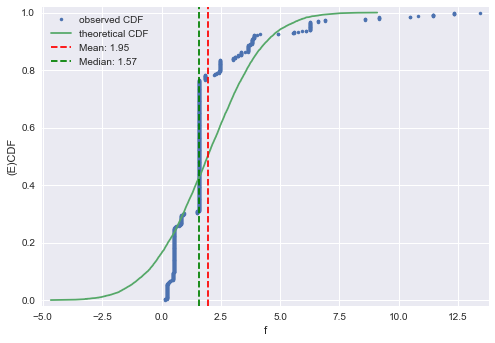

################################################################################
######################## subsets of training data DIALS ########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


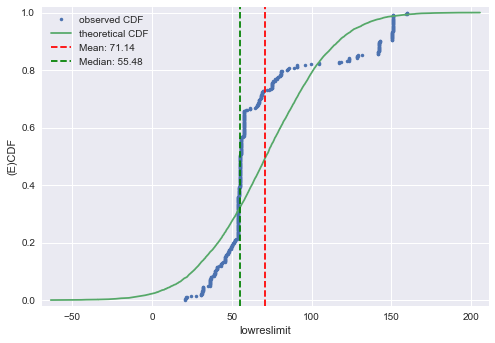

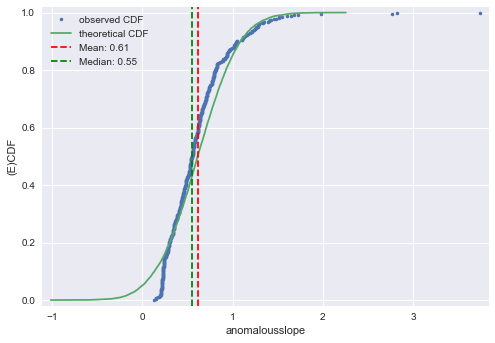

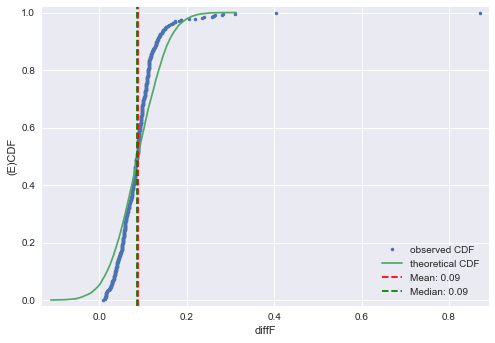

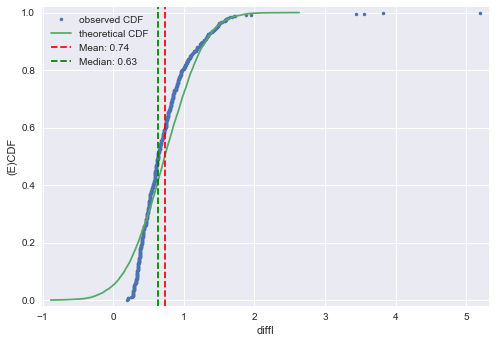

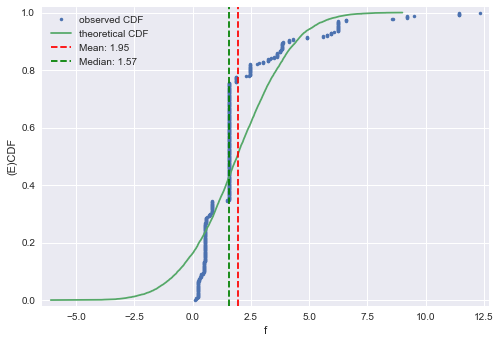

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


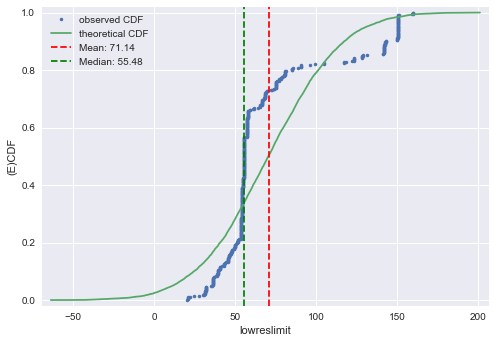

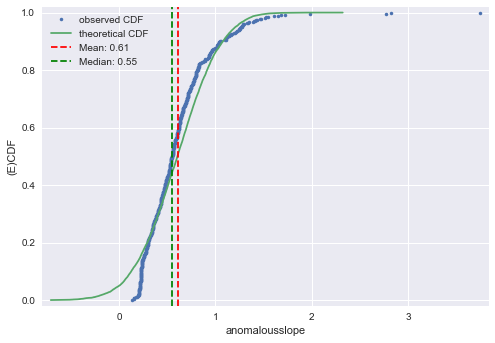

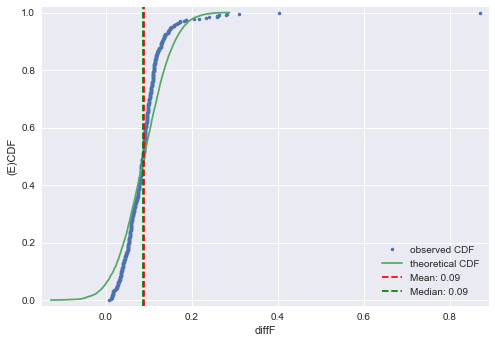

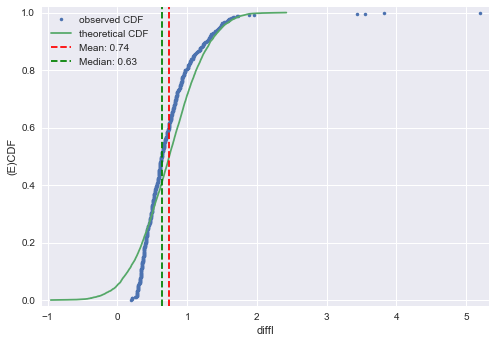

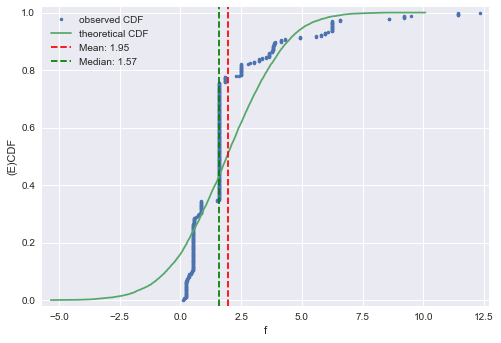

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


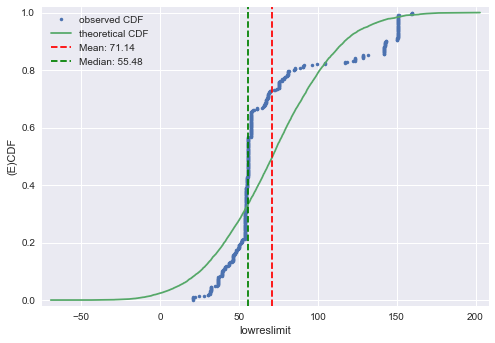

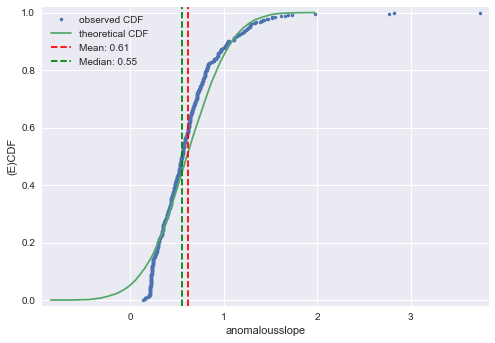

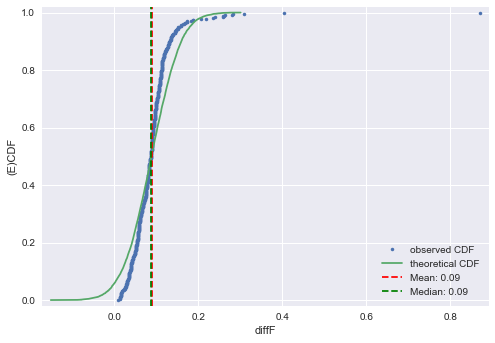

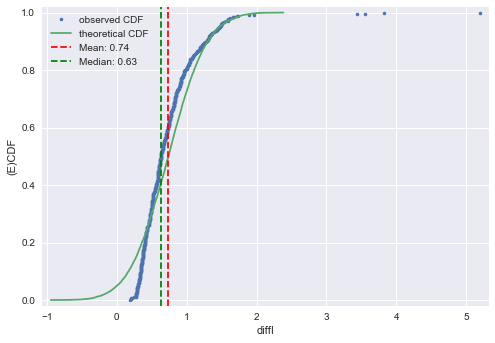

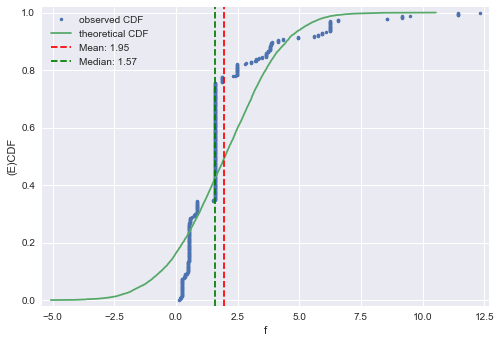

################################################################################
############################## standardised data #############################
################################################################################
######################### subsets of training data 3dii ########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


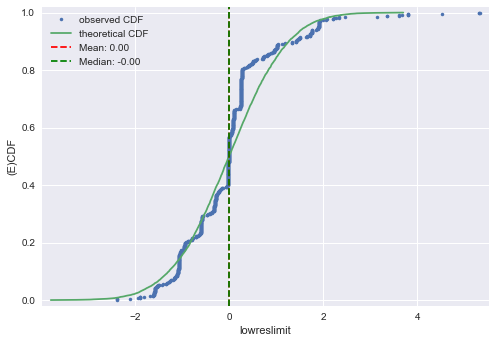

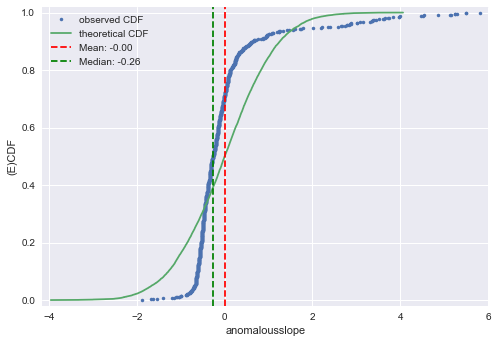

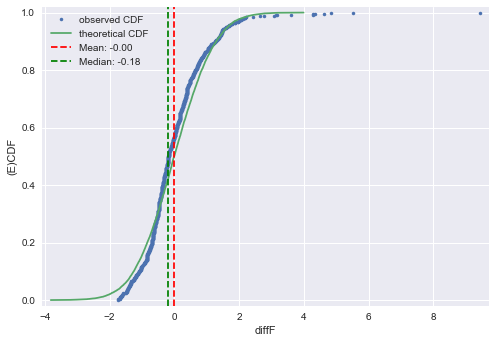

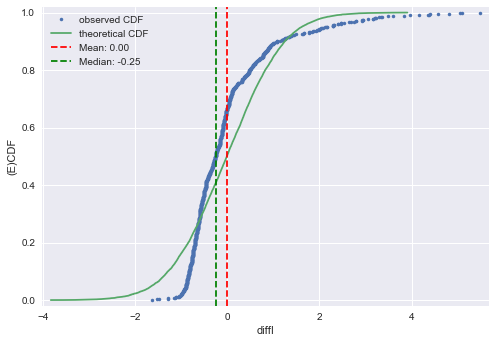

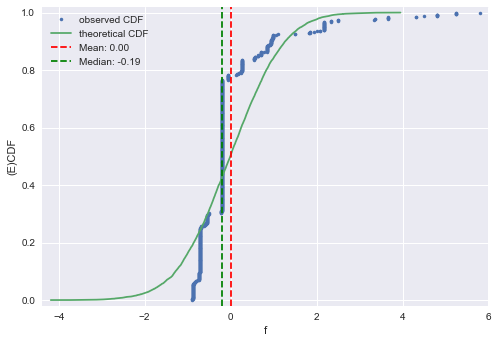

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


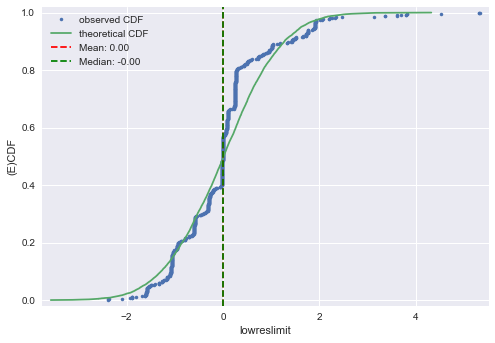

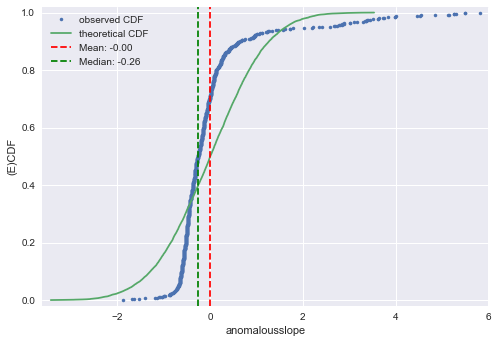

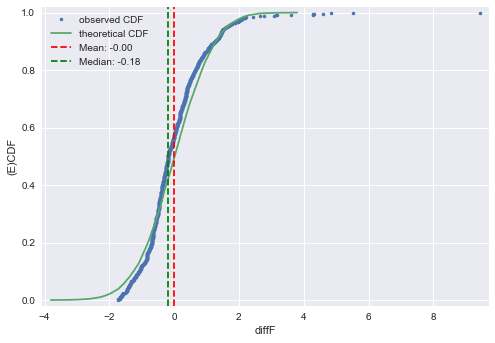

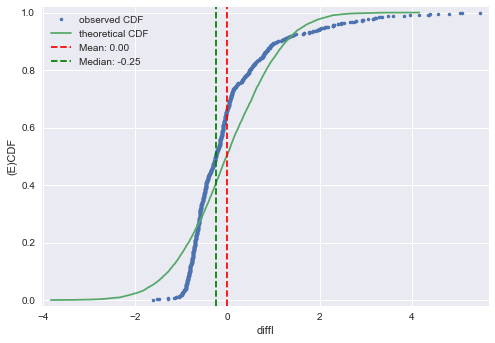

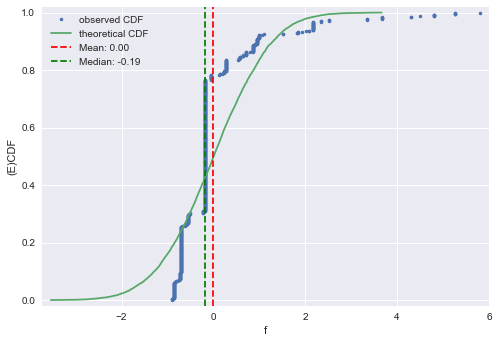

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


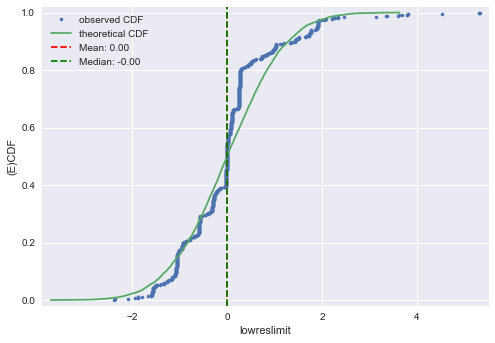

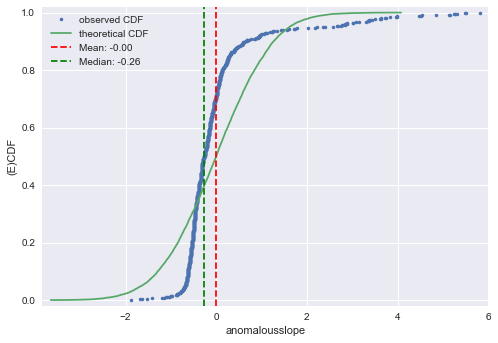

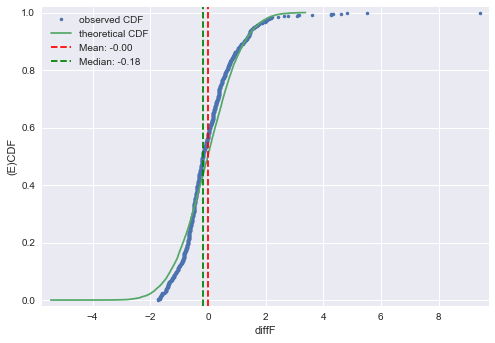

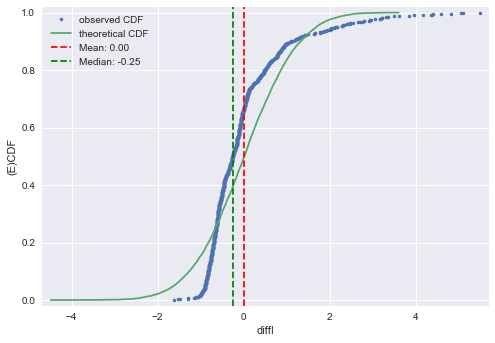

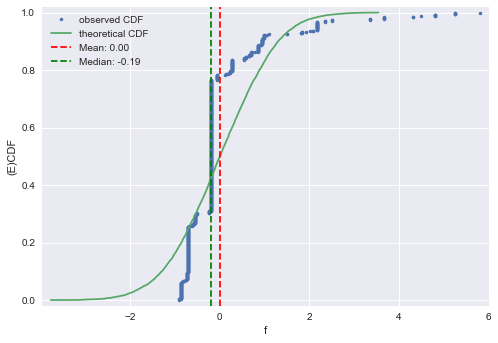

################################################################################
######################## subsets of training data DIALS ########################
################################################################################
********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


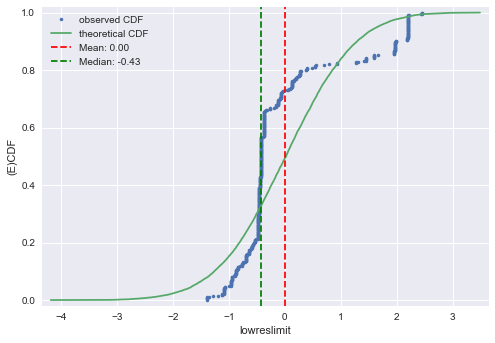

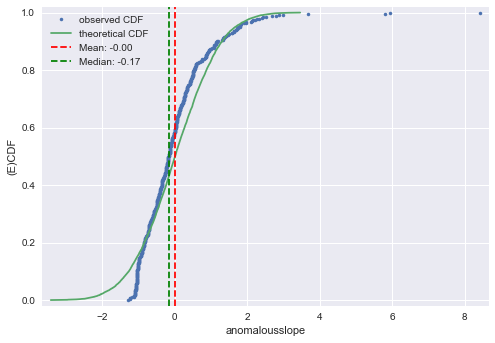

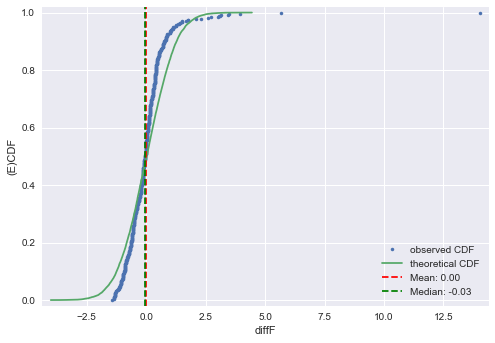

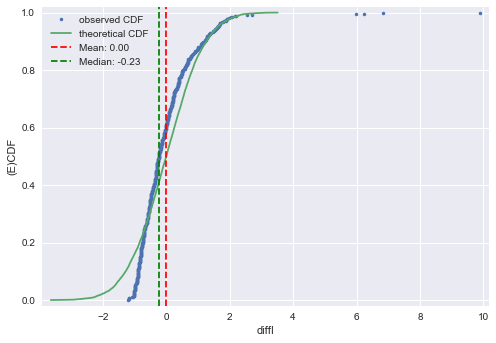

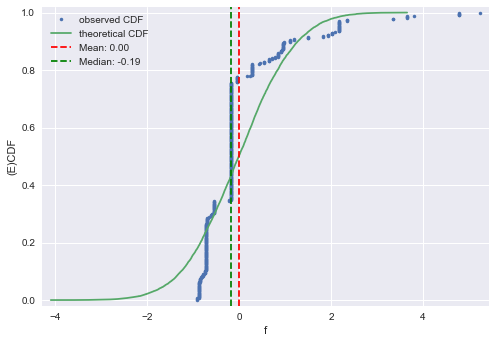

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


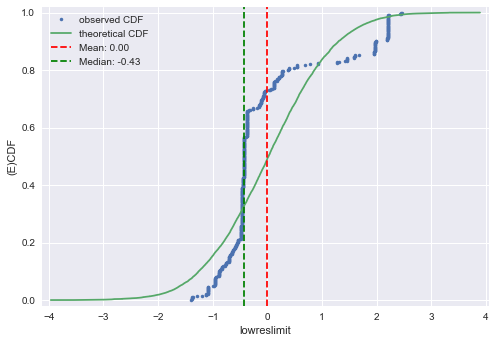

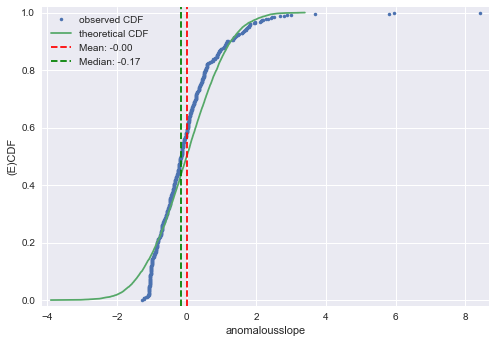

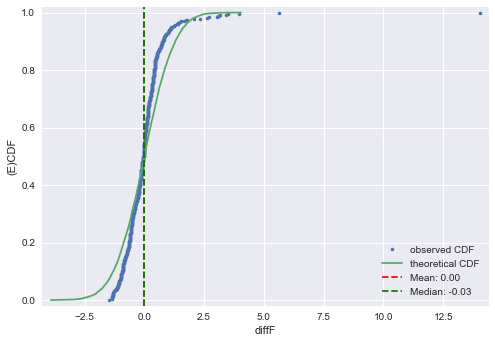

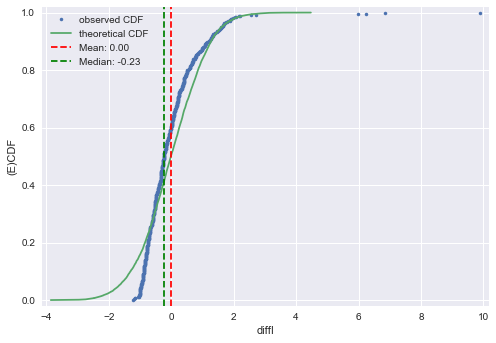

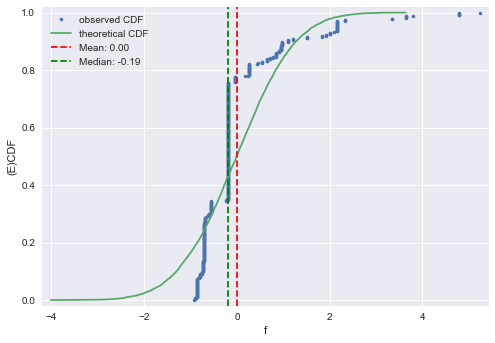

********************************************************************************
*    Plotting ECDF for each feature
********************************************************************************


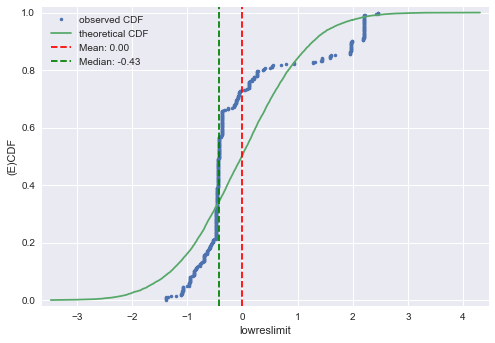

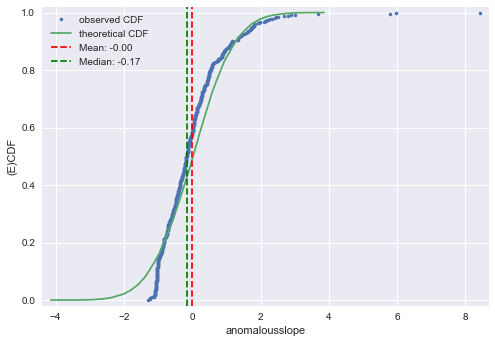

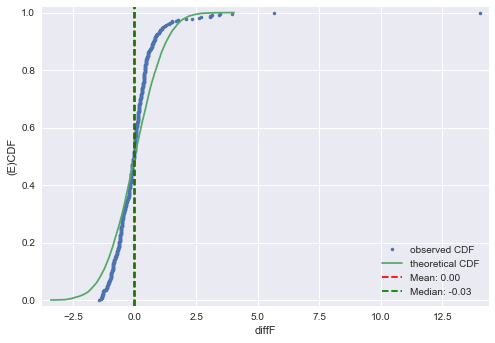

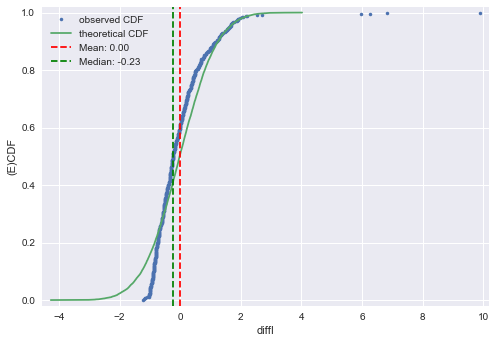

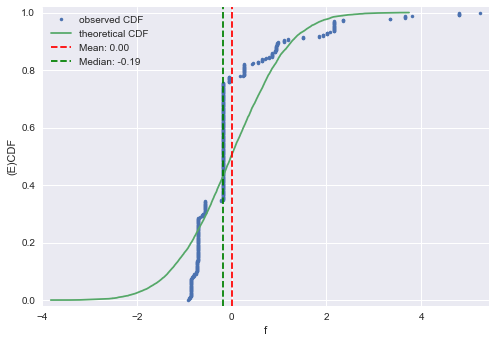

In [64]:
def plot_feature_ecdf(dataframe):
    '''Plot empirical cumulative distribution function (ECDF) for each feature.'''
    print('*' *80)
    print('*    Plotting ECDF for each feature')
    print('*' *80)

    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    itter = dataframe.columns
    
    for name in itter[1:]:
        '''Compute ECDF for a one-dimensional array of measurements'''

        #Number of data points:n
        n = len(dataframe[name])
        #x-data for the ECDF:x
        x = np.sort(dataframe[name])
        #y-data for the ECDF;y
        y = np.arange(1, n+1)/n
        mean = np.mean(dataframe[name])
        median = np.median(dataframe[name])
        
        mean_label = "Mean: %.2f" %mean
        median_label = "Median: %.2f" %median

        std = np.std(dataframe[name])
        samples = np.random.normal(mean, std, size=10000)
        n_theor = len(samples)
        x_theor = np.sort(samples)
        y_theor = np.arange(1, n_theor+1)/n_theor

        plt.plot(x, y, marker='.', linestyle='none', label='observed CDF')
        plt.plot(x_theor, y_theor, label='theoretical CDF')
        plt.axvline(mean, label=mean_label, color='r', linestyle='--')
        plt.axvline(median, label=median_label, color='g', linestyle='--')
        plt.xlabel(name)
        plt.ylabel('(E)CDF')
        plt.margins(0.02)
        plt.legend(loc='best')
        plt.show()
        #plt.savefig(os.path.join(self.output_dir,
        #                   'ECDF_feature_'+name+'_'+datestring+'.png'), dpi=600)
        plt.close()

        
print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_ecdf(X_3dii_train)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
plot_feature_ecdf(X_dials_train)


print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_ecdf(X_3dii_train_std)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
plot_feature_ecdf(X_dials_train_std)


print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_X_3dii_train_df)
plot_feature_ecdf(crank2_X_3dii_train_df)
plot_feature_ecdf(autosharp_X_3dii_train_df)
print(80 * "#")
print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_X_dials_train_df)
plot_feature_ecdf(crank2_X_dials_train_df)
plot_feature_ecdf(autosharp_X_dials_train_df)
print(80 * "#")
print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_noPhase_X_3dii_train_df)
plot_feature_ecdf(crank2_noPhase_X_3dii_train_df)
plot_feature_ecdf(autosharp_noPhase_X_3dii_train_df)
print(80 * "#")
print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_noPhase_X_dials_train_df)
plot_feature_ecdf(crank2_noPhase_X_dials_train_df)
plot_feature_ecdf(autosharp_noPhase_X_dials_train_df)




print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_X_3dii_train_std_df)
plot_feature_ecdf(crank2_X_3dii_train_std_df)
plot_feature_ecdf(autosharp_X_3dii_train_std_df)
print(80 * "#")
print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_X_dials_train_std_df)
plot_feature_ecdf(crank2_X_dials_train_std_df)
plot_feature_ecdf(autosharp_X_dials_train_std_df)
print(80 * "#")
print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_noPhase_X_3dii_train_std_df)
plot_feature_ecdf(crank2_noPhase_X_3dii_train_std_df)
plot_feature_ecdf(autosharp_noPhase_X_3dii_train_std_df)
print(80 * "#")
print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
print(80 * "#")
plot_feature_ecdf(autobuild_noPhase_X_dials_train_std_df)
plot_feature_ecdf(crank2_noPhase_X_dials_train_std_df)
plot_feature_ecdf(autosharp_noPhase_X_dials_train_std_df)

################################################################################
############################# unstandardised data ############################
################################################################################
######################### subsets of training data with phasing results 3dii ########################
################################################################################
      anomalousCC  lowreslimit  anomalousslope    diffF    diffI         f  \
364       0.21259     55.50788         1.07108  0.11237  0.97740   2.47790   
371       0.49710     55.62809         1.01347  0.04157  0.92399   3.63405   
807       0.63819     57.91000         1.28575  0.09967  1.36307   1.57294   
926       0.26837     41.01219         1.12231  0.12078  1.03507   0.53265   
898       0.59658     28.94953         1.13920  0.09804  1.20998   6.58316   
638       0.62511     58.05000         1.28433  0.06746  1.48108   1.57294   
952       0.63506     48.57000

/Users/melanievollmar/anaconda/lib/python3.6/site-packages/scipy/stats/stats.py:3021: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den


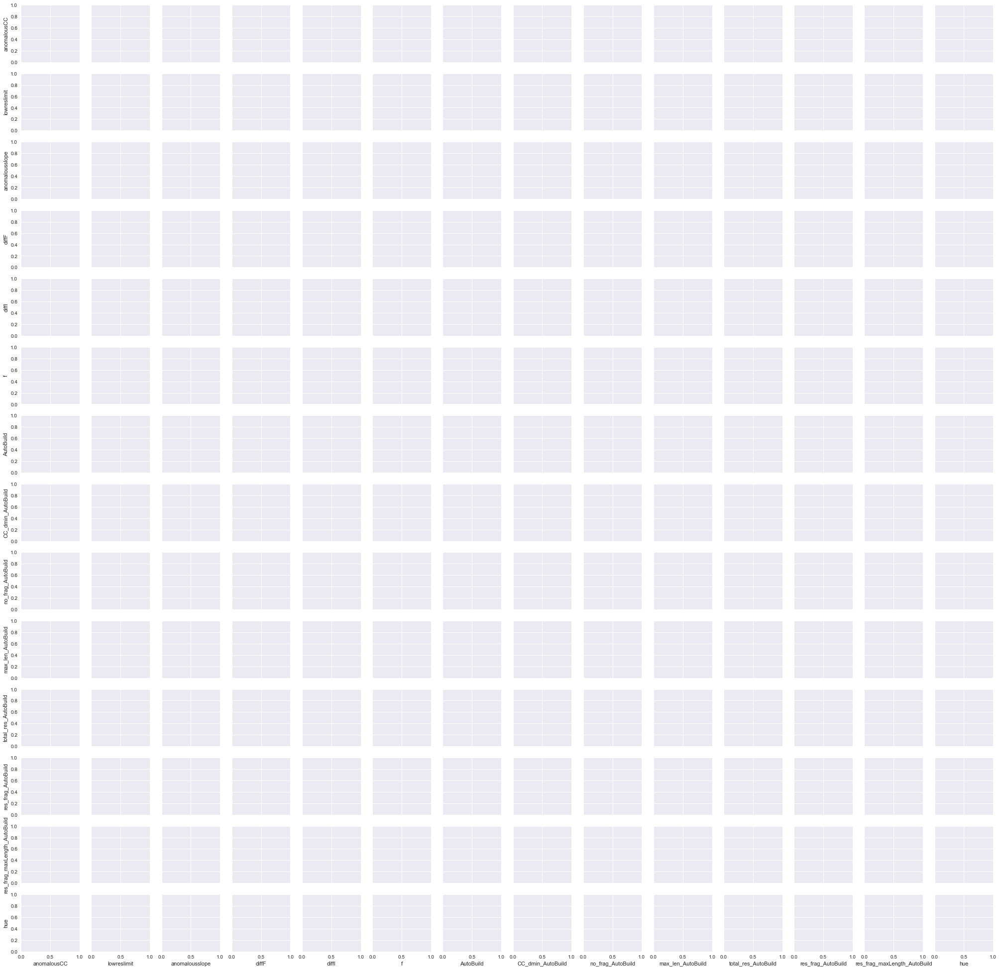

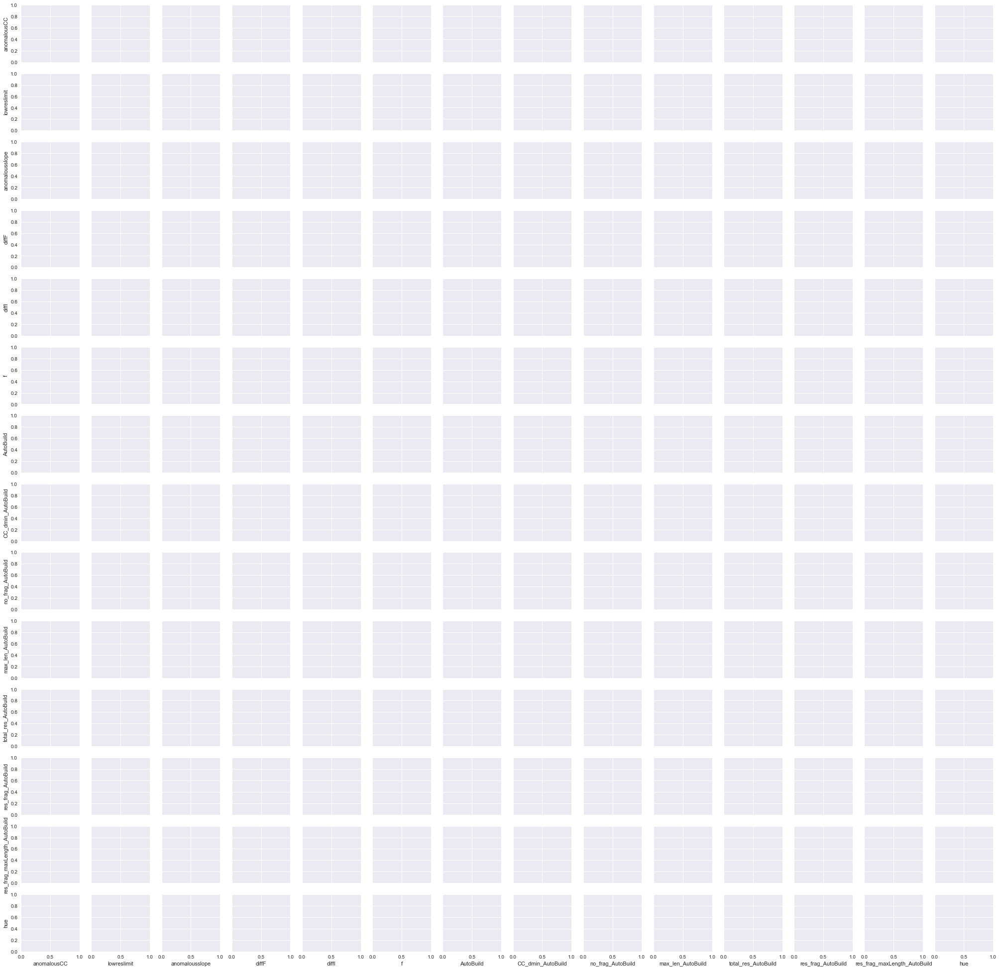

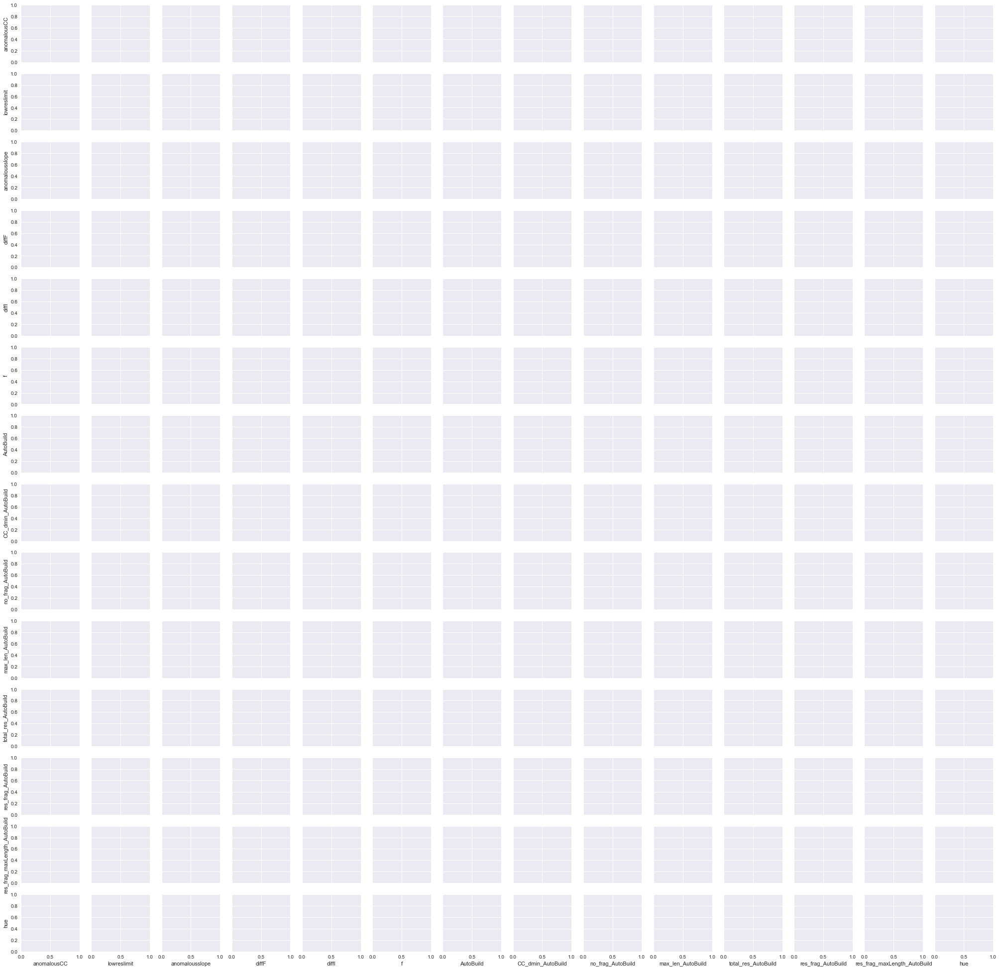

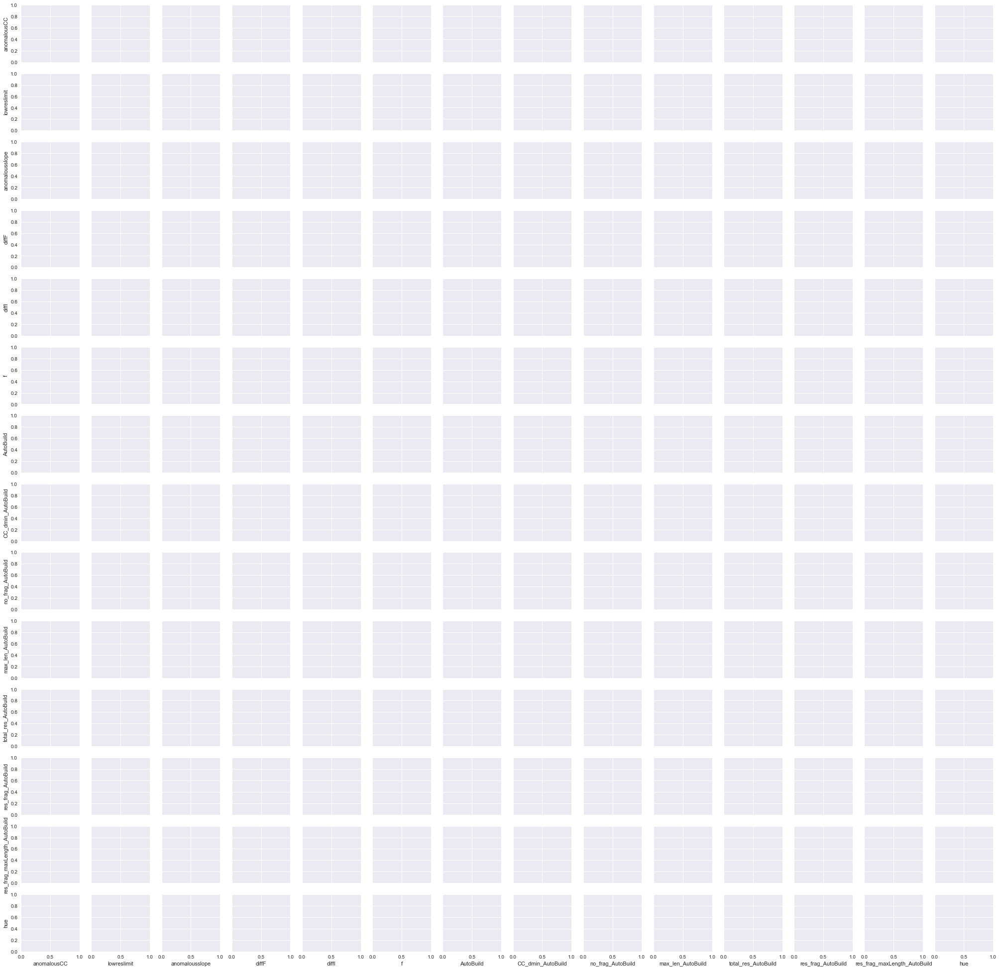

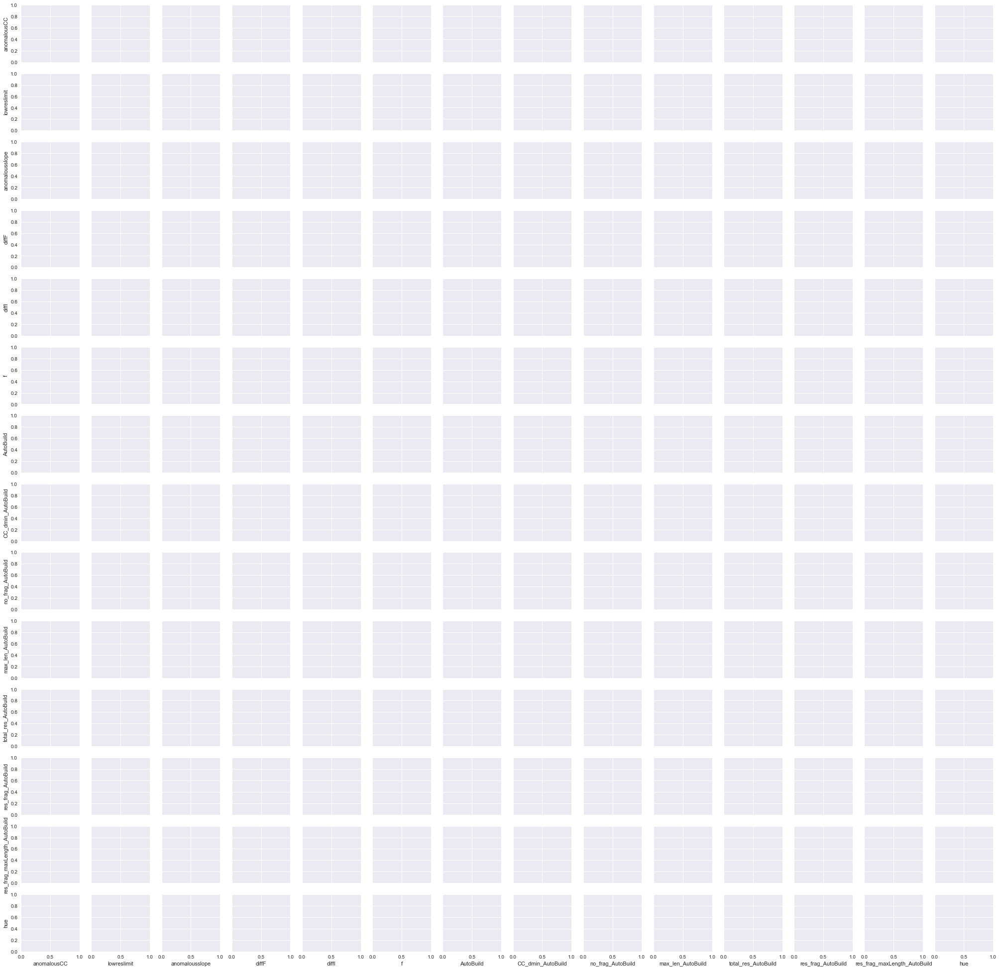

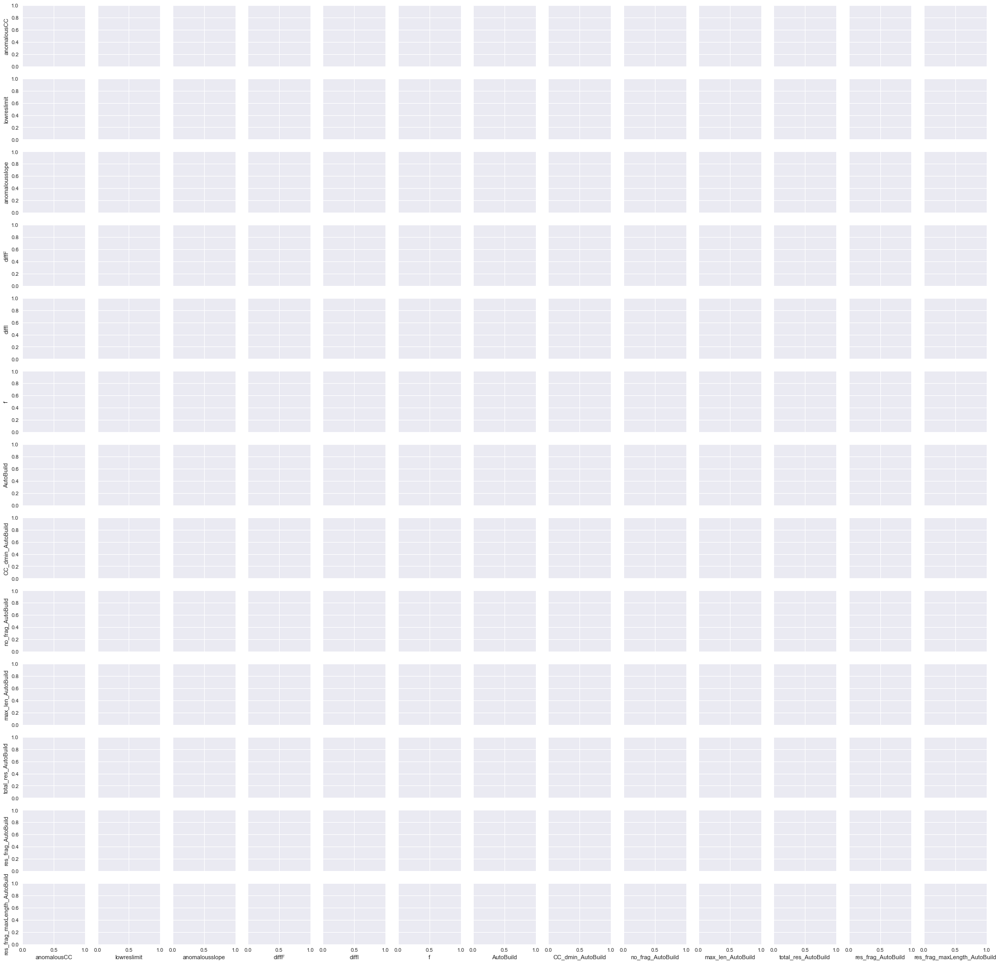

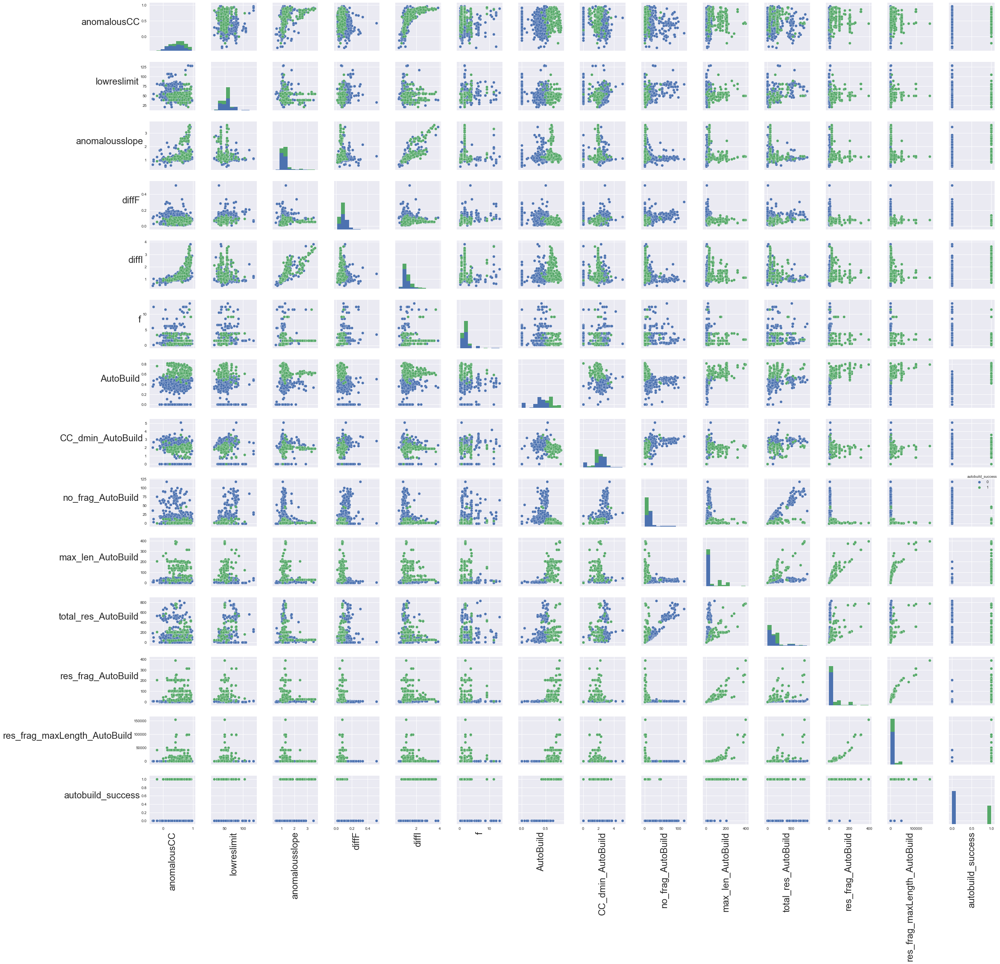

In [92]:
def plot_feature_pairs_small(dataframe, hue):

    print(dataframe)
    print(dataframe.columns)
    print(999999999999999999999999999999999999999999999999999)
    print(hue)
    print(hue.name)

    
    
#    df1 = df1.assign(e=pd.Series(np.random.randn(sLength)).values)
    
    dataframe_cp = dataframe.copy()    
    dataframe_cp.loc[:, hue.name] = pd.Series(hue, index=dataframe.index)
    
    print(dataframe.columns)
    print(dataframe_cp.columns)

    def corrfunc(x, y, **kws):
      (r, p) = pearsonr(x, y)

    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    #graph = sns.pairplot(self.best_features, hue='MR_success')
    #graph = sns.pairplot(dataframe, hue='ground_truth') #or
    graph = sns.pairplot(dataframe_cp, hue=dataframe_cp.columns[-1])
    #graph = sns.pairplot(dataframe, hue=(dataframe.columns == 'hue'))
    graph.map(corrfunc)
    #handles = graph._legend_data.values()
    #labels = graph._legend_data.keys()
    #graph.fig.legend(handles=handles, labels=labels, loc='upper center', ncol=1)
    graph.fig.subplots_adjust(top=0.92)
    for ax in graph.axes.flatten():
      # rotate x axis labels
      ax.set_xlabel(ax.get_xlabel(), rotation = 90, fontsize=24)
      # rotate y axis labels
      ax.set_ylabel(ax.get_ylabel(), rotation = 0, fontsize=24)
      # set y labels alignment
      ax.yaxis.get_label().set_horizontalalignment('right')
    plt.tight_layout()
#    plt.savefig(os.path.join(self.output_dir, 'pairplot_'+datestring+'.png'), dpi=300)
    plt.show()
    plt.close()

    
    
# TO DO: need to have different dataframe setup to make this work;
# need to have y labels within the dataframe; also can't use multi lable so will use
# the corresponding ones for the smaller dataframes and use ground_truth column for
# the full data; copy of the dataframes in a new variable
    

print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
print(80 * "#")
plot_feature_pairs_small(autobuild_X_3dii_train_df, y_3dii_train['autobuild_success'])
#plot_feature_pairs(crank2_X_3dii_train_df, y_3dii_train['crank2_success'])
#plot_feature_pairs(autosharp_X_3dii_train_df, y_3dii_train['autosharp_success'])
#print(80 * "#")
#print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_X_dials_train_df, y_dials_train['autobuild_success'])
#plot_feature_pairs(crank2_X_dials_train_df, y_dials_train['crank2_success'])
#plot_feature_pairs(autosharp_X_dials_train_df, y_dials_train['autosharp_success'])
#print(80 * "#")
#print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_noPhase_X_3dii_train_df, y_3dii_train['autobuild_success'])
#plot_feature_pairs(crank2_noPhase_X_3dii_train_df, y_3dii_train['crank2_success'])
#plot_feature_pairs(autosharp_noPhase_X_3dii_train_df, y_3dii_train['autosharp_success'])
#print(80 * "#")
#print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_noPhase_X_dials_train_df, y_dials_train['autobuild_success'])
#plot_feature_pairs(crank2_noPhase_X_dials_train_df, y_dials_train['crank2_success'])
#plot_feature_pairs(autosharp_noPhase_X_dials_train_df, y_dials_train['autosharp_success'])
#
#
#
#
#print(80 * "#")
#print(30 * "#" + " standardised data " + 29 * "#")
#print(80 * "#")
#print(25 * "#" + " subsets of training data with phasing results 3dii " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_X_3dii_train_std_df, y_3dii_train['autobuild_success'])
#plot_feature_pairs(crank2_X_3dii_train_std_df, y_3dii_train['crank2_success'])
#plot_feature_pairs(autosharp_X_3dii_train_std_df, y_3dii_train['autosharp_success'])
#print(80 * "#")
#print(24 * "#" + " subsets of training data with phasing results DIALS " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_X_dials_train_std_df, y_dials_train['autobuild_success'])
#plot_feature_pairs(crank2_X_dials_train_std_df, y_dials_train['crank2_success'])
#plot_feature_pairs(autosharp_X_dials_train_std_df, y_dials_train['autosharp_success'])
#print(80 * "#")
#print(25 * "#" + " subsets of training data without phasing results 3dii " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_noPhase_X_3dii_train_std_df, y_3dii_train['autobuild_success'])
#plot_feature_pairs(crank2_noPhase_X_3dii_train_std_df, y_3dii_train['crank2_success'])
#plot_feature_pairs(autosharp_noPhase_X_3dii_train_std_df, y_3dii_train['autosharp_success'])
#print(80 * "#")
#print(24 * "#" + " subsets of training data without phasing results DIALS " + 24 * "#")
#print(80 * "#")
#plot_feature_pairs(autobuild_noPhase_X_dials_train_std_df, y_dials_train['autobuild_success'])
#plot_feature_pairs(crank2_noPhase_X_dials_train_std_df, y_dials_train['crank2_success'])
#plot_feature_pairs(autosharp_noPhase_X_dials_train_std_df, y_dials_train['autosharp_success'])    
    


In [77]:
# NOTE: This code works the notebook just ran out of memory on my laptop;
# the following change to a config file is required:
# IOPub data rate exceeded.
# The notebook server will temporarily stop sending output
# to the client in order to avoid crashing it.
# To change this limit, set the config variable
# `--NotebookApp.iopub_data_rate_limit`.

# DO NOT RUN IN PRESENT STATE

def plot_feature_pairs_full(dataframe):

    def corrfunc(x, y, **kws):
      (r, p) = pearsonr(x, y)

    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    #graph = sns.pairplot(self.best_features, hue='MR_success')
    graph = sns.pairplot(dataframe, hue='ground_truth') #or
    #graph = sns.pairplot(dataframe, hue=dataframe.columns[-1])
    graph.map(corrfunc)
    #handles = graph._legend_data.values()
    #labels = graph._legend_data.keys()
    #graph.fig.legend(handles=handles, labels=labels, loc='upper center', ncol=1)
    graph.fig.subplots_adjust(top=0.92)
    for ax in graph.axes.flatten():
      # rotate x axis labels
      ax.set_xlabel(ax.get_xlabel(), rotation = 90, fontsize=24)
      # rotate y axis labels
      ax.set_ylabel(ax.get_ylabel(), rotation = 0, fontsize=24)
      # set y labels alignment
      ax.yaxis.get_label().set_horizontalalignment('right')
    plt.tight_layout()
#    plt.savefig(os.path.join(self.output_dir, 'pairplot_'+datestring+'.png'), dpi=300)
    plt.show()
    plt.close()

print(80 * "#")
print(29 * "#" + " unstandardised data " + 28 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
plot_feature_pairs_full(X_3dii_train)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
#plot_feature_pairs_full(X_dials_train)


print(80 * "#")
print(30 * "#" + " standardised data " + 29 * "#")
print(80 * "#")
print(28 * "#" + " full training data 3dii " + 27 * "#")
print(80 * "#")
#plot_feature_pairs_full(X_3dii_train_std)
print(80 * "#")
print(27 * "#" + " full training data DIALS " + 27 * "#")
print(80 * "#")
#plot_feature_pairs_full(X_dials_train_std)

################################################################################
############################# unstandardised data ############################
################################################################################
############################ full training data 3dii ###########################
################################################################################


/Users/melanievollmar/anaconda/lib/python3.6/site-packages/scipy/stats/stats.py:3021: RuntimeWarning: invalid value encountered in double_scalars
  r = r_num / r_den
IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


################################################################################
########################### full training data DIALS ###########################
################################################################################
################################################################################
############################## standardised data #############################
################################################################################
############################ full training data 3dii ###########################
################################################################################
################################################################################
########################### full training data DIALS ###########################
################################################################################


********************************************************************************
*    Plotting Confusion Matrix for Correlation Coefficients between Features
********************************************************************************


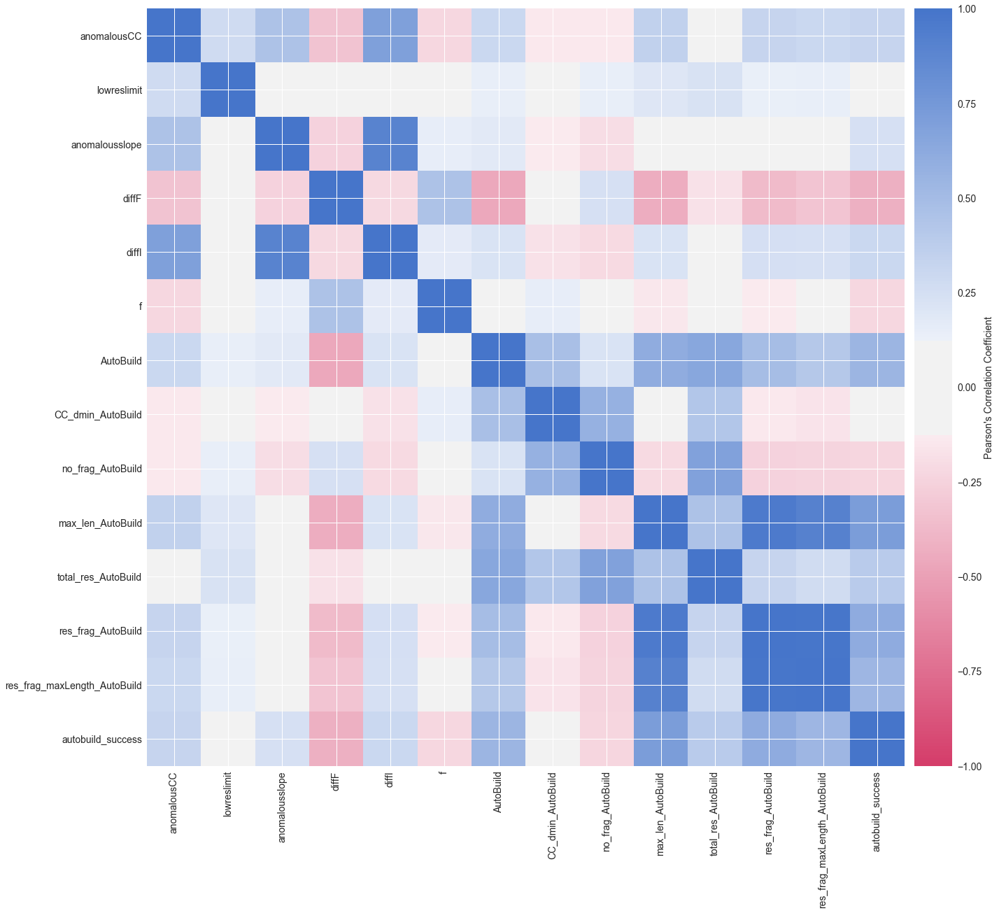

********************************************************************************
*    Plotting Confusion Matrix for Correlation Coefficients between Features
********************************************************************************


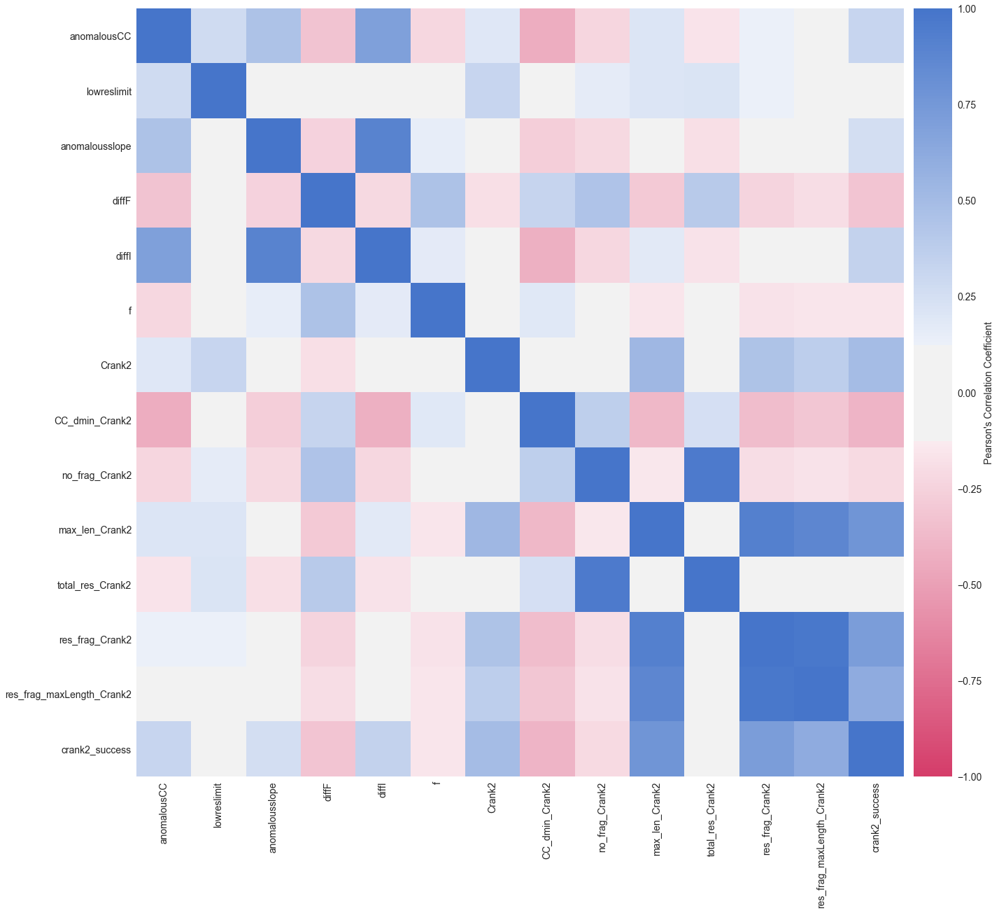

********************************************************************************
*    Plotting Confusion Matrix for Correlation Coefficients between Features
********************************************************************************


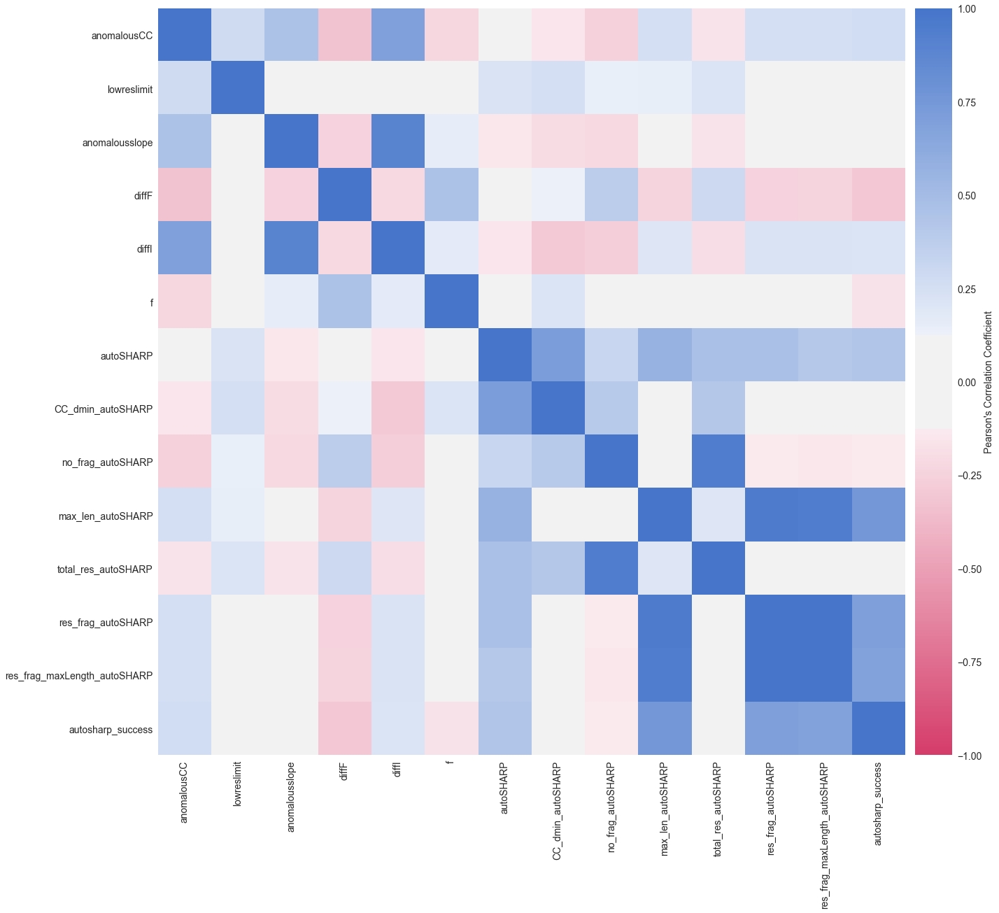

In [22]:
def plot_feature_correlation(dataframe):
    print('*' *80)
    print('*    Plotting Confusion Matrix for Correlation Coefficients between Features')
    print('*' *80)          
    
    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    corr = dataframe.corr()
    fig = plt.figure(figsize=(20, 20))
    ax = plt.gca()
#    im = ax.imshow(corr, cmap=sns.diverging_palette(0, 255, sep=32, n=256,
#                center='light', as_cmap=True), vmin=-1, vmax=1)
    im = ax.imshow(corr, cmap=sns.diverging_palette(0, 255, sep=32, n=256,
                center='light', as_cmap=True), vmin=-1, vmax=1)

      
    divider = make_axes_locatable(ax)
    cax = divider.append_axes('right', size='5%', pad=0.2)
    cax.tick_params(labelsize=14)
    plt.colorbar(im, cax=cax).set_label("Pearson's Correlation Coefficient",
                                        fontsize=14)
    #ax.set_xticks(np.arange(len(xticklabels)))
    ax.set_xticks(np.arange(len(dataframe.columns)))
    #ax.set_xticklabels(xticklabels, rotation=90, fontsize=14)
    ax.set_xticklabels(dataframe.columns, rotation=90, fontsize=14)      
    #ax.set_yticks(np.arange(len(yticklabels)))
    ax.set_yticks(np.arange(len(dataframe.columns)))
    #ax.set_yticklabels(yticklabels, fontsize=14)
    ax.set_yticklabels(dataframe.columns, fontsize=14)
    #fig.suptitle("Linear Pearson's Correlation Coefficient", fontsize=16)
    #ax.set_title('Feature1 using Data2', fontsize=12)
    plt.rcParams["axes.grid"] = False
    plt.tight_layout()
    plt.show()  
    #plt.savefig(os.path.join(directory,
    #              'feature_corr_matrix_'+datestring+'.png'), dpi=600)
    plt.close()

    
plot_feature_correlation(autobuild_df)
plot_feature_correlation(crank2_df)
plot_feature_correlation(autosharp_df)

********************************************************************************
*    Plotting cumulative explained variance
********************************************************************************
Explained variance ratio:  [ 0.32573151  0.20582085  0.14767377  0.10083671  0.07996229  0.05115339
  0.03658468  0.02196125  0.01750854  0.00812173  0.0030672   0.00110072
  0.00047738]


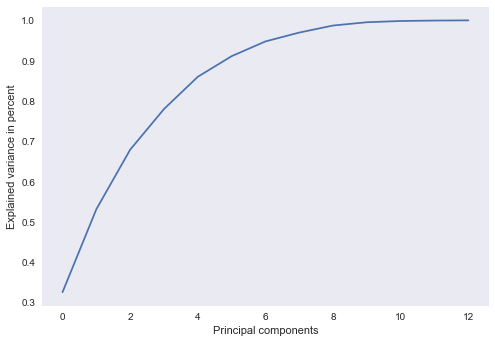

********************************************************************************
*    Running PCA to get 95% coverage
********************************************************************************
PCs necessary to get 95% coverage:  [ 0.32573151  0.20582085  0.14767377  0.10083671  0.07996229  0.05115339
  0.03658468  0.02196125]
Maximum number of PCs 8
********************************************************************************
*    Analysis for number of PCs necessary to get 95% coverage
********************************************************************************
PCA components:  [[  2.93395253e-01   1.27436709e-01   1.70841957e-01  -2.91303436e-01
    2.44118885e-01  -1.05832690e-01   3.34742304e-01  -2.68568163e-02
   -8.46392056e-02   4.43849390e-01   2.10278231e-01   4.29002169e-01
    4.09438989e-01]
 [  1.87038830e-01  -1.09622530e-01   3.18438361e-01  -4.00266692e-02
    3.23290568e-01   9.21423054e-03  -2.92644194e-01  -4.41202783e-01
   -4.79031239e-01  -7.63990425

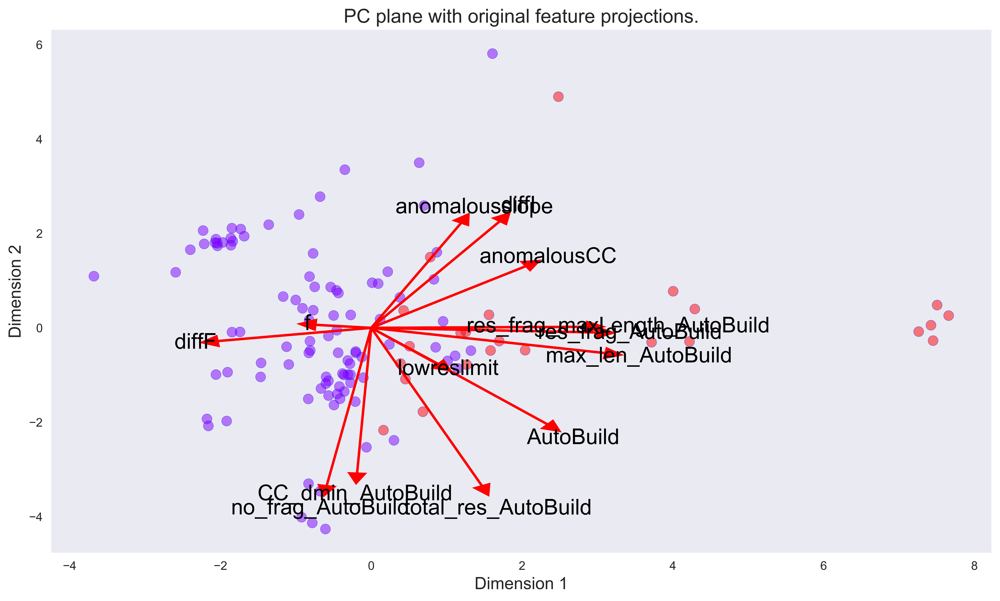

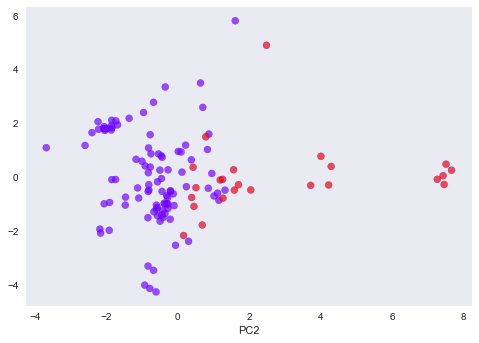

********************************************************************************
*    Plotting cumulative explained variance
********************************************************************************
Explained variance ratio:  [ 0.30714376  0.20327694  0.14419267  0.10079208  0.08756195  0.05721682
  0.03932027  0.03007703  0.01910522  0.00725086  0.00223882  0.0011735
  0.00065009]


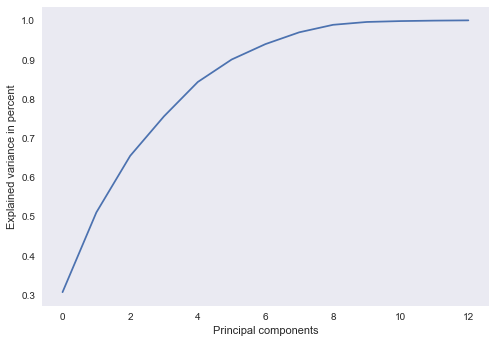

********************************************************************************
*    Running PCA to get 95% coverage
********************************************************************************
PCs necessary to get 95% coverage:  [ 0.30714376  0.20327694  0.14419267  0.10079208  0.08756195  0.05721682
  0.03932027  0.03007703]
Maximum number of PCs 8
********************************************************************************
*    Analysis for number of PCs necessary to get 95% coverage
********************************************************************************
PCA components:  [[ 0.28757153  0.09188504  0.22505958 -0.29405152  0.27146923 -0.12726841
   0.22739159 -0.31174382 -0.26643043  0.39294758 -0.17298587  0.3877167
   0.3568142 ]
 [-0.23637834  0.16299702 -0.3431784   0.13688844 -0.33780502 -0.054127
   0.23603727  0.14620314  0.3010109   0.33693658  0.3731224   0.34190142
   0.35590132]
 [ 0.28951208  0.29544294  0.37273551  0.20831936  0.42625715  0.27417599
   0

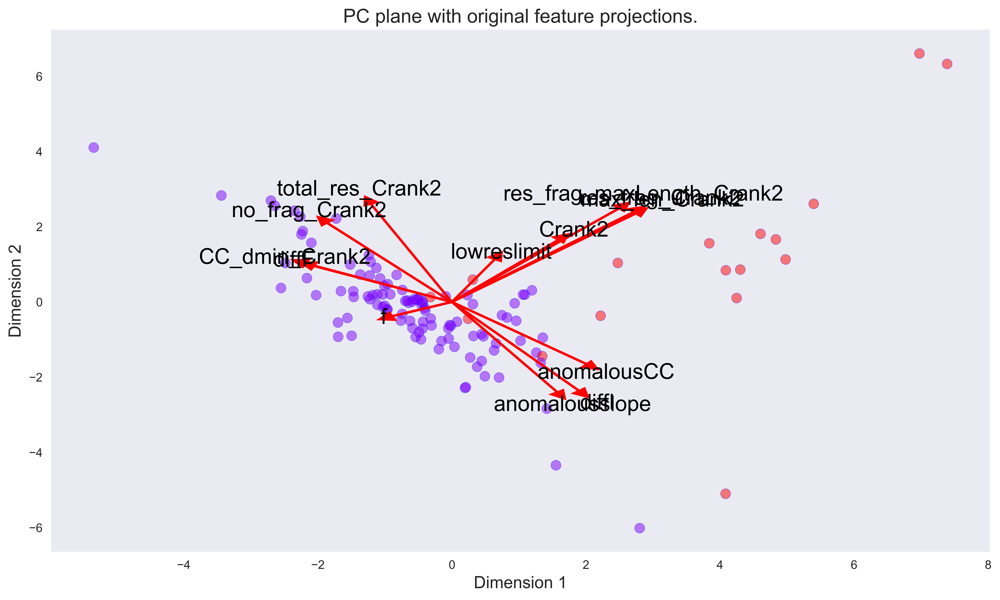

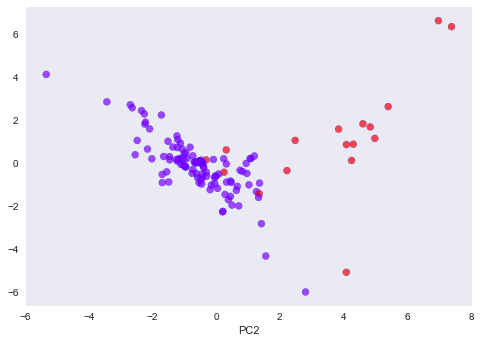

********************************************************************************
*    Plotting cumulative explained variance
********************************************************************************
Explained variance ratio:  [  2.82695646e-01   2.52507885e-01   1.38521834e-01   1.05360274e-01
   8.12888379e-02   6.33532842e-02   3.95273357e-02   1.92328237e-02
   9.27676040e-03   4.25726778e-03   2.60080483e-03   1.32454180e-03
   5.27037698e-05]


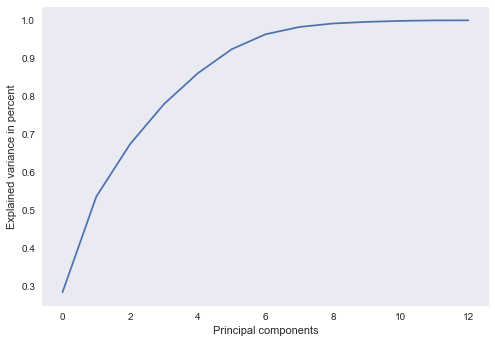

********************************************************************************
*    Running PCA to get 95% coverage
********************************************************************************
PCs necessary to get 95% coverage:  [ 0.28269565  0.25250789  0.13852183  0.10536027  0.08128884  0.06335328
  0.03952734]
Maximum number of PCs 7
********************************************************************************
*    Analysis for number of PCs necessary to get 95% coverage
********************************************************************************
PCA components:  [[ 0.31851123  0.09517233  0.226902   -0.26626431  0.31123297 -0.077662
   0.15893198 -0.1043768  -0.19195759  0.43207285 -0.07810652  0.44762196
   0.44503897]
 [-0.15896009  0.15189226 -0.24929251  0.13613035 -0.24505728  0.08646566
   0.4391502   0.36632283  0.37918294  0.25713873  0.43427538  0.20644725
   0.1878614 ]
 [ 0.27437008  0.20215752  0.49074497  0.17704709  0.47697079  0.37438527
   0.04453549  

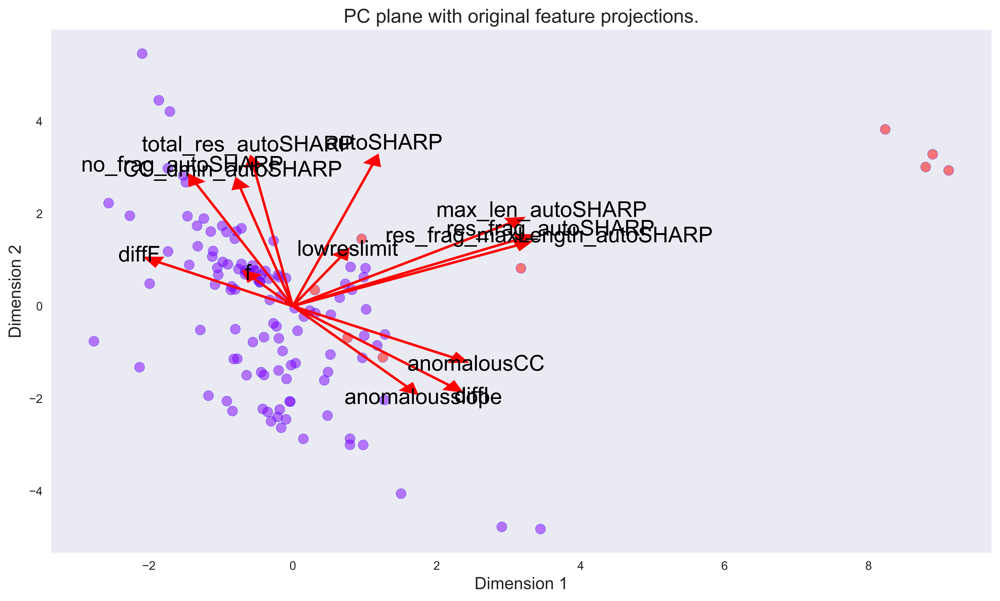

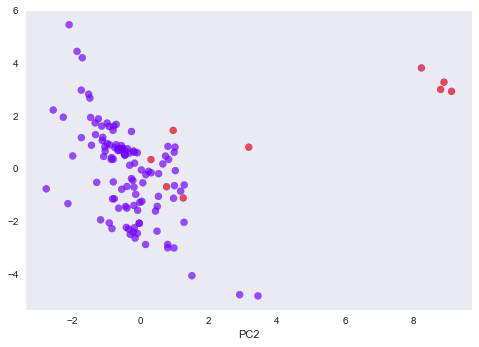

In [23]:
def explore_PCA(dataframe):#need to change to X and y for input
    features = dataframe.columns[:-1]
    solution = dataframe.columns[-1]
    
    # Get X and y
    X = dataframe.loc[:, features].values
    y = dataframe.loc[:, solution].values
    X_std = StandardScaler().fit_transform(X)

    # Look at all features and all possible PCs
    pca_get_components_all = PCA()
    dataframe_std_all = pca_get_components_all.fit_transform(X_std)


    print('*' *80)
    print('*    Plotting cumulative explained variance')
    print('*' *80)

    exp_var_ratio_allPCs = pca_get_components_all.explained_variance_ratio_
    print('Explained variance ratio: ', exp_var_ratio_allPCs)
    
    PCs = ['PC-1','PC-2', 'PC-3', 'PC-4', 'PC-5', 'PC-6', 'PC-7', 'PC-8', 'PC-9', 'PC-10',
           'PC-11', 'PC-12', 'PC-13']
    y_pos = ['PC %s' %i for i in PCs]
    
    plt.plot(np.cumsum(exp_var_ratio_allPCs))
    plt.ylabel('Explained variance in percent')
    plt.xlabel('Principal components')
    plt.show()
    plt.close()
    
    print('*' *80)
    print('*    Running PCA to get 95% coverage')
    print('*' *80)

    #fit() just fits the data
    #fit_transform() fits the data and reduces the dimensions

    
    # Find the number of PCs necessary to explain 95% of the variance
    pca_get_components = PCA(n_components=0.95)
    dataframe_std_reduced = pca_get_components.fit_transform(X_std)
    
    coverage = pca_get_components.explained_variance_ratio_
    exp_var_ratio_reducedPCs = pca_get_components.explained_variance_ratio_
    max_num_pc = len(exp_var_ratio_reducedPCs)
    print('PCs necessary to get 95% coverage: ', coverage)
    print('Maximum number of PCs', max_num_pc)
    
    print('*' *80)
    print('*    Analysis for number of PCs necessary to get 95% coverage')
    print('*' *80)

    # Analysis using the PCs for 95% coverage
    pca_num_PC = PCA(n_components = max_num_pc)
    pca_num_PC.fit_transform(X_std)
    
    components = pca_num_PC.components_
    print('PCA components: ', components)
    
    exp_var = pca_num_PC.explained_variance_
    print('Explained variance: ', exp_var)
    
    exp_var_ratio = pca_num_PC.explained_variance_ratio_
    print('Explained variance ratio: ', exp_var_ratio)
    
    sing_val = pca_num_PC.singular_values_
    print('Singular values: ', sing_val)

    print('*' *80)
    print('*    Plotting PC1 and PC2')
    print('*' *80)   
    
    pca = PCA(n_components = max_num_pc)
    X_pca = pca.fit_transform(X_std, y)
    feature_vectors = pca.components_.T
    
    fig, ax = plt.subplots(figsize = (14,8), dpi=600)
    
    # scatterplot of the reduced data 
    ax.scatter(x=X_pca[:,0],
               y=X_pca[:,1],
               facecolors='b', edgecolors='b', s=70, alpha=0.5, c=y, cmap="rainbow")
    
    # using scaling factors to make the arrows
    arrow_size, text_pos = 7.0, 8.0,

    # projections of the original features
    for i, v in enumerate(feature_vectors):
        ax.arrow(0, 0, arrow_size*v[0], arrow_size*v[1], head_width=0.2,
                   head_length=0.2, linewidth=2, color='red')
        ax.text(v[0]*text_pos, v[1]*text_pos, dataframe.columns[i], color='black',
                  ha='center', va='center', fontsize=18)
    ax.set_xlabel("Dimension 1", fontsize=14)
    ax.set_ylabel("Dimension 2", fontsize=14)
    ax.set_title("PC plane with original feature projections.", fontsize=16)
    plt.show()
    plt.close()



    plt.xlabel("PC1")
    plt.xlabel("PC2")    
    plt.scatter(X_pca[:,0], X_pca[:,1], c=y, cmap="rainbow", alpha=0.7, edgecolors='b')
    plt.show()
    plt.close()
    

explore_PCA(autobuild_df)
explore_PCA(crank2_df)
explore_PCA(autosharp_df)

13


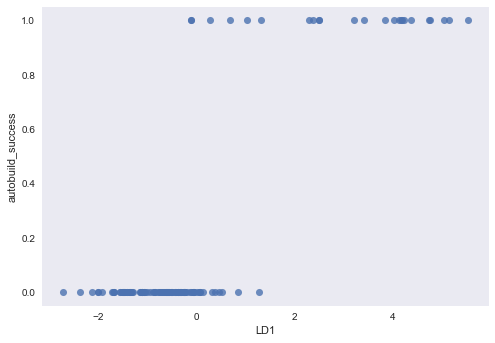

13


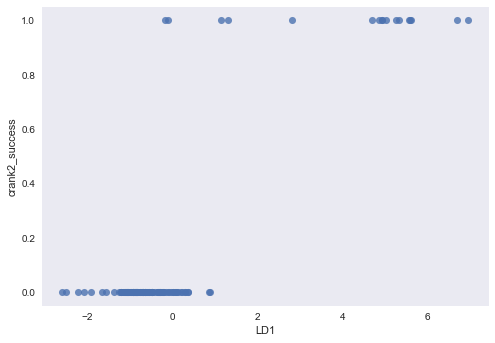

13


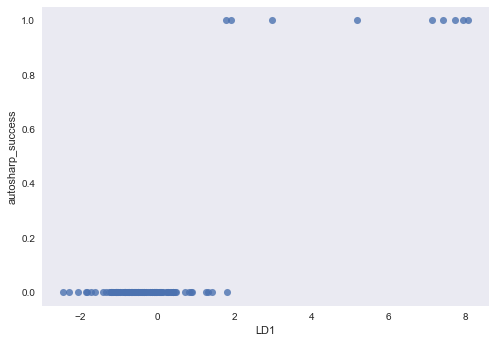

In [24]:
#got lots of "Index out of bounds" errors; turns out running LDA
#for a binary classification problem will always only generate a single LD
#can't do any scatter plots there --> set n_components=1

def explore_LDA(dataframe):
    features = dataframe.columns[:-1]
    print(len(features))
    solution = dataframe.columns[-1]
    
    # Get X and y
    X = dataframe.loc[:, features].values
    y = dataframe.loc[:, solution].values
    X_std = StandardScaler().fit_transform(X)
    
    
    # Create LDA
    lda=LinearDiscriminantAnalysis(n_components=1)
    X_r2 = lda.fit(X_std, y).transform(X_std)

    results_df = pd.DataFrame({'LD1': X_r2[:,0],
                               dataframe.columns[-1]: dataframe.loc[:, solution].values})
   
    sns.regplot(data=results_df,
                x="LD1", y=solution, fit_reg=False, scatter_kws={'s':50})
    plt.show()
    plt.close()
     
explore_LDA(autobuild_df)
explore_LDA(crank2_df)
explore_LDA(autosharp_df)

In [82]:
def explore_PCA(dataframe):
    datestring = datetime.strftime(datetime.now(), '%Y%m%d_%H%M')
    
    dataframe_std = StandardScaler().fit_transform(dataframe)

    print('*' *80)
    print('*    Running PCA to get 95% coverage')
    print('*' *80)

    #fit() just fits the data
    #fit_transform() fits the data and reduces the dimensions

    pca_get_components = PCA(n_components=0.95)#calculate the PCs to explain 95% of variance
    dataframe_std_reduced = pca_get_components.fit_transform(dataframe_std)
    
    coverage = pca_get_components.explained_variance_ratio_
    max_num_pc = len(pca_get_components.explained_variance_ratio_)
    print('PCs necessary to get 95% coverage: ', coverage)
    print('Maximum number of PCs', max_num_pc)
    #print(pca.singular_values_)

    print('*' *80)
    print('*    Analysis for number of PCs necessary to get 95% coverage')
    print('*' *80)

    pca_num_PC = PCA(n_components=max_num_pc)#for all PCs needed to get 95%
    pca_num_PC.fit_transform(dataframe_std)
    
    components = pca_num_PC.components_
    print('PCA components: ', components)
    
    exp_var = pca_num_PC.explained_variance_
    print('Explained variance: ', exp_var)
    
    exp_var_ratio = pca_num_PC.explained_variance_ratio_
    print('Explained variance ratio: ', exp_var_ratio)
    
    sing_val = pca_num_PC.singular_values_
    print('Singular values: ', sing_val)
    
    # Dimension indexing
    dimensions = ['Dimension {}'.format(i) for i in range(1,len(components)+ 1)]
    # PCA components
    components = pd.DataFrame(np.round(components, max_num_pc), columns = dataframe.columns) 
    components.index = dimensions
    
    # PCA explained variance
    ratios = pca_num_PC.explained_variance_ratio_.reshape(len(components), 1)
    variance_ratios = pd.DataFrame(np.round(ratios, max_num_pc), columns = ['Explained Variance'])
    variance_ratios.index = dimensions
    
    # Create a bar plot visualization
    fig, ax = plt.subplots(figsize = (14,8))

    # Plot the feature weights as a function of the components
    print('*' *80)
    print('*    Plotting feature weights for PCs necessary to get 95% coverage')
    print('*' *80)

    components.plot(ax = ax, kind = 'bar')
    ax.set_ylabel("Feature Weights") 
    ax.set_xticklabels(dimensions, rotation=90)
    plt.legend(loc='best')
    plt.tight_layout()
    plt.show()
    #plt.savefig(os.path.join(self.output_dir,
    #            'Feature_weights_per_PC_transform_'+datestring+'.png'))
    #plt.close()
        
    # Display the explained variance ratios# 
    for i, ev in enumerate(exp_var_ratio):
        print("Element: ", i)
        print("Explained variance: %.4f"%(ev))
        #ax.text(i-0.40, ax.get_ylim()[1] + 0.05, "Explained Variance\n %.4f"%(ev))


        
        
    print('*' *80)
    print('*    Plotting biplot for first two PCs')
    print('*' *80)

    pca_2D = PCA(n_components=2).fit(dataframe_std)
    pca_2D_std = pca_2D.transform(dataframe)
    #pca_samples = pca.transform(X_train_std)
    pca_2D_std = pd.DataFrame(pca_2D_std, columns = ['Dimension 1', 'Dimension 2'])

    fig, ax = plt.subplots(figsize = (14,8), dpi=600)
    
    # scatterplot of the reduced data 
    ax.scatter(x=pca_2D_std.loc[:, 'Dimension 1'],
               y=pca_2D_std.loc[:, 'Dimension 2'],
               facecolors='b', edgecolors='b', s=70, alpha=0.5)
    
    feature_vectors = pca_2D.components_.T

    # using scaling factors to make the arrows
    arrow_size, text_pos = 7.0, 8.0,

    # projections of the original features
    for i, v in enumerate(feature_vectors):
        ax.arrow(0, 0, arrow_size*v[0], arrow_size*v[1], head_width=0.2,
                 head_length=0.2, linewidth=2, color='red')
        ax.text(v[0]*text_pos, v[1]*text_pos, dataframe.columns[i], color='black',
                  ha='center', va='center', fontsize=18)

        ax.set_xlabel("Dimension 1", fontsize=14)
        ax.set_ylabel("Dimension 2", fontsize=14)
        ax.set_title("PC plane with original feature projections.", fontsize=16)
        plt.show()
        #plt.savefig(os.path.join(self.output_dir,
        #            'PC_biplot_PC1_PC2_transform_'+datestring+'.png'))
        plt.close()

        
        
    # Return a concatenated DataFrame
    #return pd.concat([variance_ratios, components], axis = 1)



    
    